In [1]:
import json
import pickle
import bz2
import os
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms
from torchvision.transforms import InterpolationMode
from skimage.transform import resize
from skimage.color import rgb2gray

In [2]:
videos_dir = '/Users/hragnarsd/.heart_echo/0.5_backup'
segm_label_dir = '../segmented_results'

In [3]:
def get_data(videos_dir, video_name, view='psax'):
    segment_mask_file = video_name + '-frames.segment_pbz2'
    label_file = video_name + '-segmentation_label.json'
    segment_mask_path = os.path.join(segm_label_dir, video_name, view, segment_mask_file)
    label_path = os.path.join(segm_label_dir, video_name, view, label_file)
    video_path = os.path.join(videos_dir, video_name + '.npy')
    with open(label_path, 'r') as file:
        labels = json.load(file)
    data = bz2.BZ2File(segment_mask_path, 'rb')
    segm_mask = np.asarray(pickle.load(data))
    video = np.load(video_path)
    return video, segm_mask, labels

In [4]:
def visualise(video, segm_mask, labels, max_frames=50, sampling_period=2):
    # plt.rcParams["figure.figsize"] =(15,12)
    plt.rcParams["figure.figsize"] =(20,15)
    w, h = segm_mask.shape[1:3]
    for i in range(0, max_frames, sampling_period):  # Just look at every 2nd frame, for first 100 frames (50 * 2)
        segm_mask_frame = segm_mask[i]
        print(f'--> Frame {i}:')
        lv_rv_cnt = 0
        total_cnt = 0
        for label in labels.keys():
            cnt_label = np.count_nonzero(segm_mask_frame == labels[label])
            total_cnt += cnt_label
            if label == 'lv' or label == 'rv':  # Try this!
                lv_rv_cnt += cnt_label
            print(f'\t{label}: cnt={cnt_label}, area_of_total={cnt_label / (w * h) * 100:.1f}%')
        print(f'\t ==> combined:  cnt={total_cnt}, area_of_total={total_cnt / (w * h) * 100:.1f}%')
        print(f'\t ==> lv+rv:  cnt={total_cnt}, area_of_total={lv_rv_cnt / (w * h) * 100:.1f}%')
        orign_video_frame = video[i]
        segm_mask_frame = segm_mask_frame.astype(np.float32)
        segm_mask_frame[segm_mask_frame == 0] = np.nan
        segm_mask_frame = resize(segm_mask_frame, orign_video_frame.shape)
        f, axarr = plt.subplots(nrows=1,ncols=3)
        plt.sca(axarr[0]); 
        plt.imshow(orign_video_frame, cmap='Greys_r'); plt.title('original')
        plt.sca(axarr[1]); 
        plt.imshow(orign_video_frame, cmap='Greys_r'); 
        plt.imshow(segm_mask_frame, alpha=0.3); plt.title('overlay')
        plt.sca(axarr[2]); 
        plt.imshow(segm_mask_frame, cmap='Set3'); plt.title('segment mask')
        plt.show()

In [5]:
def visualise_plax(video, segm_mask, labels, max_frames=50, sampling_period=2):
    # plt.rcParams["figure.figsize"] =(15,12)
    plt.rcParams["figure.figsize"] =(20,15)
    w, h = segm_mask.shape[1:3]
    print(labels)
    for i in range(0, max_frames, sampling_period):  # Just look at every 2nd frame, for first 100 frames (50 * 2)
        segm_mask_frame = segm_mask[i]
        print(f'--> Frame {i}:')
        lv_rv_cnt = 0
        total_cnt = 0
        for label in labels.keys():
            cnt_label = np.count_nonzero(segm_mask_frame == labels[label])
            total_cnt += cnt_label
            if label == 'lv' or label == 'rv':  # Try this!
                lv_rv_cnt += cnt_label
            print(f'\t{label}: cnt={cnt_label}, area_of_total={cnt_label / (w * h) * 100:.1f}%')
        print(f'\t ==> combined:  cnt={total_cnt}, area_of_total={total_cnt / (w * h) * 100:.1f}%')
        print(f'\t ==> lv+rv:  cnt={total_cnt}, area_of_total={lv_rv_cnt / (w * h) * 100:.1f}%')
        orign_video_frame = video[i]
        segm_mask_frame = segm_mask_frame.astype(np.float32)
        segm_mask_frame[segm_mask_frame == 0] = np.nan
        segm_mask_frame = resize(segm_mask_frame, orign_video_frame.shape)
        f, axarr = plt.subplots(nrows=1,ncols=3)
        plt.sca(axarr[0]); 
        plt.imshow(orign_video_frame, cmap='Greys_r'); plt.title('title 1')
        plt.sca(axarr[1]); 
        plt.imshow(orign_video_frame, cmap='Greys_r'); 
        plt.imshow(segm_mask_frame, alpha=0.3); plt.title('overlay')
        plt.sca(axarr[2]); 
        plt.imshow(segm_mask_frame, cmap='Set3'); plt.title('segment mask')
        plt.show()

In [18]:
def visualise_a4c(video, segm_mask, labels, max_frames=50, sampling_period=2):
    # plt.rcParams["figure.figsize"] =(15,12)
    plt.rcParams["figure.figsize"] =(20,15)
    w, h = segm_mask.shape[1:3]
    print(labels)
    for i in range(0, max_frames, sampling_period):  # Just look at every 2nd frame, for first 100 frames (50 * 2)
        segm_mask_frame = segm_mask[i]
        print(f'--> Frame {i}:')
        orign_video_frame = video[i]
        segm_mask_frame = segm_mask_frame.astype(np.float32)
        segm_mask_frame[segm_mask_frame == 0] = np.nan
        segm_mask_frame = resize(segm_mask_frame, orign_video_frame.shape)
        f, axarr = plt.subplots(nrows=1,ncols=3)
        plt.sca(axarr[1]); 
        plt.imshow(orign_video_frame, cmap='Greys_r'); 
        plt.imshow(segm_mask_frame, alpha=0.3); plt.title('overlay')
        plt.sca(axarr[2]); 
        plt.imshow(segm_mask_frame, cmap='Set3'); plt.title('segment mask')
        plt.show()

### Labels:
- Green = lv (Left ventricle blood pool) - from paper 91.9 IOU 
- Yellow = rv (Right ventricle blood pool) - from paper 78.6 IOU
- Purple = lv-o (Left ventricle muscle) - from paper 79.0 IOU

--> Frame 0:
	lv: cnt=7356, area_of_total=5.0%
	rv: cnt=4791, area_of_total=3.2%
	lv-o: cnt=10393, area_of_total=7.0%
	 ==> combined:  cnt=22540, area_of_total=15.3%
	 ==> lv+rv:  cnt=22540, area_of_total=8.2%


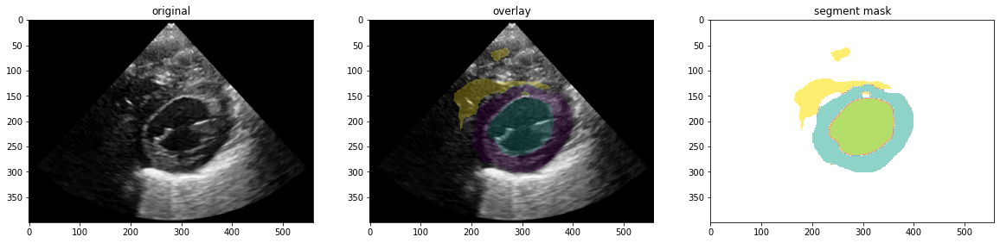

--> Frame 2:
	lv: cnt=9346, area_of_total=6.3%
	rv: cnt=5339, area_of_total=3.6%
	lv-o: cnt=9712, area_of_total=6.6%
	 ==> combined:  cnt=24397, area_of_total=16.5%
	 ==> lv+rv:  cnt=24397, area_of_total=10.0%


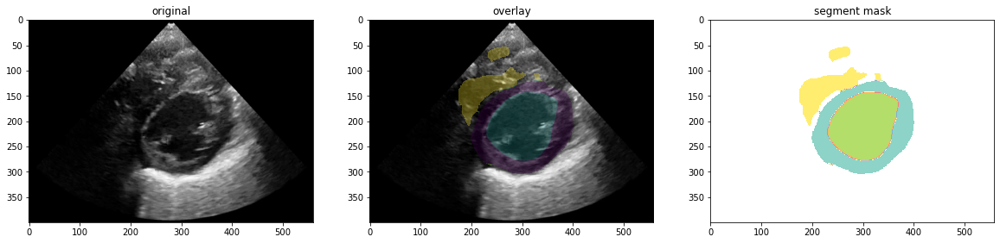

--> Frame 4:
	lv: cnt=8361, area_of_total=5.7%
	rv: cnt=4045, area_of_total=2.7%
	lv-o: cnt=10145, area_of_total=6.9%
	 ==> combined:  cnt=22551, area_of_total=15.3%
	 ==> lv+rv:  cnt=22551, area_of_total=8.4%


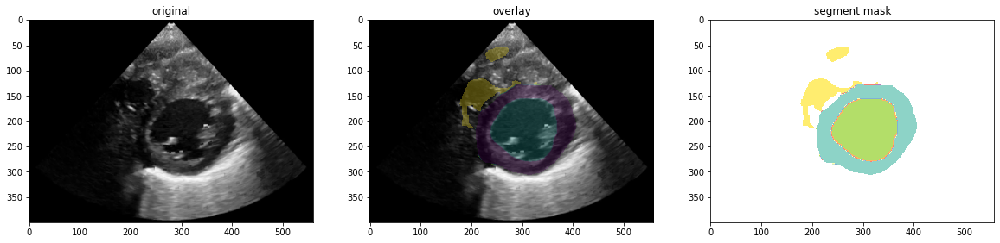

--> Frame 6:
	lv: cnt=4646, area_of_total=3.2%
	rv: cnt=3318, area_of_total=2.3%
	lv-o: cnt=11617, area_of_total=7.9%
	 ==> combined:  cnt=19581, area_of_total=13.3%
	 ==> lv+rv:  cnt=19581, area_of_total=5.4%


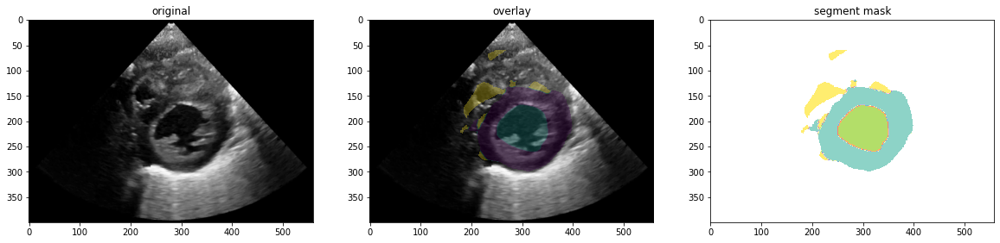

--> Frame 8:
	lv: cnt=3899, area_of_total=2.6%
	rv: cnt=5086, area_of_total=3.4%
	lv-o: cnt=11557, area_of_total=7.8%
	 ==> combined:  cnt=20542, area_of_total=13.9%
	 ==> lv+rv:  cnt=20542, area_of_total=6.1%


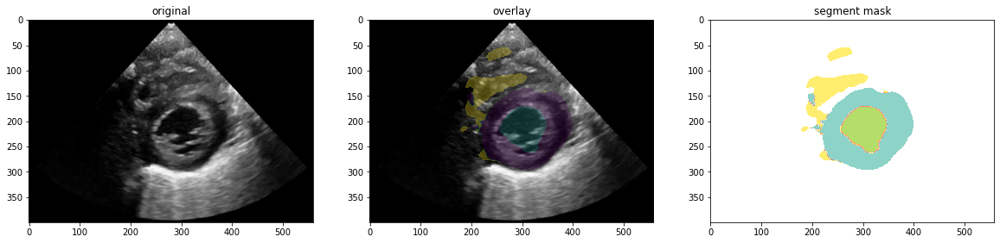

--> Frame 10:
	lv: cnt=5685, area_of_total=3.9%
	rv: cnt=4560, area_of_total=3.1%
	lv-o: cnt=10580, area_of_total=7.2%
	 ==> combined:  cnt=20825, area_of_total=14.1%
	 ==> lv+rv:  cnt=20825, area_of_total=6.9%


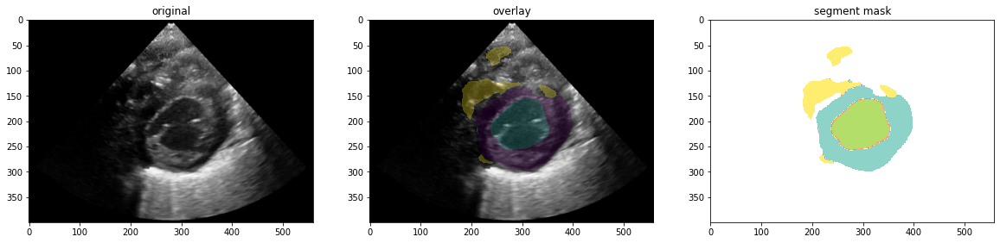

--> Frame 12:
	lv: cnt=9175, area_of_total=6.2%
	rv: cnt=4170, area_of_total=2.8%
	lv-o: cnt=9685, area_of_total=6.6%
	 ==> combined:  cnt=23030, area_of_total=15.6%
	 ==> lv+rv:  cnt=23030, area_of_total=9.1%


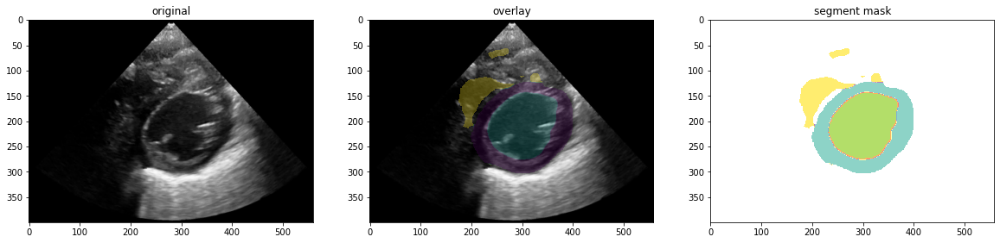

--> Frame 14:
	lv: cnt=7709, area_of_total=5.2%
	rv: cnt=4099, area_of_total=2.8%
	lv-o: cnt=10232, area_of_total=6.9%
	 ==> combined:  cnt=22040, area_of_total=14.9%
	 ==> lv+rv:  cnt=22040, area_of_total=8.0%


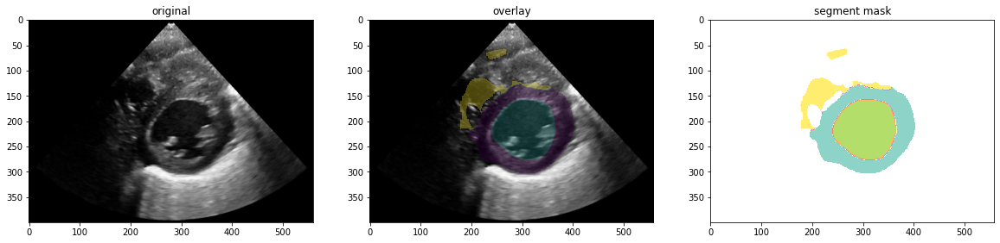

--> Frame 16:
	lv: cnt=4289, area_of_total=2.9%
	rv: cnt=3891, area_of_total=2.6%
	lv-o: cnt=10087, area_of_total=6.8%
	 ==> combined:  cnt=18267, area_of_total=12.4%
	 ==> lv+rv:  cnt=18267, area_of_total=5.5%


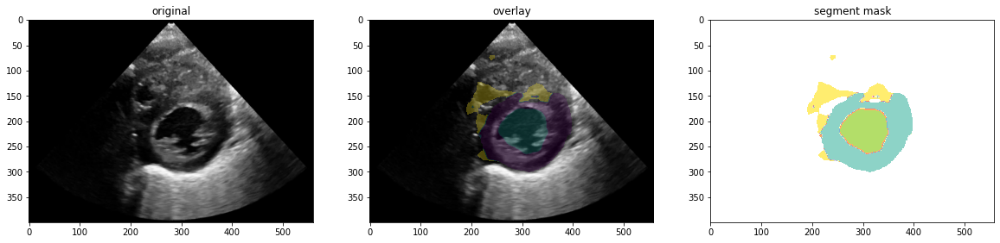

--> Frame 18:
	lv: cnt=3877, area_of_total=2.6%
	rv: cnt=4116, area_of_total=2.8%
	lv-o: cnt=10684, area_of_total=7.2%
	 ==> combined:  cnt=18677, area_of_total=12.7%
	 ==> lv+rv:  cnt=18677, area_of_total=5.4%


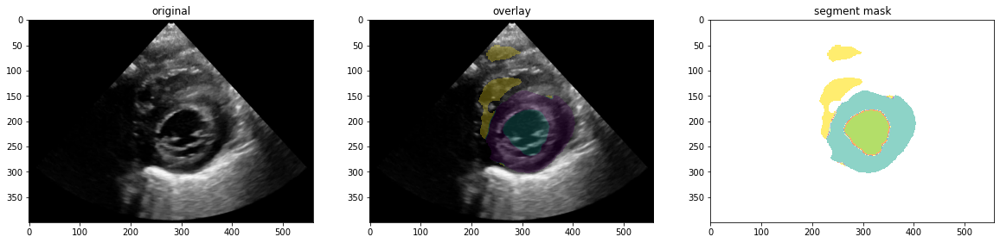

--> Frame 20:
	lv: cnt=4627, area_of_total=3.1%
	rv: cnt=3944, area_of_total=2.7%
	lv-o: cnt=8029, area_of_total=5.4%
	 ==> combined:  cnt=16600, area_of_total=11.3%
	 ==> lv+rv:  cnt=16600, area_of_total=5.8%


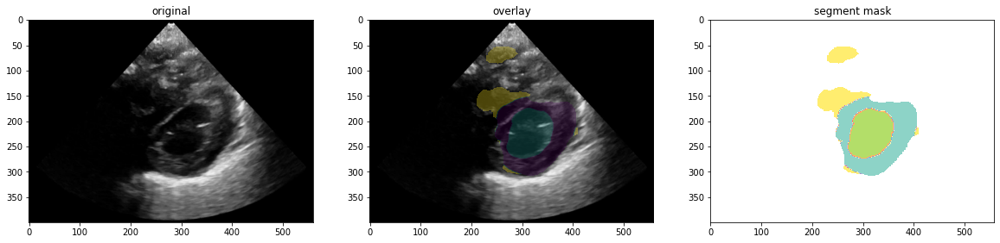

--> Frame 22:
	lv: cnt=6565, area_of_total=4.5%
	rv: cnt=3877, area_of_total=2.6%
	lv-o: cnt=8433, area_of_total=5.7%
	 ==> combined:  cnt=18875, area_of_total=12.8%
	 ==> lv+rv:  cnt=18875, area_of_total=7.1%


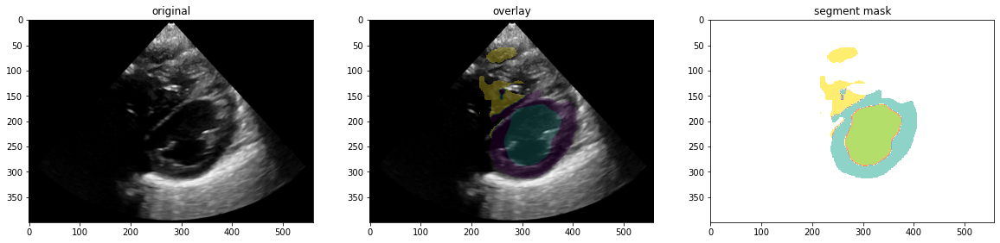

--> Frame 24:
	lv: cnt=5336, area_of_total=3.6%
	rv: cnt=3994, area_of_total=2.7%
	lv-o: cnt=7742, area_of_total=5.3%
	 ==> combined:  cnt=17072, area_of_total=11.6%
	 ==> lv+rv:  cnt=17072, area_of_total=6.3%


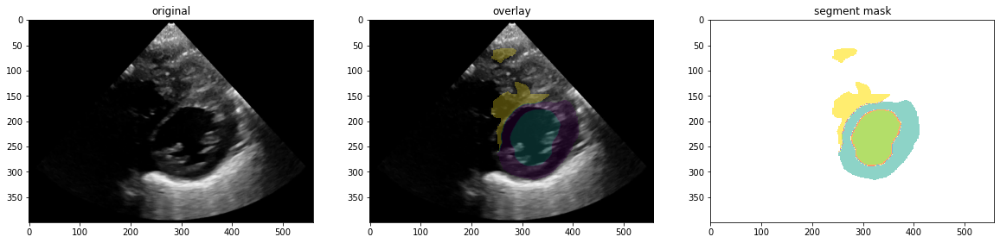

--> Frame 26:
	lv: cnt=2587, area_of_total=1.8%
	rv: cnt=5376, area_of_total=3.6%
	lv-o: cnt=8405, area_of_total=5.7%
	 ==> combined:  cnt=16368, area_of_total=11.1%
	 ==> lv+rv:  cnt=16368, area_of_total=5.4%


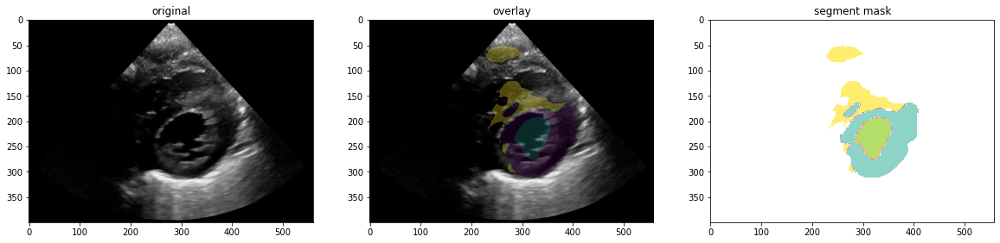

--> Frame 28:
	lv: cnt=1801, area_of_total=1.2%
	rv: cnt=4916, area_of_total=3.3%
	lv-o: cnt=10012, area_of_total=6.8%
	 ==> combined:  cnt=16729, area_of_total=11.3%
	 ==> lv+rv:  cnt=16729, area_of_total=4.6%


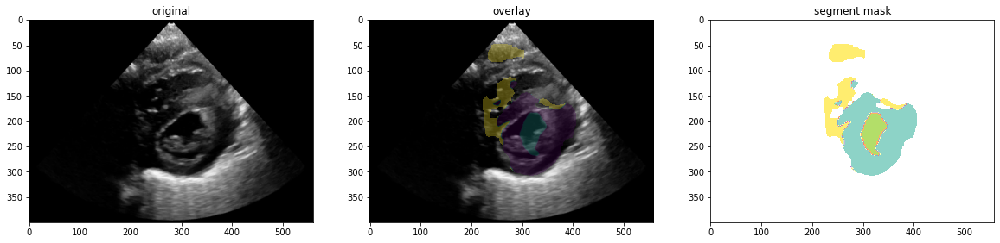

--> Frame 30:
	lv: cnt=6900, area_of_total=4.7%
	rv: cnt=4221, area_of_total=2.9%
	lv-o: cnt=10241, area_of_total=6.9%
	 ==> combined:  cnt=21362, area_of_total=14.5%
	 ==> lv+rv:  cnt=21362, area_of_total=7.5%


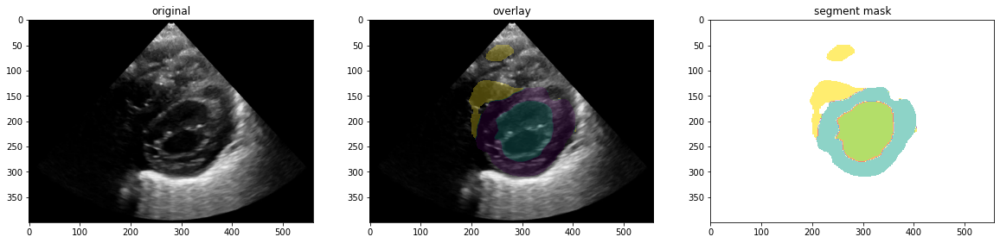

--> Frame 32:
	lv: cnt=9065, area_of_total=6.1%
	rv: cnt=3294, area_of_total=2.2%
	lv-o: cnt=9828, area_of_total=6.7%
	 ==> combined:  cnt=22187, area_of_total=15.0%
	 ==> lv+rv:  cnt=22187, area_of_total=8.4%


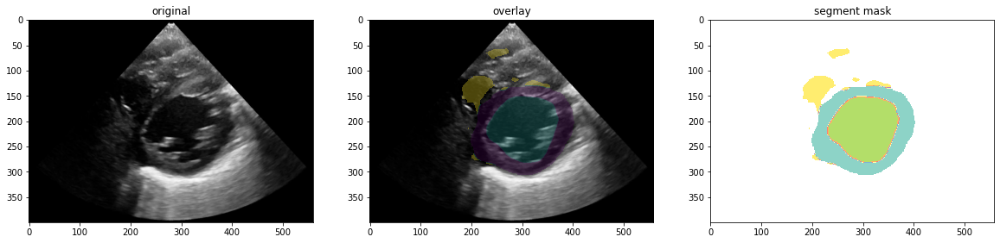

--> Frame 34:
	lv: cnt=5382, area_of_total=3.6%
	rv: cnt=3260, area_of_total=2.2%
	lv-o: cnt=11420, area_of_total=7.7%
	 ==> combined:  cnt=20062, area_of_total=13.6%
	 ==> lv+rv:  cnt=20062, area_of_total=5.9%


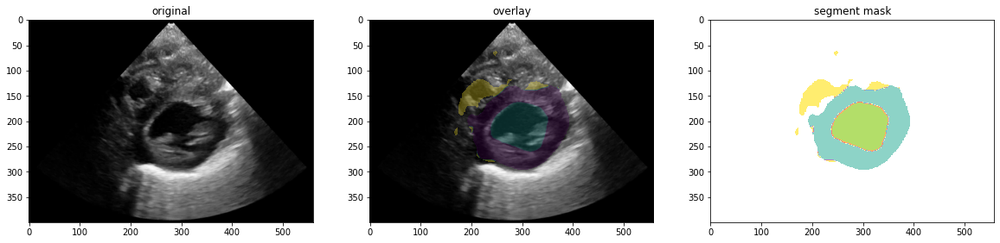

--> Frame 36:
	lv: cnt=3849, area_of_total=2.6%
	rv: cnt=5639, area_of_total=3.8%
	lv-o: cnt=11573, area_of_total=7.8%
	 ==> combined:  cnt=21061, area_of_total=14.3%
	 ==> lv+rv:  cnt=21061, area_of_total=6.4%


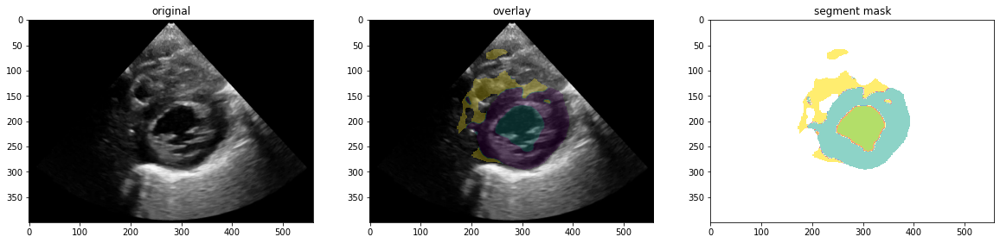

--> Frame 38:
	lv: cnt=5521, area_of_total=3.7%
	rv: cnt=4437, area_of_total=3.0%
	lv-o: cnt=10716, area_of_total=7.3%
	 ==> combined:  cnt=20674, area_of_total=14.0%
	 ==> lv+rv:  cnt=20674, area_of_total=6.8%


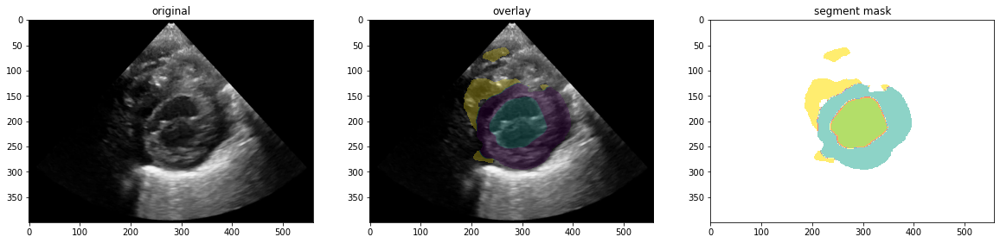

--> Frame 40:
	lv: cnt=9409, area_of_total=6.4%
	rv: cnt=3993, area_of_total=2.7%
	lv-o: cnt=9672, area_of_total=6.6%
	 ==> combined:  cnt=23074, area_of_total=15.6%
	 ==> lv+rv:  cnt=23074, area_of_total=9.1%


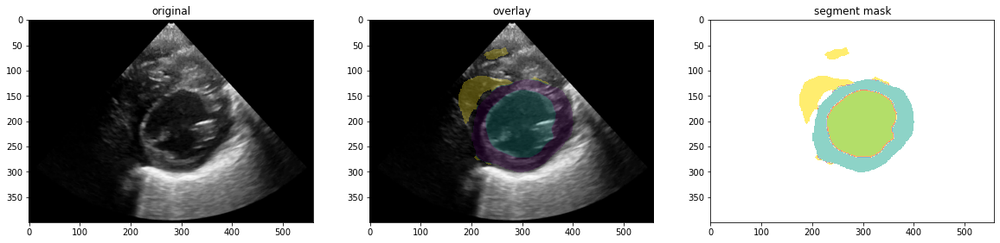

--> Frame 42:
	lv: cnt=8508, area_of_total=5.8%
	rv: cnt=3584, area_of_total=2.4%
	lv-o: cnt=9860, area_of_total=6.7%
	 ==> combined:  cnt=21952, area_of_total=14.9%
	 ==> lv+rv:  cnt=21952, area_of_total=8.2%


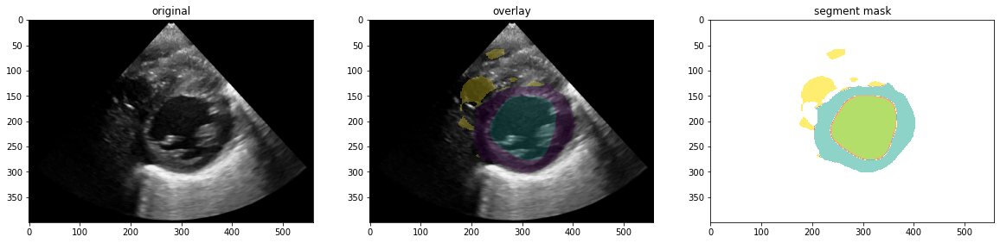

--> Frame 44:
	lv: cnt=5096, area_of_total=3.5%
	rv: cnt=3755, area_of_total=2.5%
	lv-o: cnt=10919, area_of_total=7.4%
	 ==> combined:  cnt=19770, area_of_total=13.4%
	 ==> lv+rv:  cnt=19770, area_of_total=6.0%


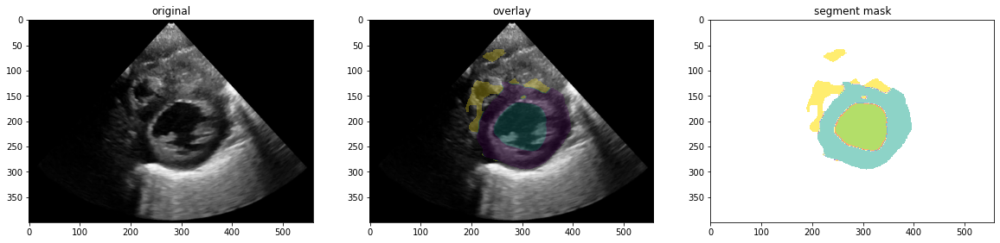

--> Frame 46:
	lv: cnt=3963, area_of_total=2.7%
	rv: cnt=4444, area_of_total=3.0%
	lv-o: cnt=10911, area_of_total=7.4%
	 ==> combined:  cnt=19318, area_of_total=13.1%
	 ==> lv+rv:  cnt=19318, area_of_total=5.7%


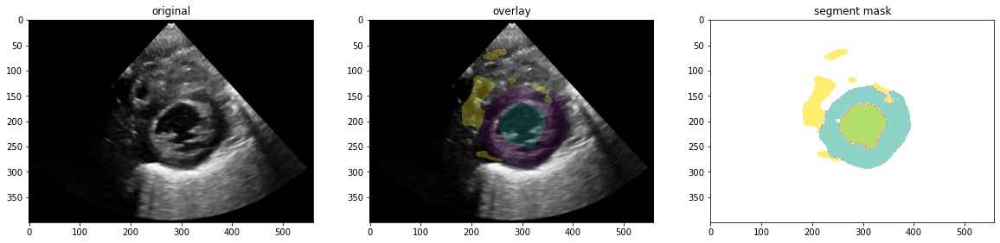

--> Frame 48:
	lv: cnt=6093, area_of_total=4.1%
	rv: cnt=4068, area_of_total=2.8%
	lv-o: cnt=9887, area_of_total=6.7%
	 ==> combined:  cnt=20048, area_of_total=13.6%
	 ==> lv+rv:  cnt=20048, area_of_total=6.9%


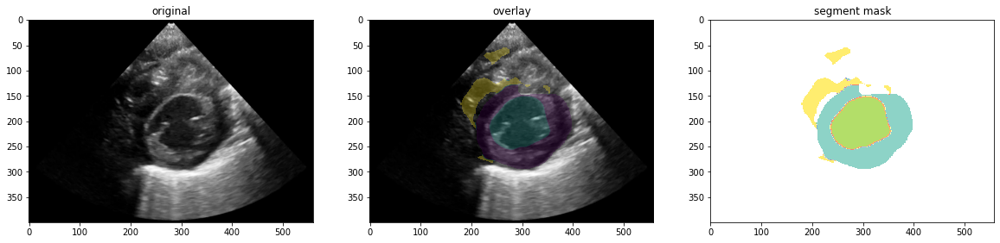

In [19]:
# HEALTHY PATIENT (96 KAPAP)
video, segm_mask, labels = get_data(videos_dir, '96KAPAP')
visualise(video, segm_mask, labels)

--> Frame 0:
	lv: cnt=3561, area_of_total=2.4%
	rv: cnt=6046, area_of_total=4.1%
	lv-o: cnt=9191, area_of_total=6.2%
	 ==> combined:  cnt=18798, area_of_total=12.7%
	 ==> lv+rv:  cnt=18798, area_of_total=6.5%


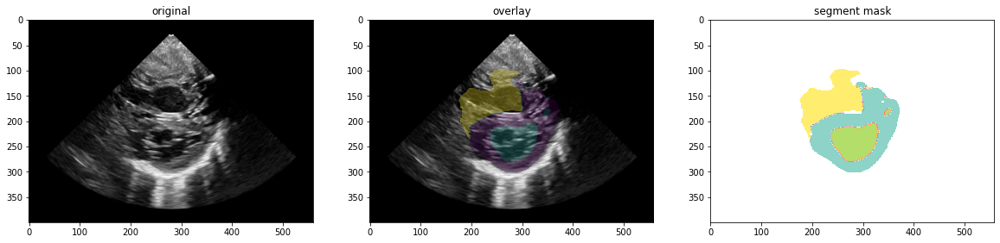

--> Frame 2:
	lv: cnt=3712, area_of_total=2.5%
	rv: cnt=5425, area_of_total=3.7%
	lv-o: cnt=10090, area_of_total=6.8%
	 ==> combined:  cnt=19227, area_of_total=13.0%
	 ==> lv+rv:  cnt=19227, area_of_total=6.2%


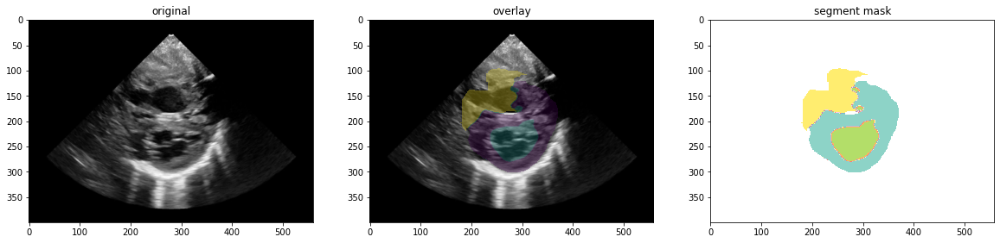

--> Frame 4:
	lv: cnt=5452, area_of_total=3.7%
	rv: cnt=3297, area_of_total=2.2%
	lv-o: cnt=10766, area_of_total=7.3%
	 ==> combined:  cnt=19515, area_of_total=13.2%
	 ==> lv+rv:  cnt=19515, area_of_total=5.9%


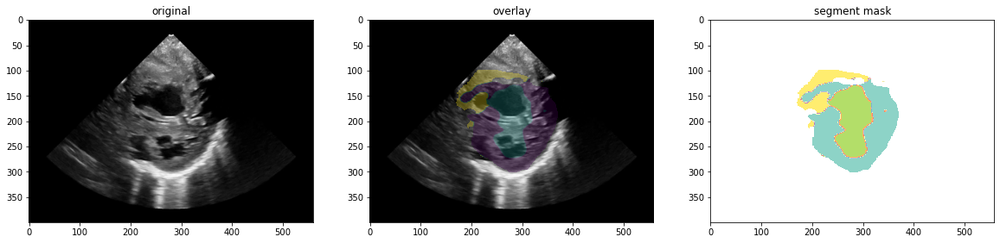

--> Frame 6:
	lv: cnt=3886, area_of_total=2.6%
	rv: cnt=3334, area_of_total=2.3%
	lv-o: cnt=12887, area_of_total=8.7%
	 ==> combined:  cnt=20107, area_of_total=13.6%
	 ==> lv+rv:  cnt=20107, area_of_total=4.9%


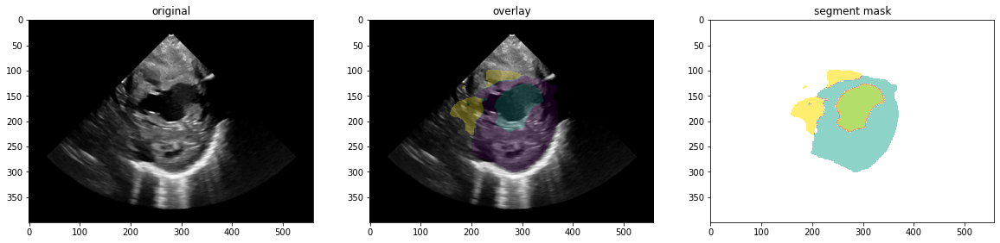

--> Frame 8:
	lv: cnt=4090, area_of_total=2.8%
	rv: cnt=3307, area_of_total=2.2%
	lv-o: cnt=11616, area_of_total=7.9%
	 ==> combined:  cnt=19013, area_of_total=12.9%
	 ==> lv+rv:  cnt=19013, area_of_total=5.0%


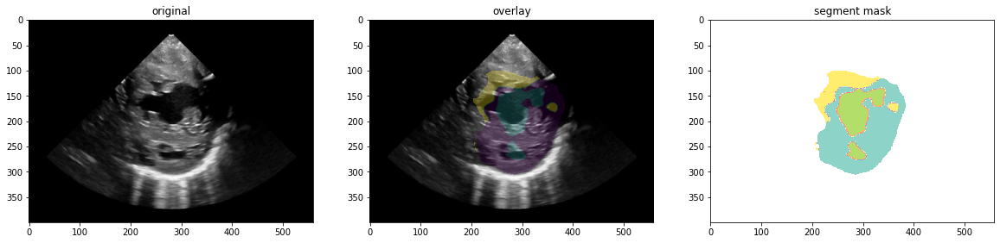

--> Frame 10:
	lv: cnt=7545, area_of_total=5.1%
	rv: cnt=2154, area_of_total=1.5%
	lv-o: cnt=11087, area_of_total=7.5%
	 ==> combined:  cnt=20786, area_of_total=14.1%
	 ==> lv+rv:  cnt=20786, area_of_total=6.6%


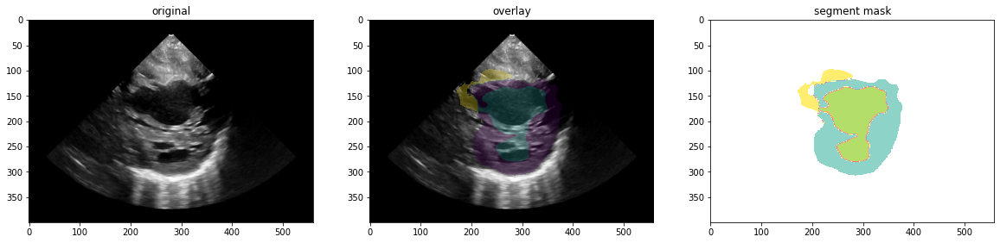

--> Frame 12:
	lv: cnt=9656, area_of_total=6.5%
	rv: cnt=3671, area_of_total=2.5%
	lv-o: cnt=8610, area_of_total=5.8%
	 ==> combined:  cnt=21937, area_of_total=14.9%
	 ==> lv+rv:  cnt=21937, area_of_total=9.0%


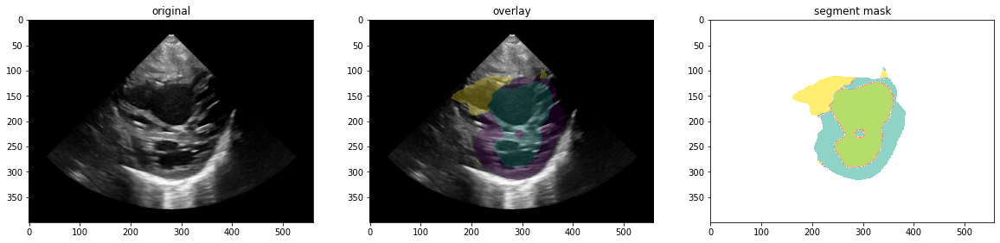

--> Frame 14:
	lv: cnt=5772, area_of_total=3.9%
	rv: cnt=11560, area_of_total=7.8%
	lv-o: cnt=8794, area_of_total=6.0%
	 ==> combined:  cnt=26126, area_of_total=17.7%
	 ==> lv+rv:  cnt=26126, area_of_total=11.8%


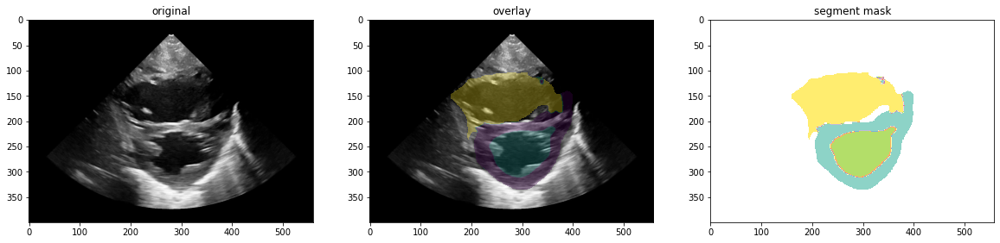

--> Frame 16:
	lv: cnt=4933, area_of_total=3.3%
	rv: cnt=9823, area_of_total=6.7%
	lv-o: cnt=12345, area_of_total=8.4%
	 ==> combined:  cnt=27101, area_of_total=18.4%
	 ==> lv+rv:  cnt=27101, area_of_total=10.0%


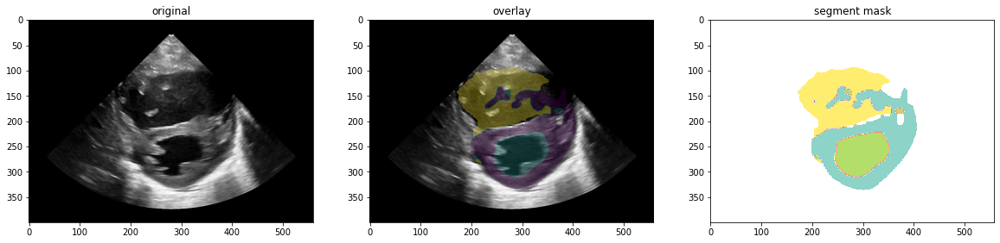

--> Frame 18:
	lv: cnt=3358, area_of_total=2.3%
	rv: cnt=8088, area_of_total=5.5%
	lv-o: cnt=14263, area_of_total=9.7%
	 ==> combined:  cnt=25709, area_of_total=17.4%
	 ==> lv+rv:  cnt=25709, area_of_total=7.8%


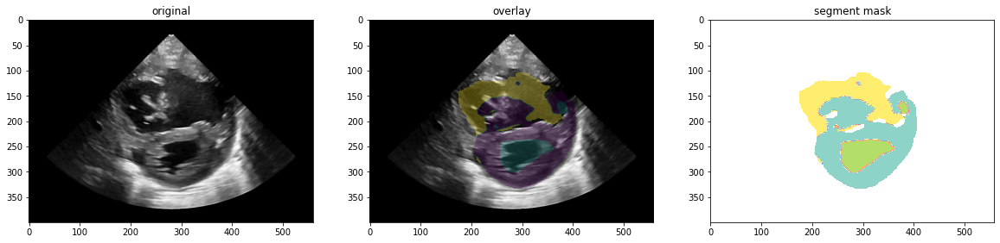

--> Frame 20:
	lv: cnt=9534, area_of_total=6.5%
	rv: cnt=3357, area_of_total=2.3%
	lv-o: cnt=13667, area_of_total=9.3%
	 ==> combined:  cnt=26558, area_of_total=18.0%
	 ==> lv+rv:  cnt=26558, area_of_total=8.7%


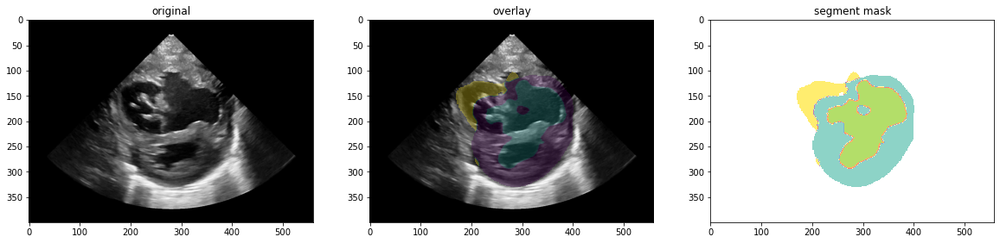

--> Frame 22:
	lv: cnt=7945, area_of_total=5.4%
	rv: cnt=4564, area_of_total=3.1%
	lv-o: cnt=13294, area_of_total=9.0%
	 ==> combined:  cnt=25803, area_of_total=17.5%
	 ==> lv+rv:  cnt=25803, area_of_total=8.5%


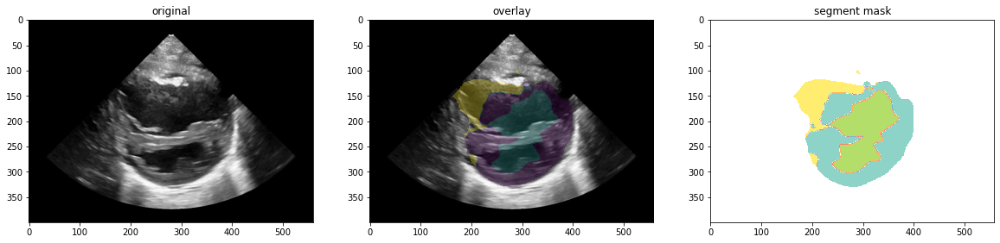

--> Frame 24:
	lv: cnt=7520, area_of_total=5.1%
	rv: cnt=5371, area_of_total=3.6%
	lv-o: cnt=14435, area_of_total=9.8%
	 ==> combined:  cnt=27326, area_of_total=18.5%
	 ==> lv+rv:  cnt=27326, area_of_total=8.7%


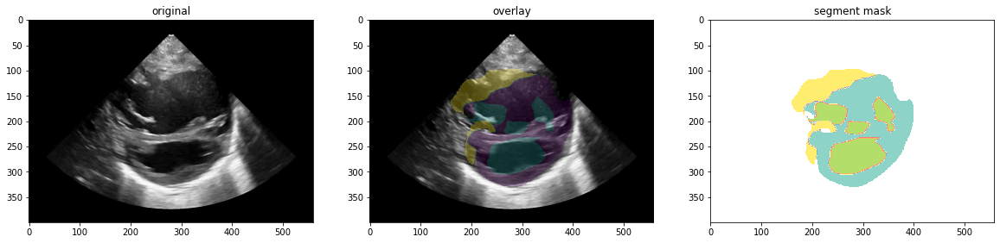

--> Frame 26:
	lv: cnt=7693, area_of_total=5.2%
	rv: cnt=6293, area_of_total=4.3%
	lv-o: cnt=15011, area_of_total=10.2%
	 ==> combined:  cnt=28997, area_of_total=19.7%
	 ==> lv+rv:  cnt=28997, area_of_total=9.5%


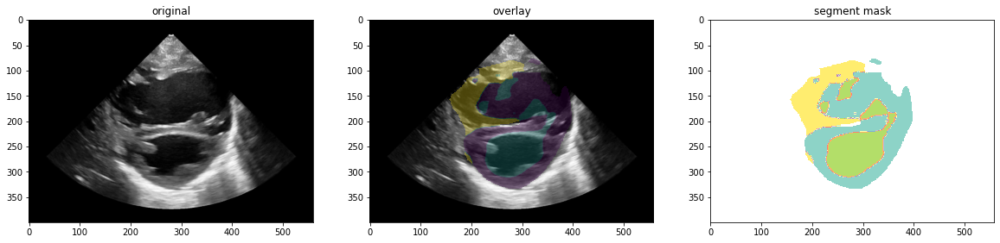

--> Frame 28:
	lv: cnt=5066, area_of_total=3.4%
	rv: cnt=9369, area_of_total=6.4%
	lv-o: cnt=12796, area_of_total=8.7%
	 ==> combined:  cnt=27231, area_of_total=18.5%
	 ==> lv+rv:  cnt=27231, area_of_total=9.8%


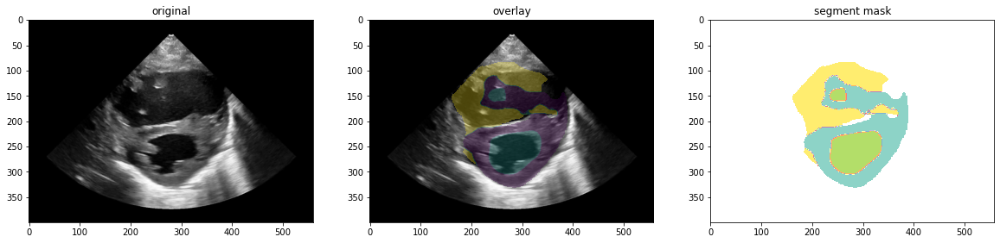

--> Frame 30:
	lv: cnt=5673, area_of_total=3.8%
	rv: cnt=5178, area_of_total=3.5%
	lv-o: cnt=14045, area_of_total=9.5%
	 ==> combined:  cnt=24896, area_of_total=16.9%
	 ==> lv+rv:  cnt=24896, area_of_total=7.4%


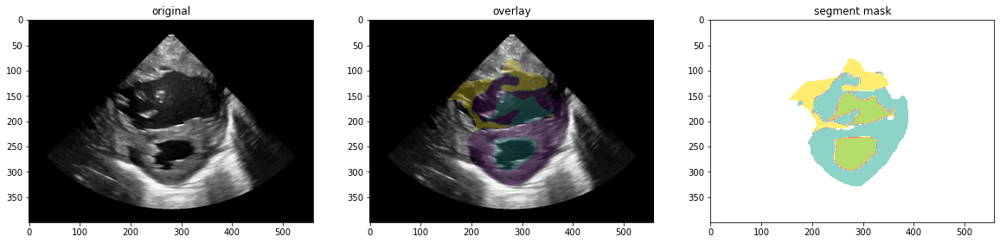

--> Frame 32:
	lv: cnt=8722, area_of_total=5.9%
	rv: cnt=4146, area_of_total=2.8%
	lv-o: cnt=12995, area_of_total=8.8%
	 ==> combined:  cnt=25863, area_of_total=17.5%
	 ==> lv+rv:  cnt=25863, area_of_total=8.7%


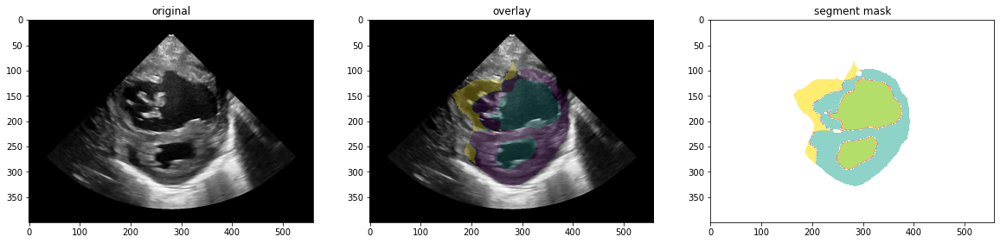

--> Frame 34:
	lv: cnt=6506, area_of_total=4.4%
	rv: cnt=6260, area_of_total=4.2%
	lv-o: cnt=11595, area_of_total=7.9%
	 ==> combined:  cnt=24361, area_of_total=16.5%
	 ==> lv+rv:  cnt=24361, area_of_total=8.7%


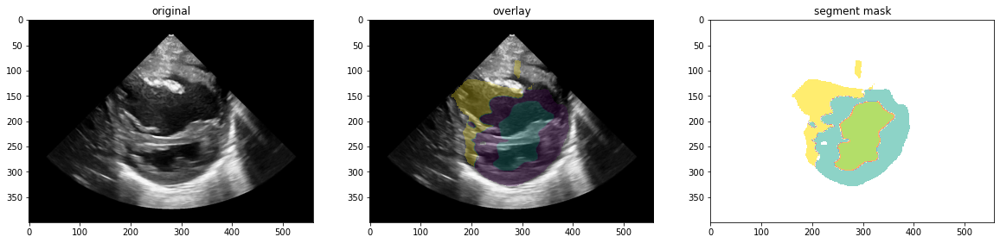

--> Frame 36:
	lv: cnt=9597, area_of_total=6.5%
	rv: cnt=5133, area_of_total=3.5%
	lv-o: cnt=13218, area_of_total=9.0%
	 ==> combined:  cnt=27948, area_of_total=19.0%
	 ==> lv+rv:  cnt=27948, area_of_total=10.0%


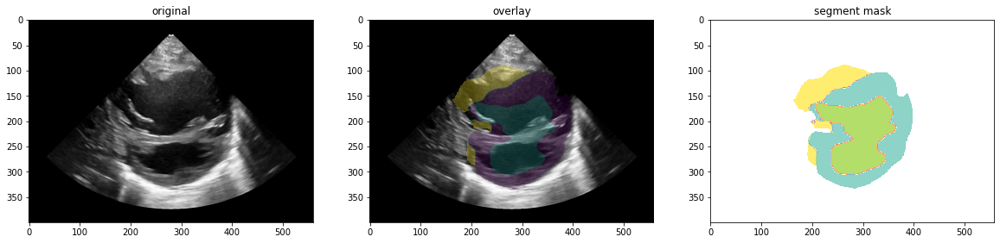

--> Frame 38:
	lv: cnt=6423, area_of_total=4.4%
	rv: cnt=5309, area_of_total=3.6%
	lv-o: cnt=16152, area_of_total=11.0%
	 ==> combined:  cnt=27884, area_of_total=18.9%
	 ==> lv+rv:  cnt=27884, area_of_total=8.0%


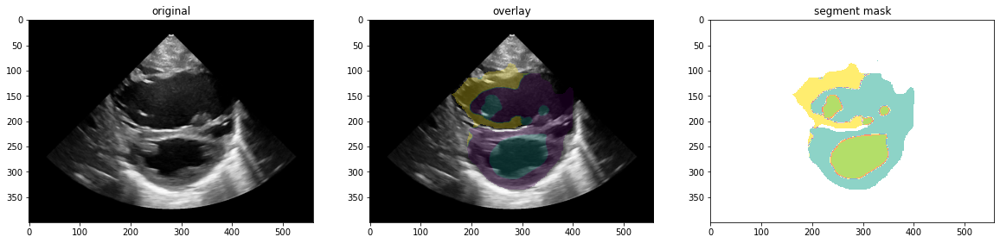

--> Frame 40:
	lv: cnt=6225, area_of_total=4.2%
	rv: cnt=6558, area_of_total=4.4%
	lv-o: cnt=15082, area_of_total=10.2%
	 ==> combined:  cnt=27865, area_of_total=18.9%
	 ==> lv+rv:  cnt=27865, area_of_total=8.7%


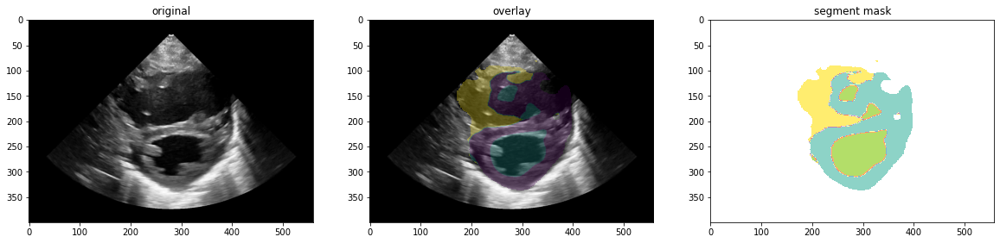

--> Frame 42:
	lv: cnt=5248, area_of_total=3.6%
	rv: cnt=6352, area_of_total=4.3%
	lv-o: cnt=14099, area_of_total=9.6%
	 ==> combined:  cnt=25699, area_of_total=17.4%
	 ==> lv+rv:  cnt=25699, area_of_total=7.9%


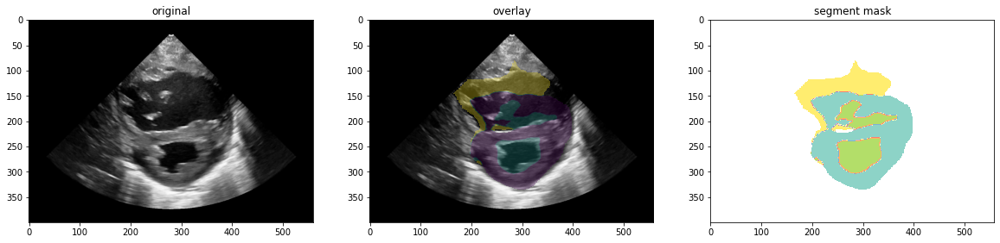

--> Frame 44:
	lv: cnt=7513, area_of_total=5.1%
	rv: cnt=3963, area_of_total=2.7%
	lv-o: cnt=14106, area_of_total=9.6%
	 ==> combined:  cnt=25582, area_of_total=17.3%
	 ==> lv+rv:  cnt=25582, area_of_total=7.8%


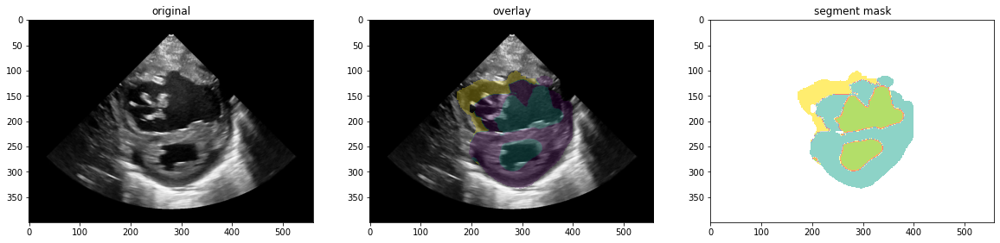

--> Frame 46:
	lv: cnt=6461, area_of_total=4.4%
	rv: cnt=4631, area_of_total=3.1%
	lv-o: cnt=12669, area_of_total=8.6%
	 ==> combined:  cnt=23761, area_of_total=16.1%
	 ==> lv+rv:  cnt=23761, area_of_total=7.5%


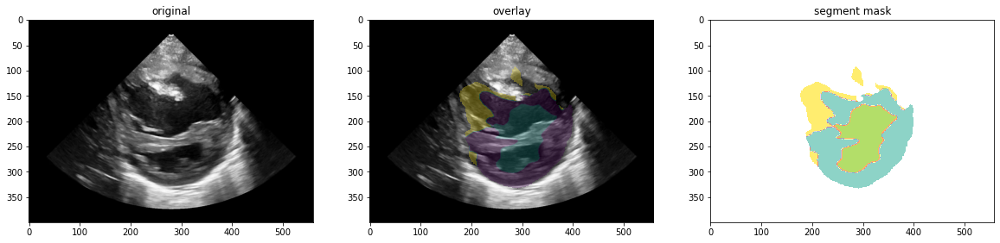

--> Frame 48:
	lv: cnt=9556, area_of_total=6.5%
	rv: cnt=4197, area_of_total=2.8%
	lv-o: cnt=13796, area_of_total=9.4%
	 ==> combined:  cnt=27549, area_of_total=18.7%
	 ==> lv+rv:  cnt=27549, area_of_total=9.3%


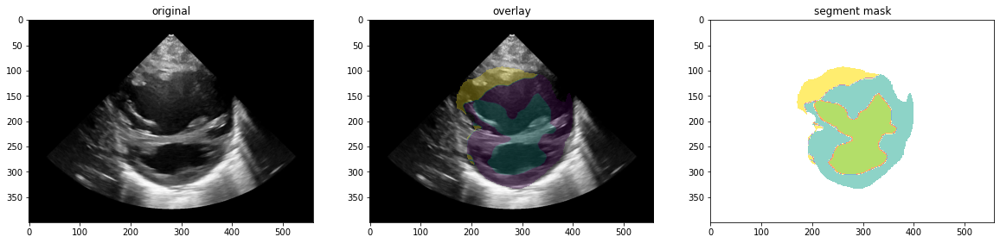

In [20]:
# PATIENT WITH PH - 55 KAPAP
video, segm_mask, labels = get_data(videos_dir, '55KAPAP')
visualise(video, segm_mask, labels)

--> Frame 0:
	lv: cnt=1660, area_of_total=1.1%
	rv: cnt=2485, area_of_total=1.7%
	lv-o: cnt=9487, area_of_total=6.4%
	 ==> combined:  cnt=13632, area_of_total=9.2%
	 ==> lv+rv:  cnt=13632, area_of_total=2.8%


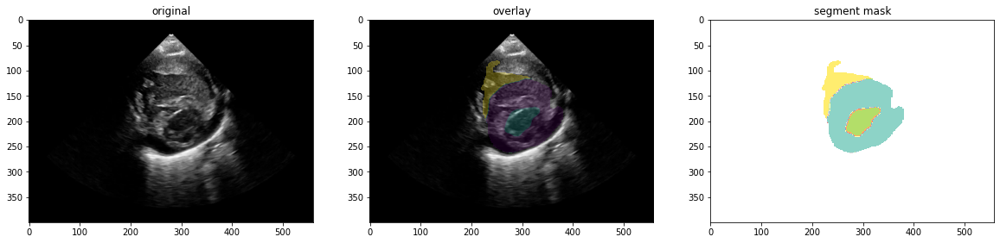

--> Frame 2:
	lv: cnt=1013, area_of_total=0.7%
	rv: cnt=3006, area_of_total=2.0%
	lv-o: cnt=10657, area_of_total=7.2%
	 ==> combined:  cnt=14676, area_of_total=10.0%
	 ==> lv+rv:  cnt=14676, area_of_total=2.7%


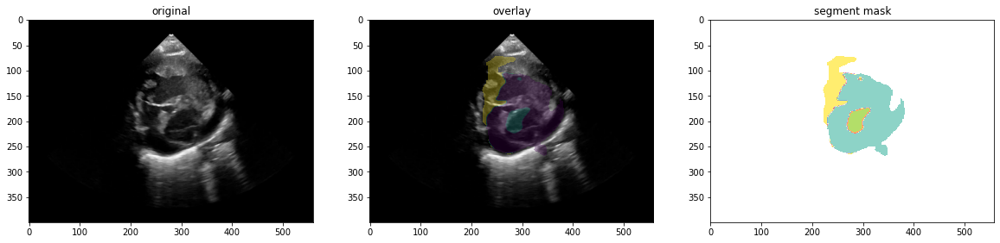

--> Frame 4:
	lv: cnt=1141, area_of_total=0.8%
	rv: cnt=4725, area_of_total=3.2%
	lv-o: cnt=8556, area_of_total=5.8%
	 ==> combined:  cnt=14422, area_of_total=9.8%
	 ==> lv+rv:  cnt=14422, area_of_total=4.0%


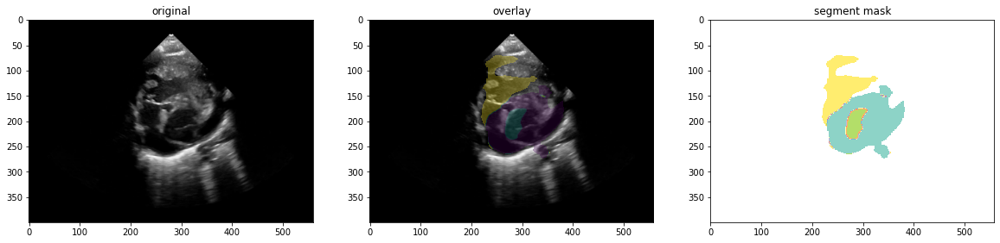

--> Frame 6:
	lv: cnt=1279, area_of_total=0.9%
	rv: cnt=3201, area_of_total=2.2%
	lv-o: cnt=8577, area_of_total=5.8%
	 ==> combined:  cnt=13057, area_of_total=8.9%
	 ==> lv+rv:  cnt=13057, area_of_total=3.0%


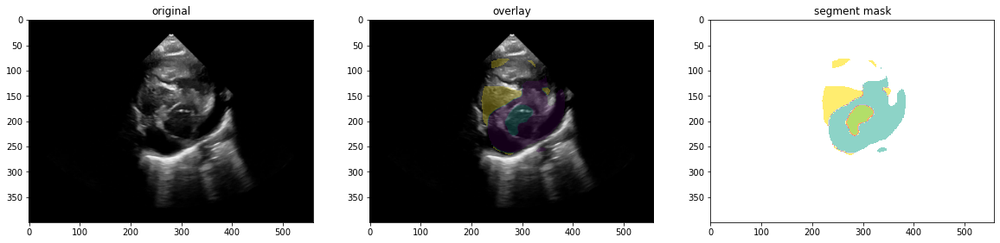

--> Frame 8:
	lv: cnt=1707, area_of_total=1.2%
	rv: cnt=2964, area_of_total=2.0%
	lv-o: cnt=6833, area_of_total=4.6%
	 ==> combined:  cnt=11504, area_of_total=7.8%
	 ==> lv+rv:  cnt=11504, area_of_total=3.2%


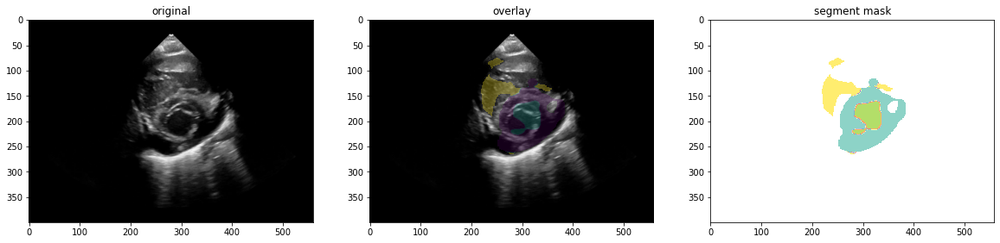

--> Frame 10:
	lv: cnt=1358, area_of_total=0.9%
	rv: cnt=5456, area_of_total=3.7%
	lv-o: cnt=7892, area_of_total=5.4%
	 ==> combined:  cnt=14706, area_of_total=10.0%
	 ==> lv+rv:  cnt=14706, area_of_total=4.6%


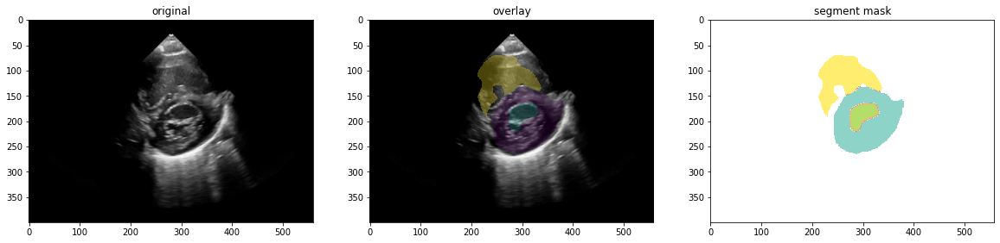

--> Frame 12:
	lv: cnt=1643, area_of_total=1.1%
	rv: cnt=6219, area_of_total=4.2%
	lv-o: cnt=6742, area_of_total=4.6%
	 ==> combined:  cnt=14604, area_of_total=9.9%
	 ==> lv+rv:  cnt=14604, area_of_total=5.3%


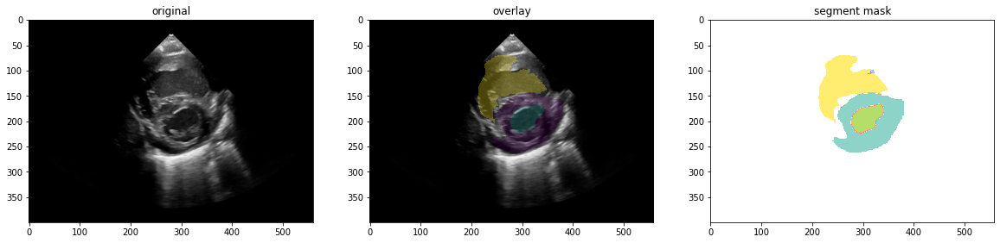

--> Frame 14:
	lv: cnt=1713, area_of_total=1.2%
	rv: cnt=2971, area_of_total=2.0%
	lv-o: cnt=8871, area_of_total=6.0%
	 ==> combined:  cnt=13555, area_of_total=9.2%
	 ==> lv+rv:  cnt=13555, area_of_total=3.2%


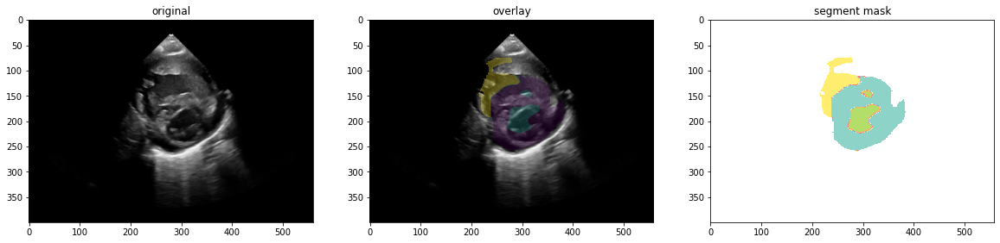

--> Frame 16:
	lv: cnt=2278, area_of_total=1.5%
	rv: cnt=1889, area_of_total=1.3%
	lv-o: cnt=8663, area_of_total=5.9%
	 ==> combined:  cnt=12830, area_of_total=8.7%
	 ==> lv+rv:  cnt=12830, area_of_total=2.8%


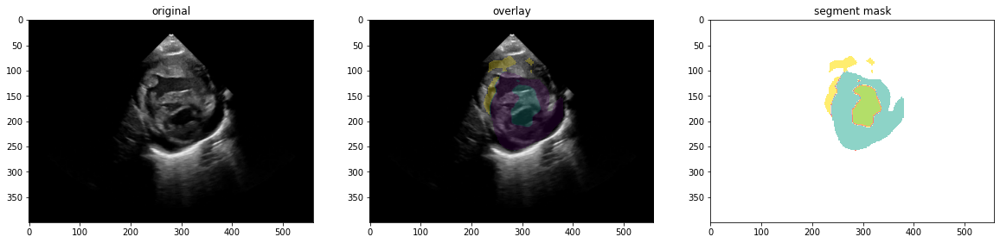

--> Frame 18:
	lv: cnt=2146, area_of_total=1.5%
	rv: cnt=1511, area_of_total=1.0%
	lv-o: cnt=8432, area_of_total=5.7%
	 ==> combined:  cnt=12089, area_of_total=8.2%
	 ==> lv+rv:  cnt=12089, area_of_total=2.5%


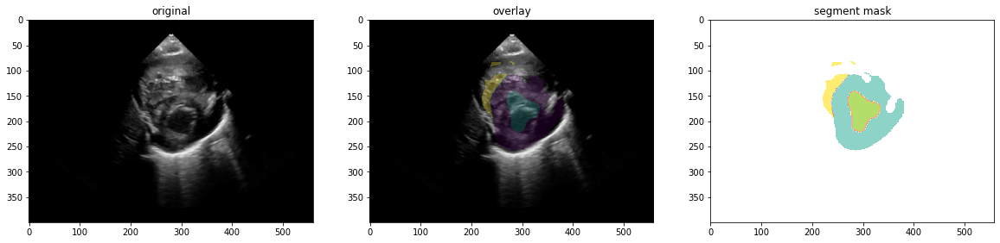

--> Frame 20:
	lv: cnt=2085, area_of_total=1.4%
	rv: cnt=2828, area_of_total=1.9%
	lv-o: cnt=7772, area_of_total=5.3%
	 ==> combined:  cnt=12685, area_of_total=8.6%
	 ==> lv+rv:  cnt=12685, area_of_total=3.3%


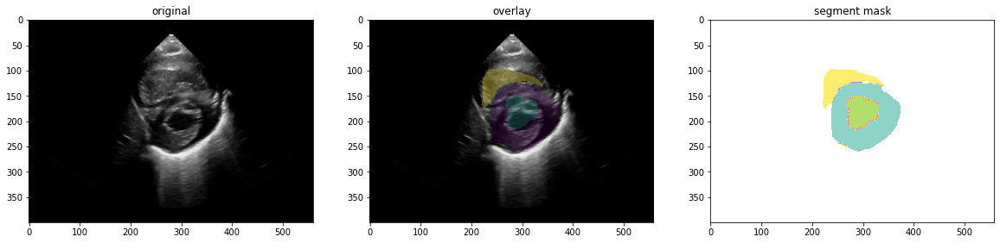

--> Frame 22:
	lv: cnt=1592, area_of_total=1.1%
	rv: cnt=3590, area_of_total=2.4%
	lv-o: cnt=8633, area_of_total=5.9%
	 ==> combined:  cnt=13815, area_of_total=9.4%
	 ==> lv+rv:  cnt=13815, area_of_total=3.5%


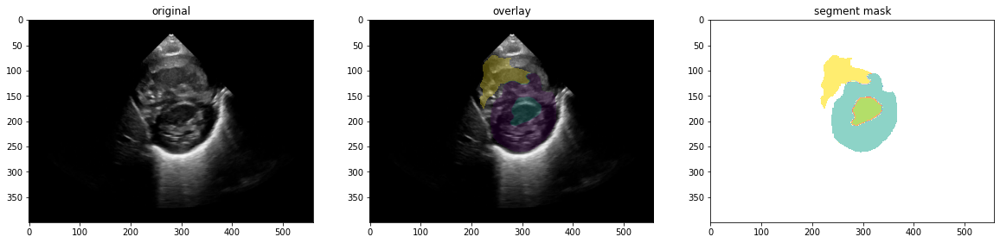

--> Frame 24:
	lv: cnt=4228, area_of_total=2.9%
	rv: cnt=1493, area_of_total=1.0%
	lv-o: cnt=8157, area_of_total=5.5%
	 ==> combined:  cnt=13878, area_of_total=9.4%
	 ==> lv+rv:  cnt=13878, area_of_total=3.9%


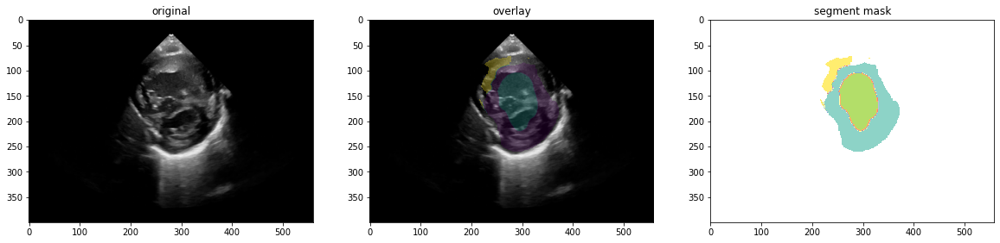

--> Frame 26:
	lv: cnt=3291, area_of_total=2.2%
	rv: cnt=1159, area_of_total=0.8%
	lv-o: cnt=7627, area_of_total=5.2%
	 ==> combined:  cnt=12077, area_of_total=8.2%
	 ==> lv+rv:  cnt=12077, area_of_total=3.0%


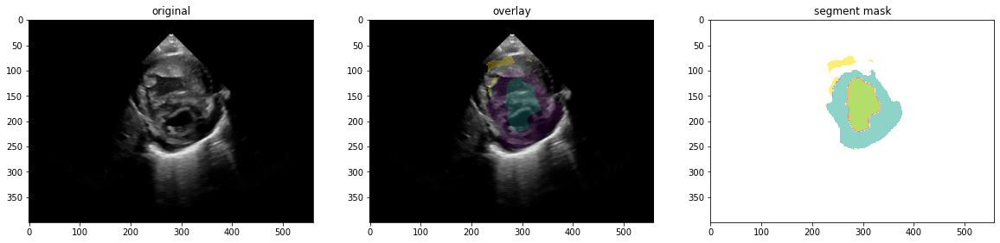

--> Frame 28:
	lv: cnt=1051, area_of_total=0.7%
	rv: cnt=3768, area_of_total=2.6%
	lv-o: cnt=8655, area_of_total=5.9%
	 ==> combined:  cnt=13474, area_of_total=9.1%
	 ==> lv+rv:  cnt=13474, area_of_total=3.3%


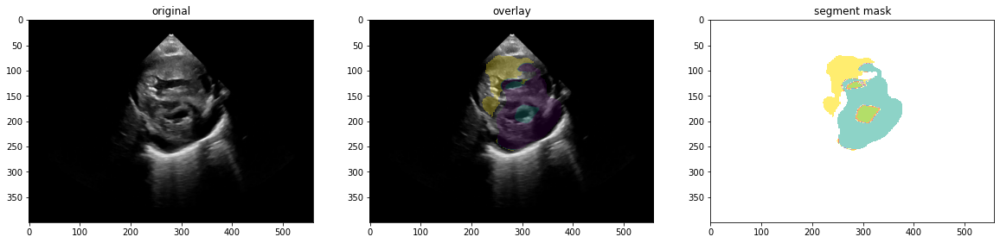

--> Frame 30:
	lv: cnt=2215, area_of_total=1.5%
	rv: cnt=2905, area_of_total=2.0%
	lv-o: cnt=7221, area_of_total=4.9%
	 ==> combined:  cnt=12341, area_of_total=8.4%
	 ==> lv+rv:  cnt=12341, area_of_total=3.5%


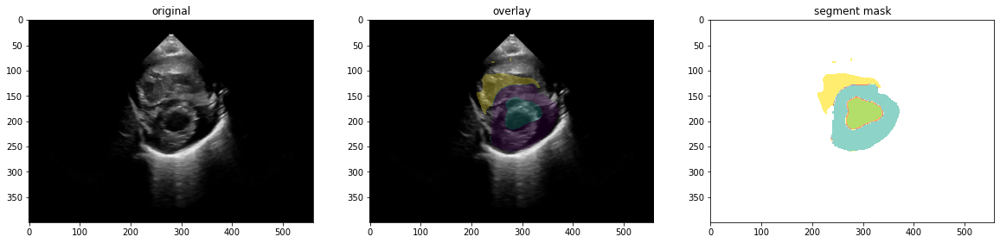

--> Frame 32:
	lv: cnt=2268, area_of_total=1.5%
	rv: cnt=3944, area_of_total=2.7%
	lv-o: cnt=8110, area_of_total=5.5%
	 ==> combined:  cnt=14322, area_of_total=9.7%
	 ==> lv+rv:  cnt=14322, area_of_total=4.2%


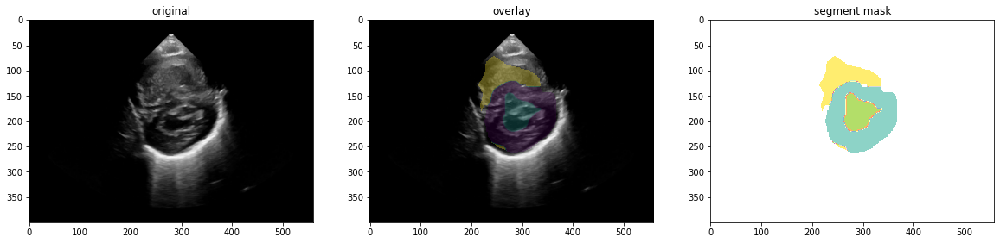

--> Frame 34:
	lv: cnt=1956, area_of_total=1.3%
	rv: cnt=3530, area_of_total=2.4%
	lv-o: cnt=9042, area_of_total=6.1%
	 ==> combined:  cnt=14528, area_of_total=9.9%
	 ==> lv+rv:  cnt=14528, area_of_total=3.7%


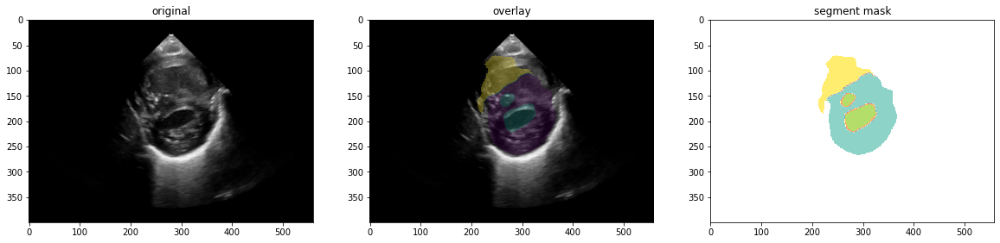

--> Frame 36:
	lv: cnt=3795, area_of_total=2.6%
	rv: cnt=1922, area_of_total=1.3%
	lv-o: cnt=7995, area_of_total=5.4%
	 ==> combined:  cnt=13712, area_of_total=9.3%
	 ==> lv+rv:  cnt=13712, area_of_total=3.9%


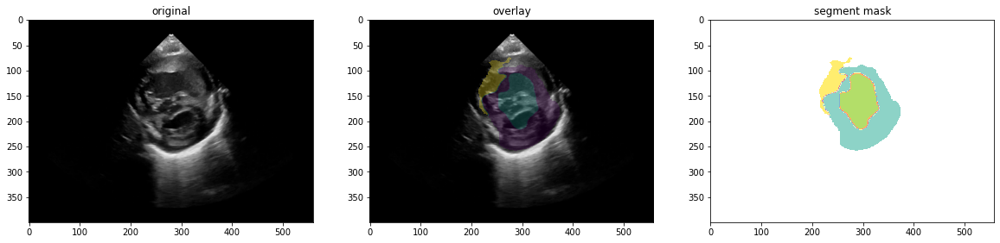

--> Frame 38:
	lv: cnt=3054, area_of_total=2.1%
	rv: cnt=1762, area_of_total=1.2%
	lv-o: cnt=7413, area_of_total=5.0%
	 ==> combined:  cnt=12229, area_of_total=8.3%
	 ==> lv+rv:  cnt=12229, area_of_total=3.3%


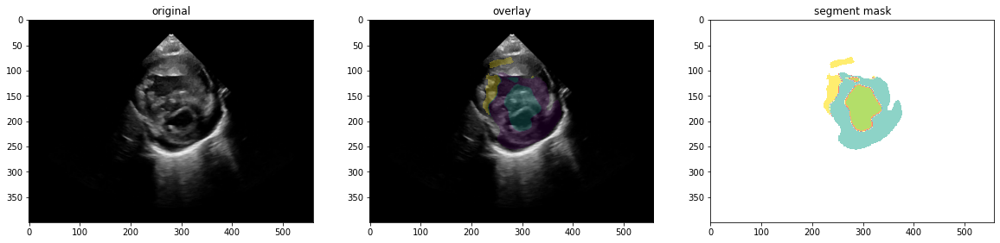

--> Frame 40:
	lv: cnt=554, area_of_total=0.4%
	rv: cnt=3931, area_of_total=2.7%
	lv-o: cnt=8575, area_of_total=5.8%
	 ==> combined:  cnt=13060, area_of_total=8.9%
	 ==> lv+rv:  cnt=13060, area_of_total=3.0%


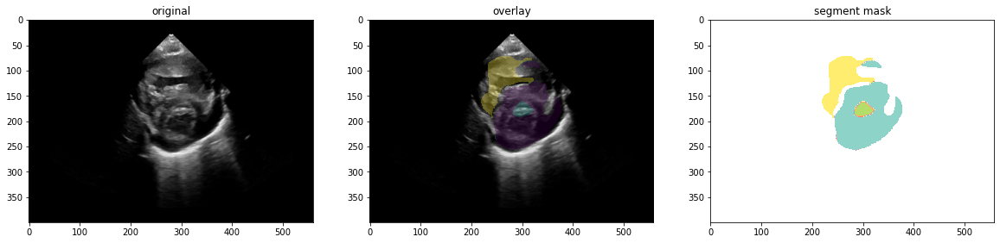

--> Frame 42:
	lv: cnt=2772, area_of_total=1.9%
	rv: cnt=2095, area_of_total=1.4%
	lv-o: cnt=7797, area_of_total=5.3%
	 ==> combined:  cnt=12664, area_of_total=8.6%
	 ==> lv+rv:  cnt=12664, area_of_total=3.3%


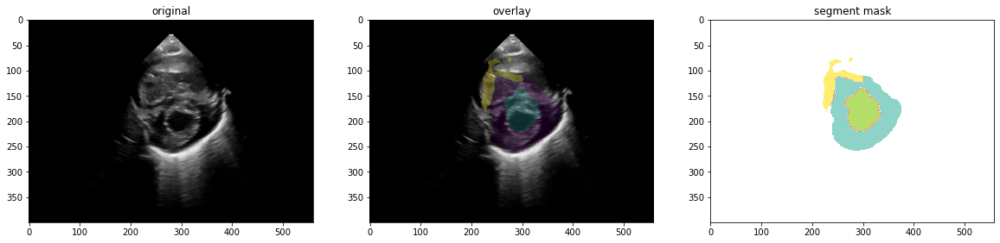

--> Frame 44:
	lv: cnt=2237, area_of_total=1.5%
	rv: cnt=2624, area_of_total=1.8%
	lv-o: cnt=9293, area_of_total=6.3%
	 ==> combined:  cnt=14154, area_of_total=9.6%
	 ==> lv+rv:  cnt=14154, area_of_total=3.3%


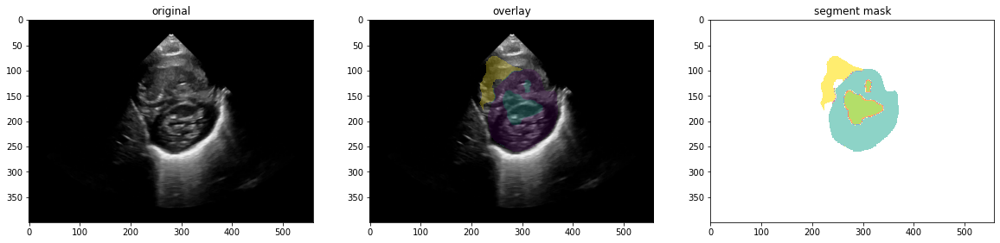

--> Frame 46:
	lv: cnt=3519, area_of_total=2.4%
	rv: cnt=2428, area_of_total=1.6%
	lv-o: cnt=8410, area_of_total=5.7%
	 ==> combined:  cnt=14357, area_of_total=9.7%
	 ==> lv+rv:  cnt=14357, area_of_total=4.0%


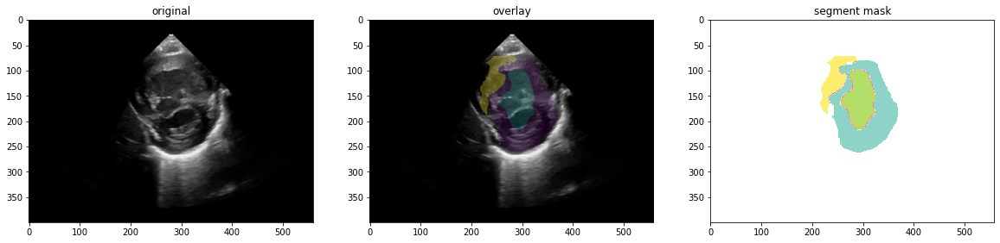

--> Frame 48:
	lv: cnt=3364, area_of_total=2.3%
	rv: cnt=1811, area_of_total=1.2%
	lv-o: cnt=7359, area_of_total=5.0%
	 ==> combined:  cnt=12534, area_of_total=8.5%
	 ==> lv+rv:  cnt=12534, area_of_total=3.5%


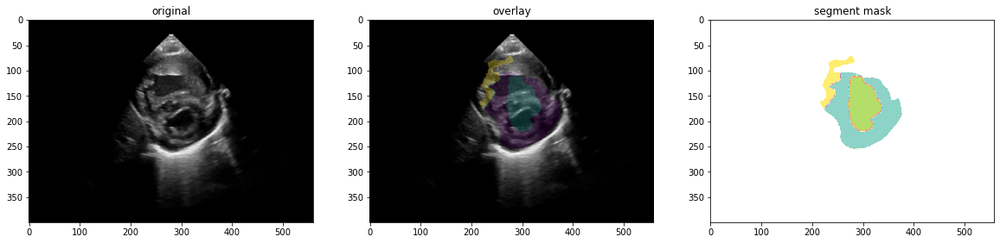

In [21]:
# NON-PH (but with some other) - 30 KAPAP
video, segm_mask, labels = get_data(videos_dir, '30KAPAP')
visualise(video, segm_mask, labels)

--> Frame 0:
	lv: cnt=6495, area_of_total=4.4%
	rv: cnt=4806, area_of_total=3.3%
	lv-o: cnt=10930, area_of_total=7.4%
	 ==> combined:  cnt=22231, area_of_total=15.1%
	 ==> lv+rv:  cnt=22231, area_of_total=7.7%


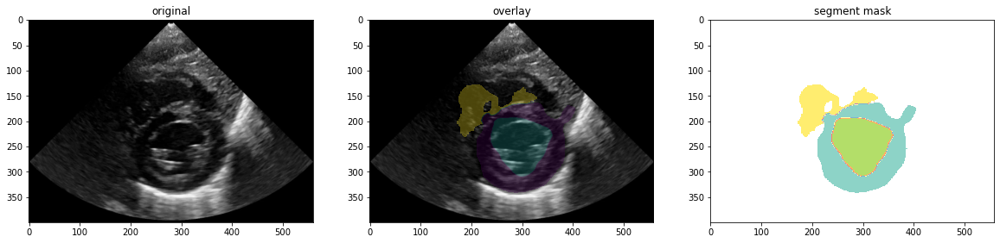

--> Frame 2:
	lv: cnt=4383, area_of_total=3.0%
	rv: cnt=4135, area_of_total=2.8%
	lv-o: cnt=11455, area_of_total=7.8%
	 ==> combined:  cnt=19973, area_of_total=13.5%
	 ==> lv+rv:  cnt=19973, area_of_total=5.8%


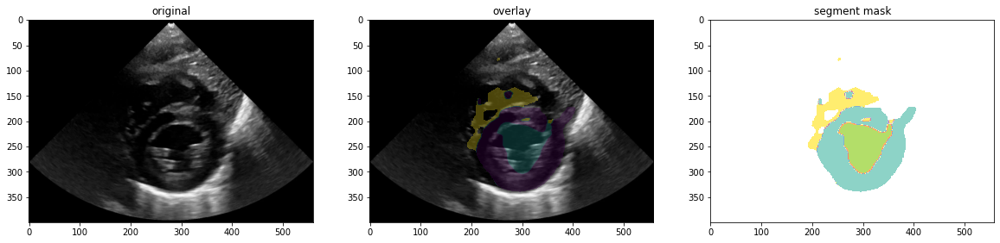

--> Frame 4:
	lv: cnt=3557, area_of_total=2.4%
	rv: cnt=3048, area_of_total=2.1%
	lv-o: cnt=10966, area_of_total=7.4%
	 ==> combined:  cnt=17571, area_of_total=11.9%
	 ==> lv+rv:  cnt=17571, area_of_total=4.5%


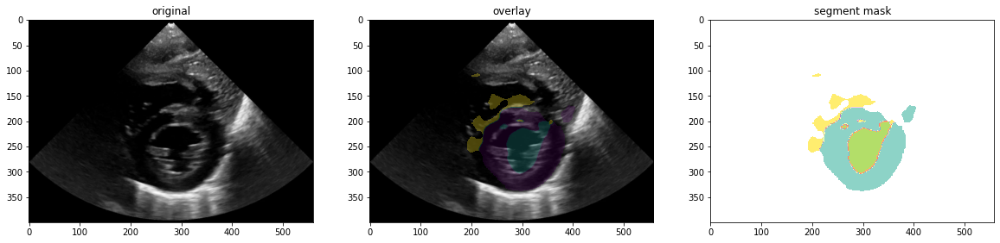

--> Frame 6:
	lv: cnt=5187, area_of_total=3.5%
	rv: cnt=1596, area_of_total=1.1%
	lv-o: cnt=10055, area_of_total=6.8%
	 ==> combined:  cnt=16838, area_of_total=11.4%
	 ==> lv+rv:  cnt=16838, area_of_total=4.6%


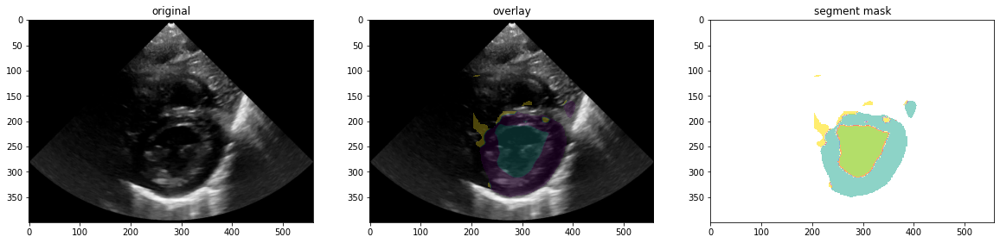

--> Frame 8:
	lv: cnt=7807, area_of_total=5.3%
	rv: cnt=4127, area_of_total=2.8%
	lv-o: cnt=10214, area_of_total=6.9%
	 ==> combined:  cnt=22148, area_of_total=15.0%
	 ==> lv+rv:  cnt=22148, area_of_total=8.1%


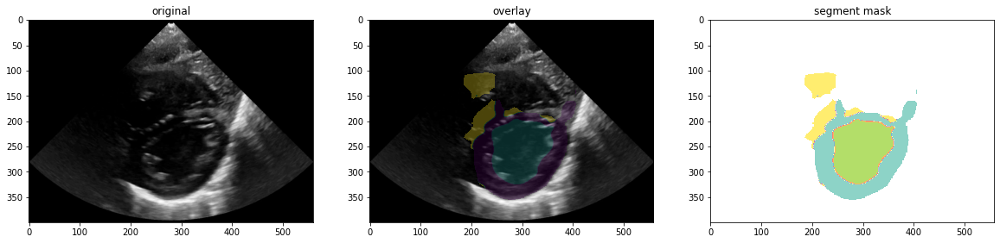

--> Frame 10:
	lv: cnt=6652, area_of_total=4.5%
	rv: cnt=2076, area_of_total=1.4%
	lv-o: cnt=10258, area_of_total=7.0%
	 ==> combined:  cnt=18986, area_of_total=12.9%
	 ==> lv+rv:  cnt=18986, area_of_total=5.9%


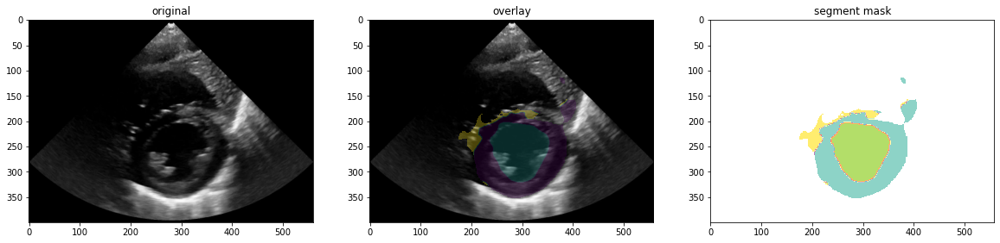

--> Frame 12:
	lv: cnt=4658, area_of_total=3.2%
	rv: cnt=7350, area_of_total=5.0%
	lv-o: cnt=13073, area_of_total=8.9%
	 ==> combined:  cnt=25081, area_of_total=17.0%
	 ==> lv+rv:  cnt=25081, area_of_total=8.1%


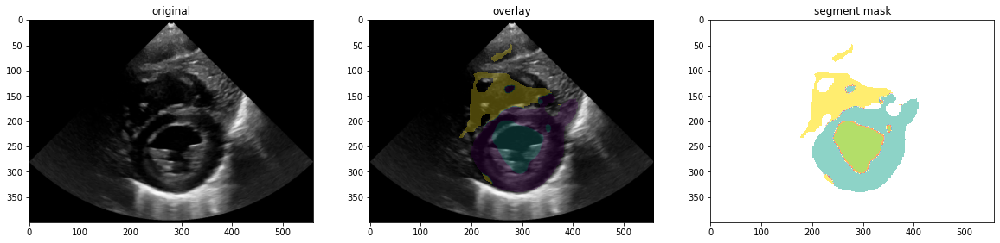

--> Frame 14:
	lv: cnt=4895, area_of_total=3.3%
	rv: cnt=8845, area_of_total=6.0%
	lv-o: cnt=11484, area_of_total=7.8%
	 ==> combined:  cnt=25224, area_of_total=17.1%
	 ==> lv+rv:  cnt=25224, area_of_total=9.3%


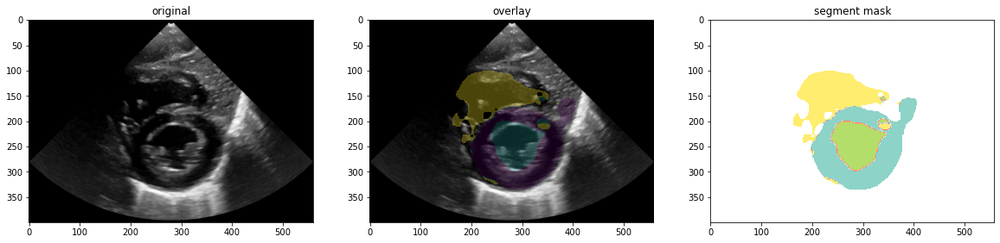

--> Frame 16:
	lv: cnt=7976, area_of_total=5.4%
	rv: cnt=5113, area_of_total=3.5%
	lv-o: cnt=11304, area_of_total=7.7%
	 ==> combined:  cnt=24393, area_of_total=16.5%
	 ==> lv+rv:  cnt=24393, area_of_total=8.9%


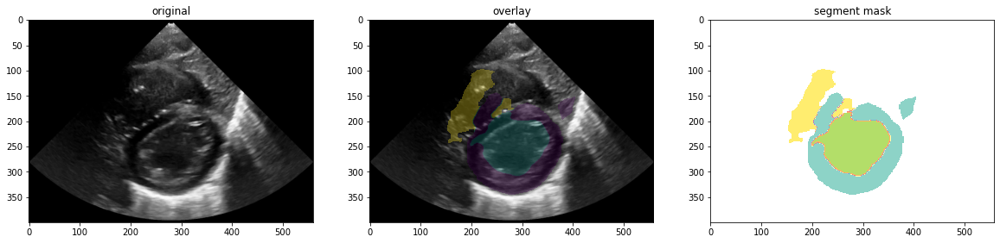

--> Frame 18:
	lv: cnt=8665, area_of_total=5.9%
	rv: cnt=6133, area_of_total=4.2%
	lv-o: cnt=11008, area_of_total=7.5%
	 ==> combined:  cnt=25806, area_of_total=17.5%
	 ==> lv+rv:  cnt=25806, area_of_total=10.0%


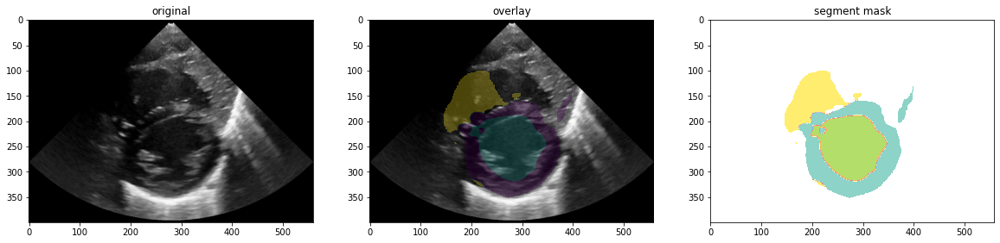

--> Frame 20:
	lv: cnt=6772, area_of_total=4.6%
	rv: cnt=8003, area_of_total=5.4%
	lv-o: cnt=12813, area_of_total=8.7%
	 ==> combined:  cnt=27588, area_of_total=18.7%
	 ==> lv+rv:  cnt=27588, area_of_total=10.0%


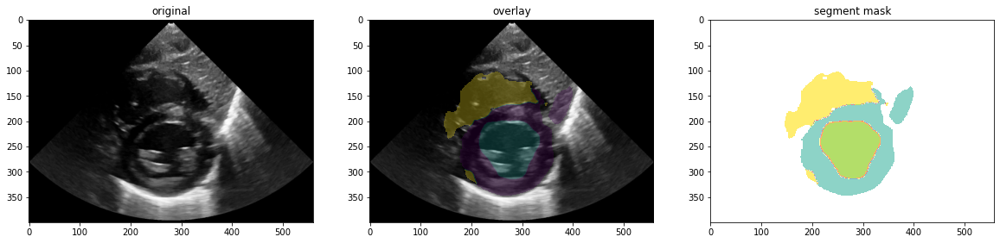

--> Frame 22:
	lv: cnt=4246, area_of_total=2.9%
	rv: cnt=7093, area_of_total=4.8%
	lv-o: cnt=12831, area_of_total=8.7%
	 ==> combined:  cnt=24170, area_of_total=16.4%
	 ==> lv+rv:  cnt=24170, area_of_total=7.7%


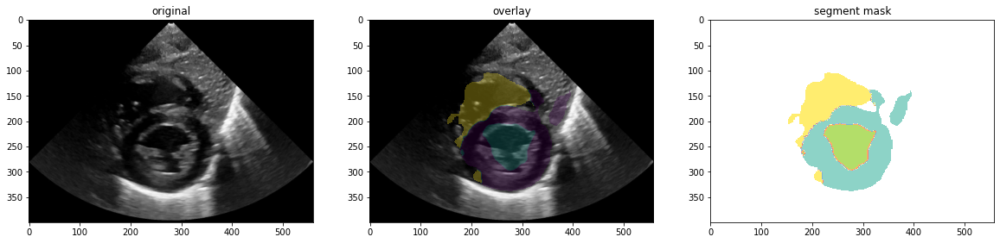

--> Frame 24:
	lv: cnt=5033, area_of_total=3.4%
	rv: cnt=4579, area_of_total=3.1%
	lv-o: cnt=11885, area_of_total=8.1%
	 ==> combined:  cnt=21497, area_of_total=14.6%
	 ==> lv+rv:  cnt=21497, area_of_total=6.5%


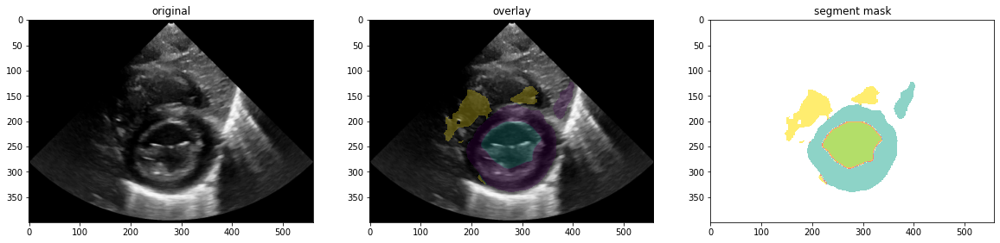

--> Frame 26:
	lv: cnt=9038, area_of_total=6.1%
	rv: cnt=6953, area_of_total=4.7%
	lv-o: cnt=10292, area_of_total=7.0%
	 ==> combined:  cnt=26283, area_of_total=17.8%
	 ==> lv+rv:  cnt=26283, area_of_total=10.8%


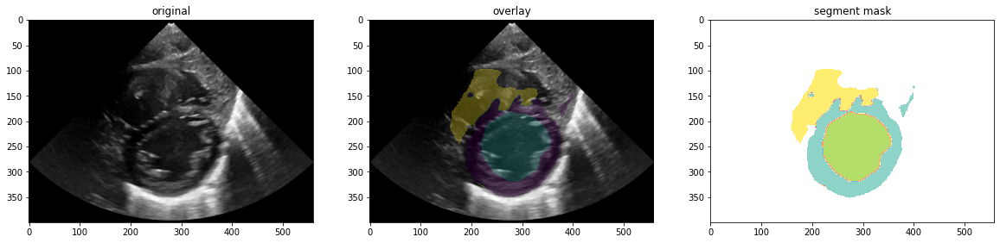

--> Frame 28:
	lv: cnt=8716, area_of_total=5.9%
	rv: cnt=6472, area_of_total=4.4%
	lv-o: cnt=11578, area_of_total=7.9%
	 ==> combined:  cnt=26766, area_of_total=18.2%
	 ==> lv+rv:  cnt=26766, area_of_total=10.3%


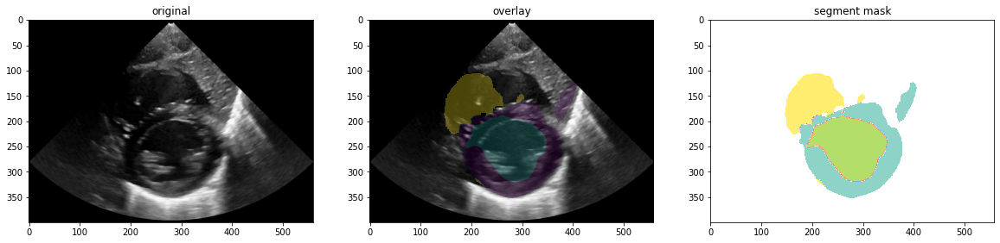

--> Frame 30:
	lv: cnt=4990, area_of_total=3.4%
	rv: cnt=9250, area_of_total=6.3%
	lv-o: cnt=12523, area_of_total=8.5%
	 ==> combined:  cnt=26763, area_of_total=18.1%
	 ==> lv+rv:  cnt=26763, area_of_total=9.7%


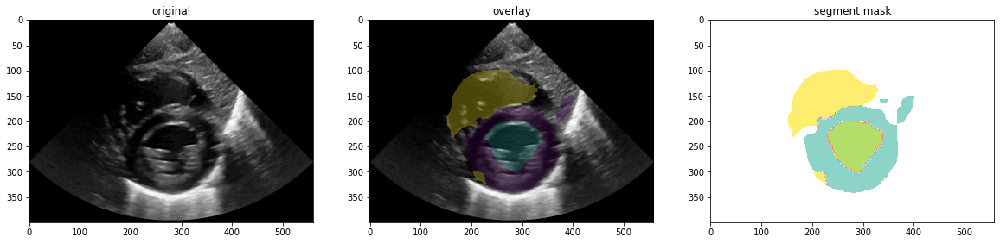

--> Frame 32:
	lv: cnt=4516, area_of_total=3.1%
	rv: cnt=7250, area_of_total=4.9%
	lv-o: cnt=12268, area_of_total=8.3%
	 ==> combined:  cnt=24034, area_of_total=16.3%
	 ==> lv+rv:  cnt=24034, area_of_total=8.0%


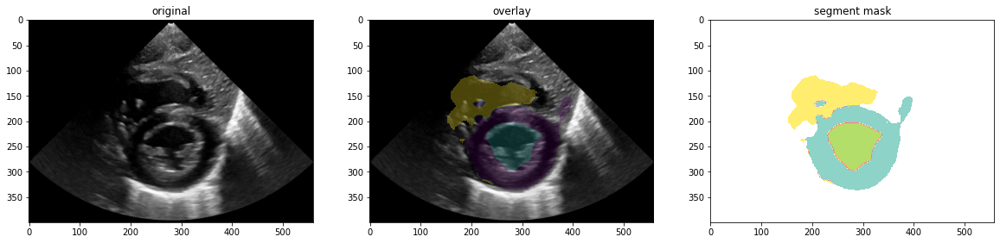

--> Frame 34:
	lv: cnt=8786, area_of_total=6.0%
	rv: cnt=6108, area_of_total=4.1%
	lv-o: cnt=9967, area_of_total=6.8%
	 ==> combined:  cnt=24861, area_of_total=16.9%
	 ==> lv+rv:  cnt=24861, area_of_total=10.1%


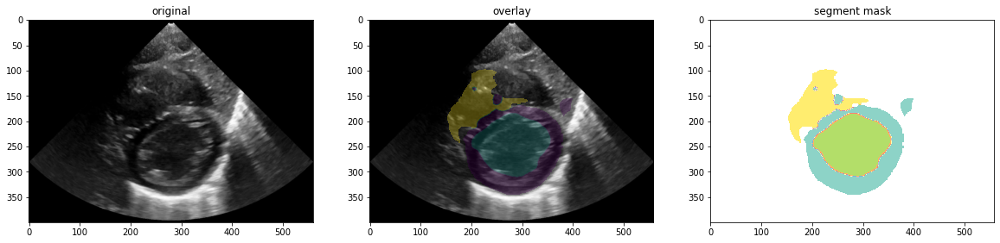

--> Frame 36:
	lv: cnt=8720, area_of_total=5.9%
	rv: cnt=6349, area_of_total=4.3%
	lv-o: cnt=10200, area_of_total=6.9%
	 ==> combined:  cnt=25269, area_of_total=17.1%
	 ==> lv+rv:  cnt=25269, area_of_total=10.2%


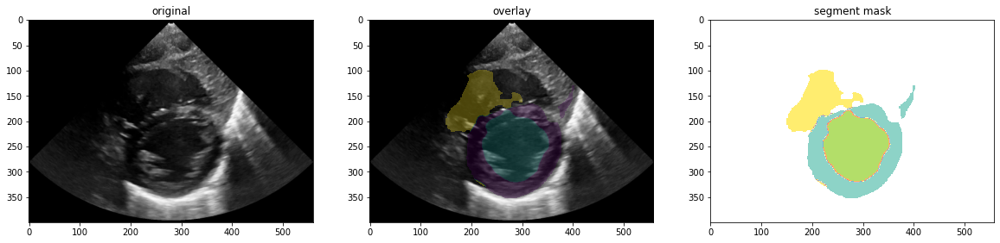

--> Frame 38:
	lv: cnt=6825, area_of_total=4.6%
	rv: cnt=7718, area_of_total=5.2%
	lv-o: cnt=11686, area_of_total=7.9%
	 ==> combined:  cnt=26229, area_of_total=17.8%
	 ==> lv+rv:  cnt=26229, area_of_total=9.9%


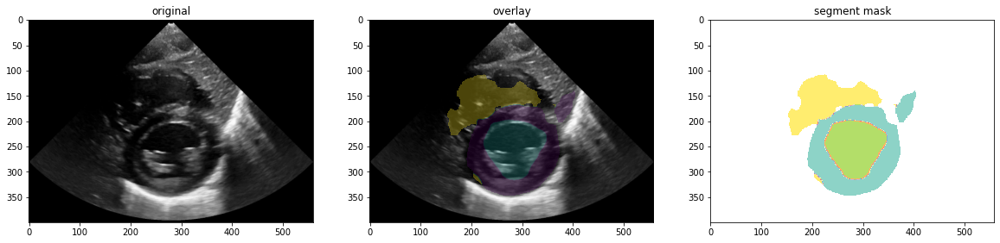

--> Frame 40:
	lv: cnt=5208, area_of_total=3.5%
	rv: cnt=9609, area_of_total=6.5%
	lv-o: cnt=13157, area_of_total=8.9%
	 ==> combined:  cnt=27974, area_of_total=19.0%
	 ==> lv+rv:  cnt=27974, area_of_total=10.0%


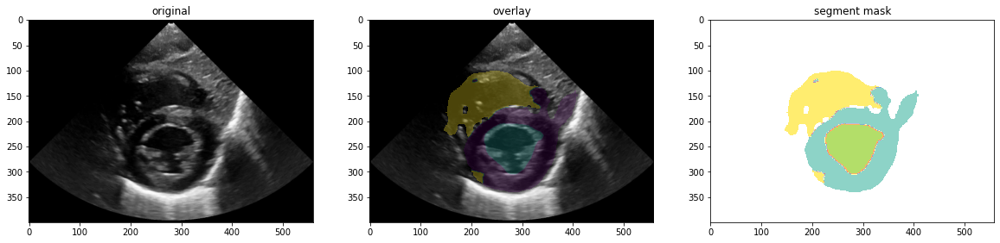

--> Frame 42:
	lv: cnt=4835, area_of_total=3.3%
	rv: cnt=9283, area_of_total=6.3%
	lv-o: cnt=13175, area_of_total=8.9%
	 ==> combined:  cnt=27293, area_of_total=18.5%
	 ==> lv+rv:  cnt=27293, area_of_total=9.6%


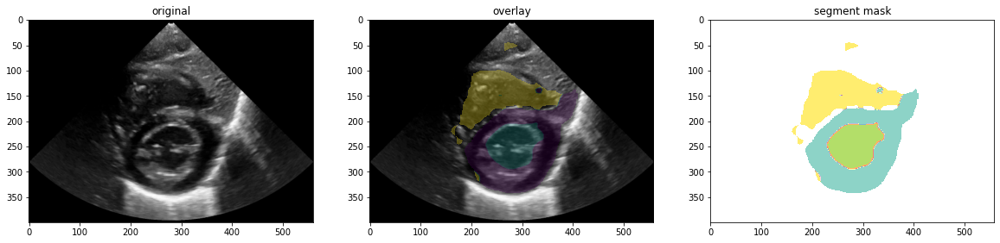

--> Frame 44:
	lv: cnt=9430, area_of_total=6.4%
	rv: cnt=7726, area_of_total=5.2%
	lv-o: cnt=11292, area_of_total=7.7%
	 ==> combined:  cnt=28448, area_of_total=19.3%
	 ==> lv+rv:  cnt=28448, area_of_total=11.6%


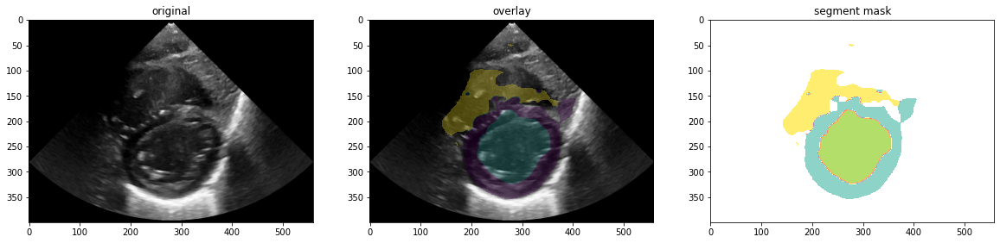

--> Frame 46:
	lv: cnt=7984, area_of_total=5.4%
	rv: cnt=8751, area_of_total=5.9%
	lv-o: cnt=11665, area_of_total=7.9%
	 ==> combined:  cnt=28400, area_of_total=19.3%
	 ==> lv+rv:  cnt=28400, area_of_total=11.3%


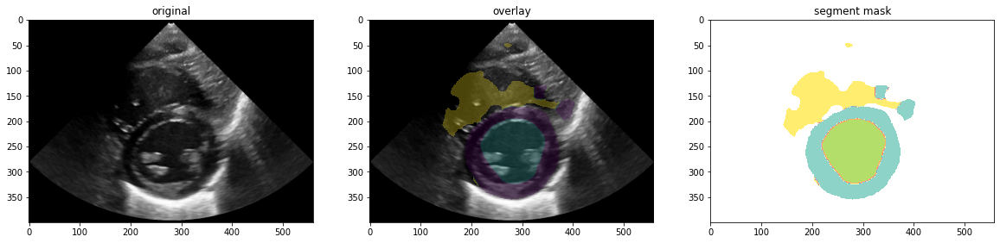

--> Frame 48:
	lv: cnt=6015, area_of_total=4.1%
	rv: cnt=8752, area_of_total=5.9%
	lv-o: cnt=12418, area_of_total=8.4%
	 ==> combined:  cnt=27185, area_of_total=18.4%
	 ==> lv+rv:  cnt=27185, area_of_total=10.0%


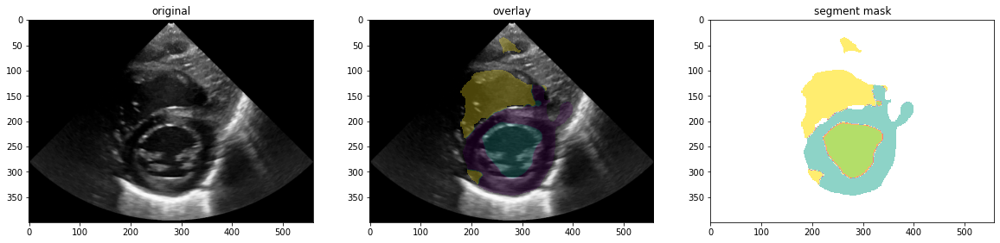

In [22]:
# NON-PH (but with some other) - 97 KAPAP
video, segm_mask, labels = get_data(videos_dir, '97KAPAP')
visualise(video, segm_mask, labels)

--> Frame 0:
	lv: cnt=8611, area_of_total=5.8%
	rv: cnt=5041, area_of_total=3.4%
	lv-o: cnt=9006, area_of_total=6.1%
	 ==> combined:  cnt=22658, area_of_total=15.4%
	 ==> lv+rv:  cnt=22658, area_of_total=9.3%


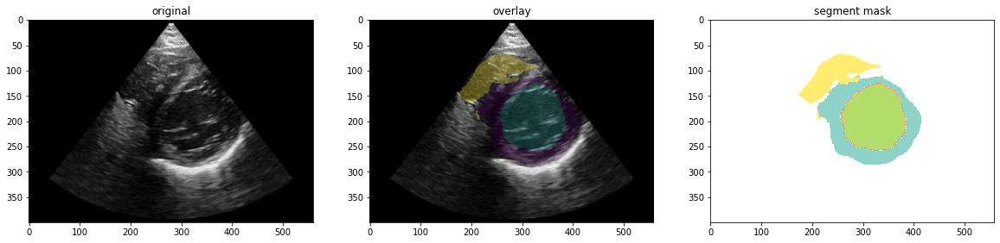

--> Frame 2:
	lv: cnt=6856, area_of_total=4.6%
	rv: cnt=4733, area_of_total=3.2%
	lv-o: cnt=9178, area_of_total=6.2%
	 ==> combined:  cnt=20767, area_of_total=14.1%
	 ==> lv+rv:  cnt=20767, area_of_total=7.9%


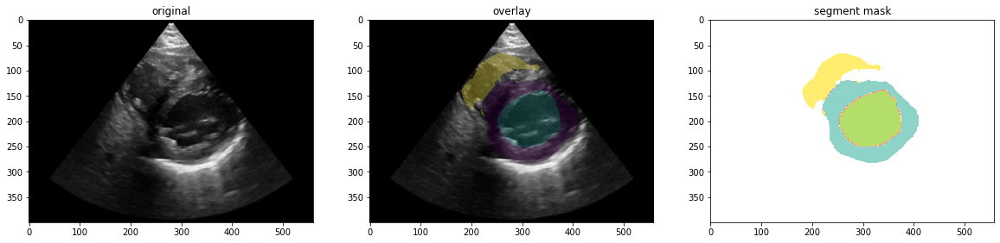

--> Frame 4:
	lv: cnt=4175, area_of_total=2.8%
	rv: cnt=4096, area_of_total=2.8%
	lv-o: cnt=7983, area_of_total=5.4%
	 ==> combined:  cnt=16254, area_of_total=11.0%
	 ==> lv+rv:  cnt=16254, area_of_total=5.6%


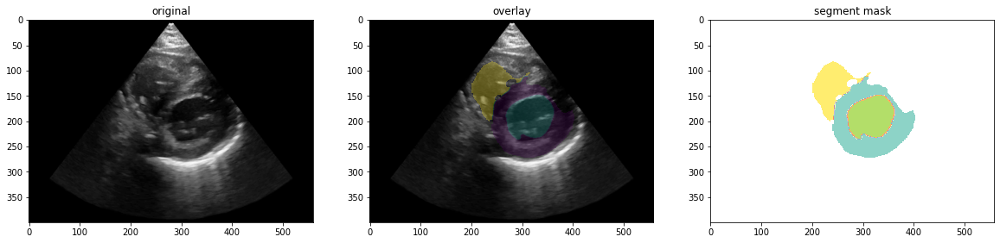

--> Frame 6:
	lv: cnt=3899, area_of_total=2.6%
	rv: cnt=4198, area_of_total=2.8%
	lv-o: cnt=6907, area_of_total=4.7%
	 ==> combined:  cnt=15004, area_of_total=10.2%
	 ==> lv+rv:  cnt=15004, area_of_total=5.5%


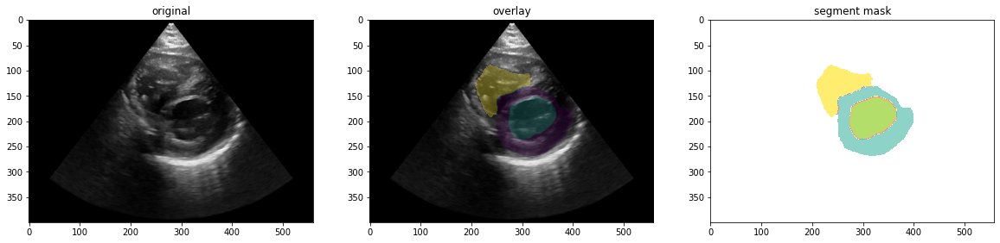

--> Frame 8:
	lv: cnt=3651, area_of_total=2.5%
	rv: cnt=3523, area_of_total=2.4%
	lv-o: cnt=8168, area_of_total=5.5%
	 ==> combined:  cnt=15342, area_of_total=10.4%
	 ==> lv+rv:  cnt=15342, area_of_total=4.9%


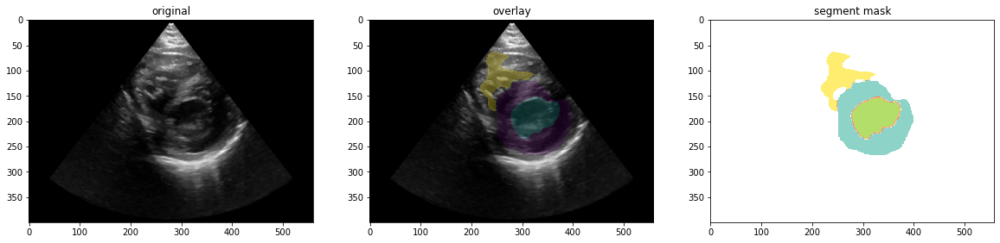

--> Frame 10:
	lv: cnt=3242, area_of_total=2.2%
	rv: cnt=4118, area_of_total=2.8%
	lv-o: cnt=9034, area_of_total=6.1%
	 ==> combined:  cnt=16394, area_of_total=11.1%
	 ==> lv+rv:  cnt=16394, area_of_total=5.0%


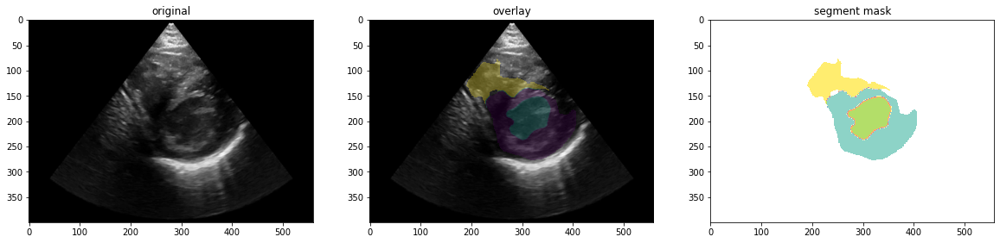

--> Frame 12:
	lv: cnt=4969, area_of_total=3.4%
	rv: cnt=4936, area_of_total=3.3%
	lv-o: cnt=8511, area_of_total=5.8%
	 ==> combined:  cnt=18416, area_of_total=12.5%
	 ==> lv+rv:  cnt=18416, area_of_total=6.7%


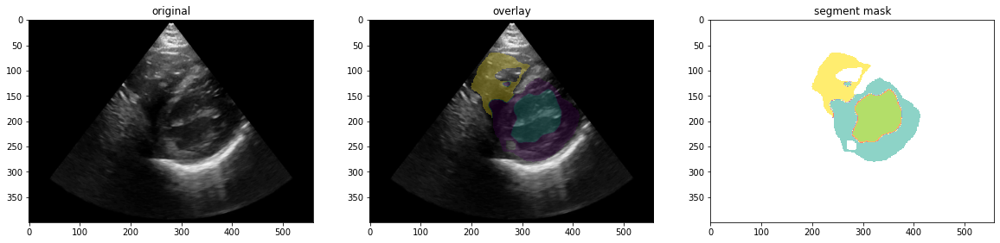

--> Frame 14:
	lv: cnt=7176, area_of_total=4.9%
	rv: cnt=6051, area_of_total=4.1%
	lv-o: cnt=7996, area_of_total=5.4%
	 ==> combined:  cnt=21223, area_of_total=14.4%
	 ==> lv+rv:  cnt=21223, area_of_total=9.0%


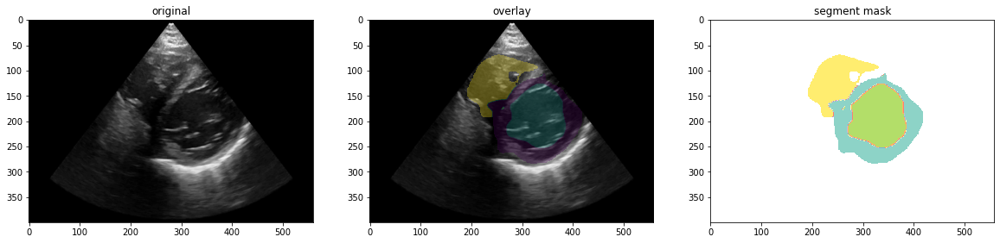

--> Frame 16:
	lv: cnt=5352, area_of_total=3.6%
	rv: cnt=4402, area_of_total=3.0%
	lv-o: cnt=8061, area_of_total=5.5%
	 ==> combined:  cnt=17815, area_of_total=12.1%
	 ==> lv+rv:  cnt=17815, area_of_total=6.6%


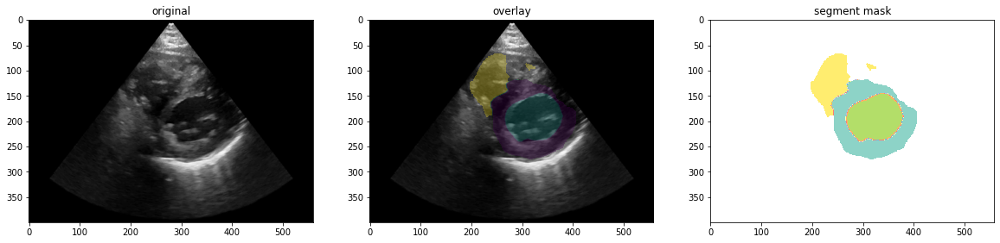

--> Frame 18:
	lv: cnt=3578, area_of_total=2.4%
	rv: cnt=3836, area_of_total=2.6%
	lv-o: cnt=7897, area_of_total=5.4%
	 ==> combined:  cnt=15311, area_of_total=10.4%
	 ==> lv+rv:  cnt=15311, area_of_total=5.0%


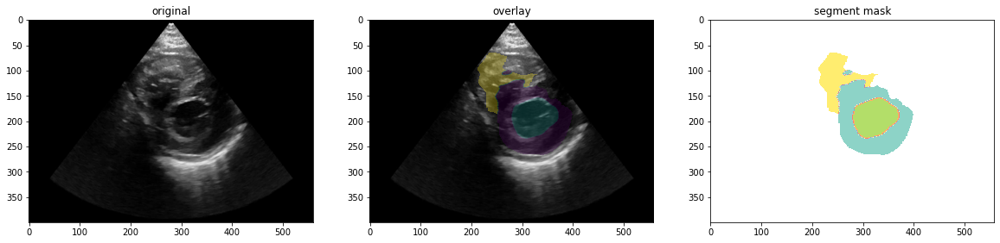

--> Frame 20:
	lv: cnt=2757, area_of_total=1.9%
	rv: cnt=2226, area_of_total=1.5%
	lv-o: cnt=9798, area_of_total=6.6%
	 ==> combined:  cnt=14781, area_of_total=10.0%
	 ==> lv+rv:  cnt=14781, area_of_total=3.4%


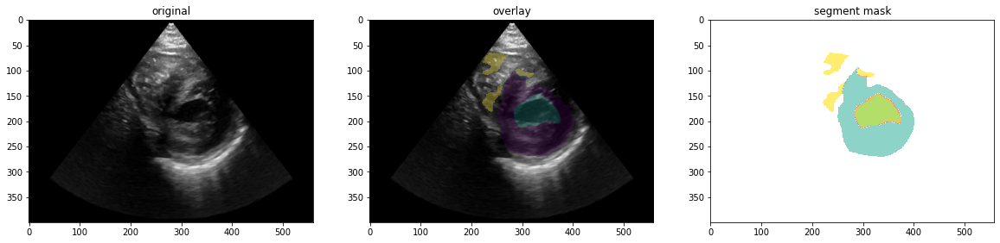

--> Frame 22:
	lv: cnt=5623, area_of_total=3.8%
	rv: cnt=2991, area_of_total=2.0%
	lv-o: cnt=9202, area_of_total=6.2%
	 ==> combined:  cnt=17816, area_of_total=12.1%
	 ==> lv+rv:  cnt=17816, area_of_total=5.8%


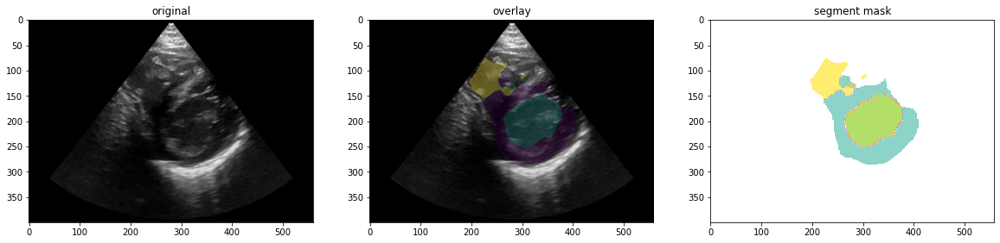

--> Frame 24:
	lv: cnt=6623, area_of_total=4.5%
	rv: cnt=3174, area_of_total=2.2%
	lv-o: cnt=10387, area_of_total=7.0%
	 ==> combined:  cnt=20184, area_of_total=13.7%
	 ==> lv+rv:  cnt=20184, area_of_total=6.6%


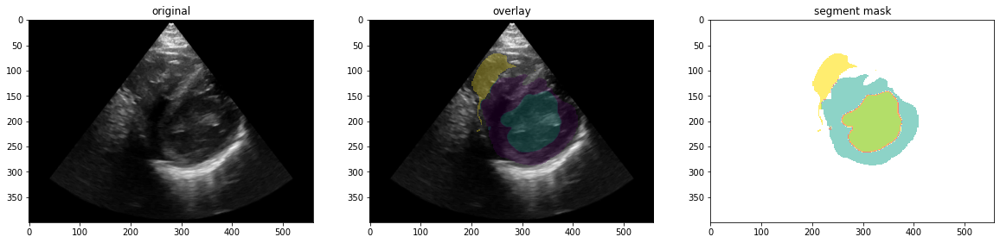

--> Frame 26:
	lv: cnt=7622, area_of_total=5.2%
	rv: cnt=4691, area_of_total=3.2%
	lv-o: cnt=9349, area_of_total=6.3%
	 ==> combined:  cnt=21662, area_of_total=14.7%
	 ==> lv+rv:  cnt=21662, area_of_total=8.4%


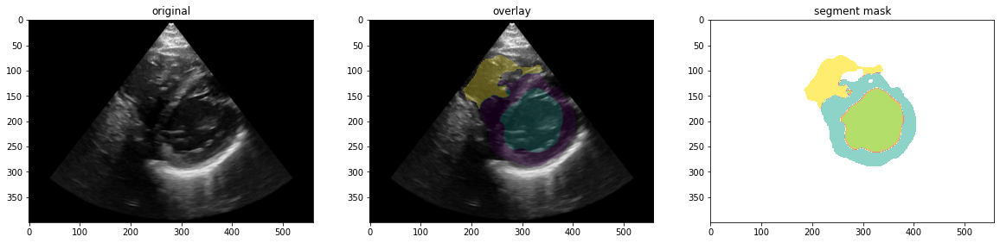

--> Frame 28:
	lv: cnt=5542, area_of_total=3.8%
	rv: cnt=5110, area_of_total=3.5%
	lv-o: cnt=8553, area_of_total=5.8%
	 ==> combined:  cnt=19205, area_of_total=13.0%
	 ==> lv+rv:  cnt=19205, area_of_total=7.2%


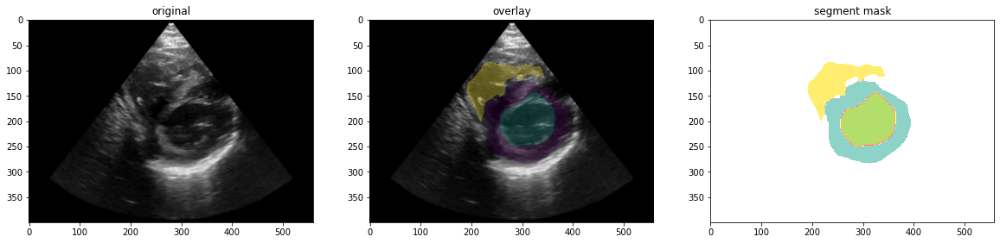

--> Frame 30:
	lv: cnt=3426, area_of_total=2.3%
	rv: cnt=4504, area_of_total=3.1%
	lv-o: cnt=7933, area_of_total=5.4%
	 ==> combined:  cnt=15863, area_of_total=10.8%
	 ==> lv+rv:  cnt=15863, area_of_total=5.4%


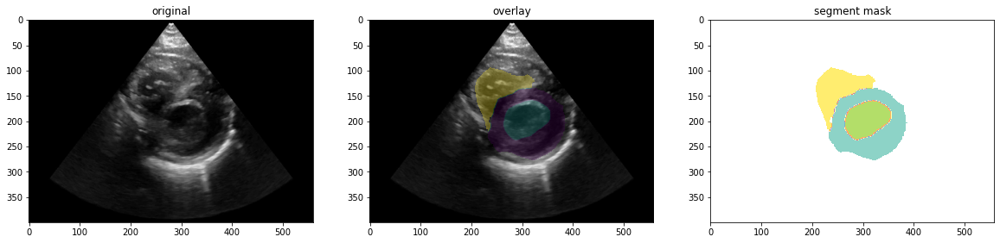

--> Frame 32:
	lv: cnt=2579, area_of_total=1.7%
	rv: cnt=5181, area_of_total=3.5%
	lv-o: cnt=10741, area_of_total=7.3%
	 ==> combined:  cnt=18501, area_of_total=12.5%
	 ==> lv+rv:  cnt=18501, area_of_total=5.3%


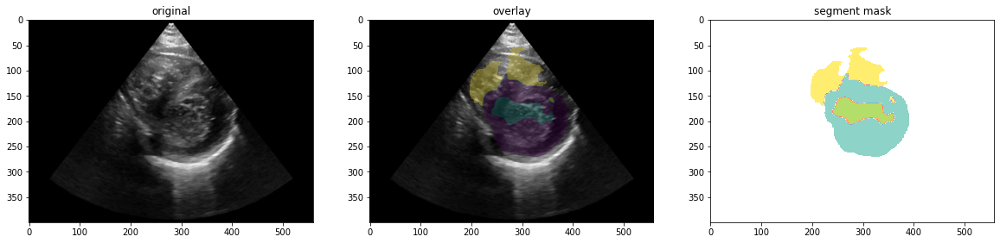

--> Frame 34:
	lv: cnt=6126, area_of_total=4.2%
	rv: cnt=4543, area_of_total=3.1%
	lv-o: cnt=9230, area_of_total=6.3%
	 ==> combined:  cnt=19899, area_of_total=13.5%
	 ==> lv+rv:  cnt=19899, area_of_total=7.2%


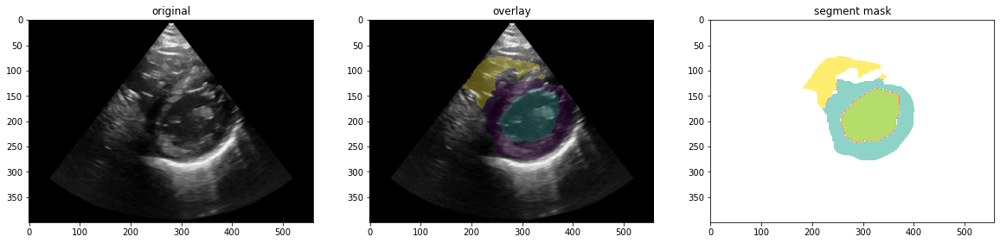

--> Frame 36:
	lv: cnt=8039, area_of_total=5.5%
	rv: cnt=4397, area_of_total=3.0%
	lv-o: cnt=8671, area_of_total=5.9%
	 ==> combined:  cnt=21107, area_of_total=14.3%
	 ==> lv+rv:  cnt=21107, area_of_total=8.4%


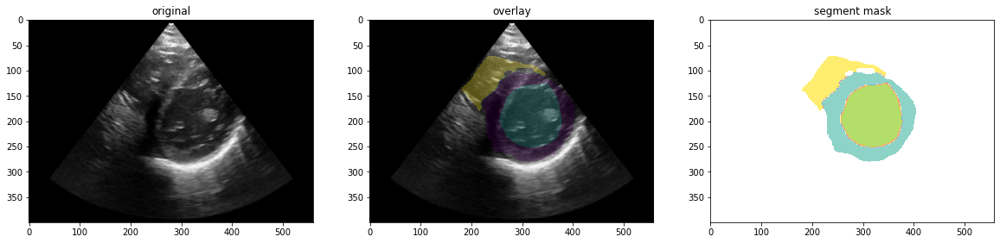

--> Frame 38:
	lv: cnt=6408, area_of_total=4.3%
	rv: cnt=4176, area_of_total=2.8%
	lv-o: cnt=9112, area_of_total=6.2%
	 ==> combined:  cnt=19696, area_of_total=13.4%
	 ==> lv+rv:  cnt=19696, area_of_total=7.2%


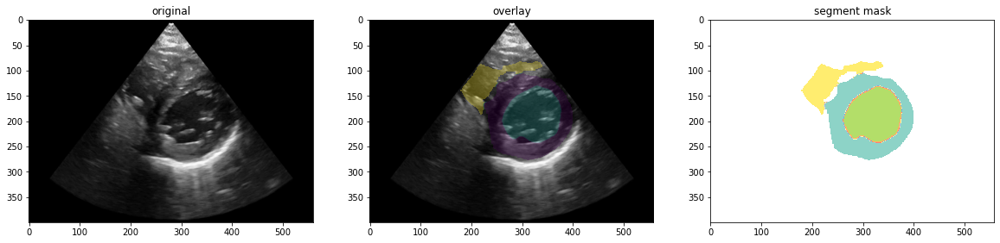

--> Frame 40:
	lv: cnt=4420, area_of_total=3.0%
	rv: cnt=3046, area_of_total=2.1%
	lv-o: cnt=8239, area_of_total=5.6%
	 ==> combined:  cnt=15705, area_of_total=10.7%
	 ==> lv+rv:  cnt=15705, area_of_total=5.1%


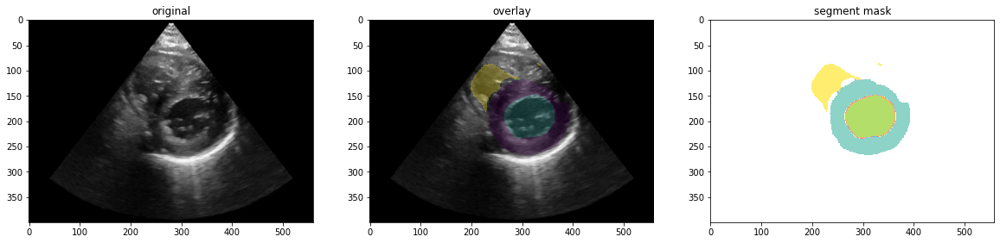

--> Frame 42:
	lv: cnt=3441, area_of_total=2.3%
	rv: cnt=2691, area_of_total=1.8%
	lv-o: cnt=8945, area_of_total=6.1%
	 ==> combined:  cnt=15077, area_of_total=10.2%
	 ==> lv+rv:  cnt=15077, area_of_total=4.2%


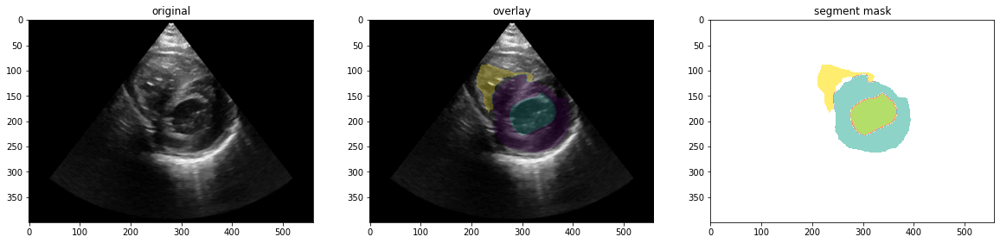

--> Frame 44:
	lv: cnt=1919, area_of_total=1.3%
	rv: cnt=2674, area_of_total=1.8%
	lv-o: cnt=10881, area_of_total=7.4%
	 ==> combined:  cnt=15474, area_of_total=10.5%
	 ==> lv+rv:  cnt=15474, area_of_total=3.1%


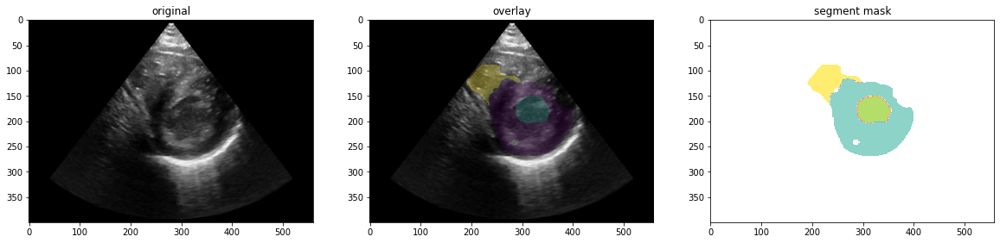

--> Frame 46:
	lv: cnt=6787, area_of_total=4.6%
	rv: cnt=4481, area_of_total=3.0%
	lv-o: cnt=9096, area_of_total=6.2%
	 ==> combined:  cnt=20364, area_of_total=13.8%
	 ==> lv+rv:  cnt=20364, area_of_total=7.6%


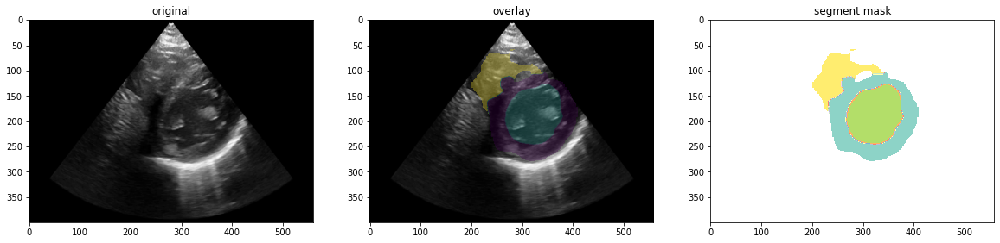

--> Frame 48:
	lv: cnt=7849, area_of_total=5.3%
	rv: cnt=4823, area_of_total=3.3%
	lv-o: cnt=8949, area_of_total=6.1%
	 ==> combined:  cnt=21621, area_of_total=14.7%
	 ==> lv+rv:  cnt=21621, area_of_total=8.6%


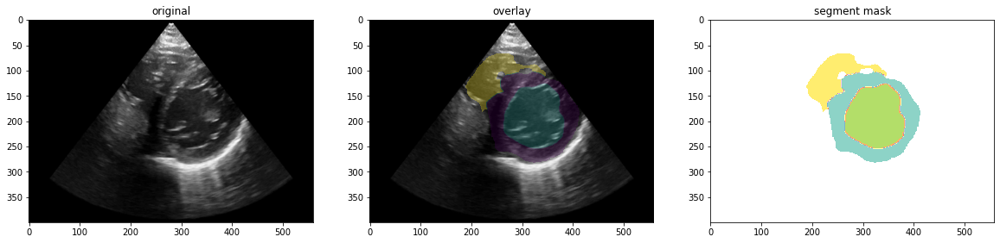

In [23]:
# HEALTHY - 101 KAPAP
video, segm_mask, labels = get_data(videos_dir, '101KAPAP')
visualise(video, segm_mask, labels)

--> Frame 0:
	lv: cnt=1855, area_of_total=1.3%
	rv: cnt=2234, area_of_total=1.5%
	lv-o: cnt=11701, area_of_total=7.9%
	 ==> combined:  cnt=15790, area_of_total=10.7%
	 ==> lv+rv:  cnt=15790, area_of_total=2.8%


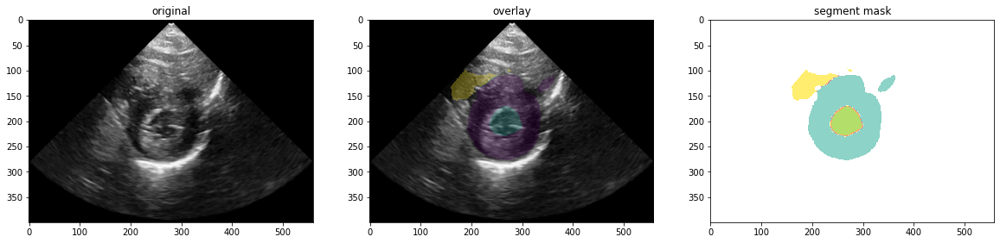

--> Frame 2:
	lv: cnt=2038, area_of_total=1.4%
	rv: cnt=2667, area_of_total=1.8%
	lv-o: cnt=11567, area_of_total=7.8%
	 ==> combined:  cnt=16272, area_of_total=11.0%
	 ==> lv+rv:  cnt=16272, area_of_total=3.2%


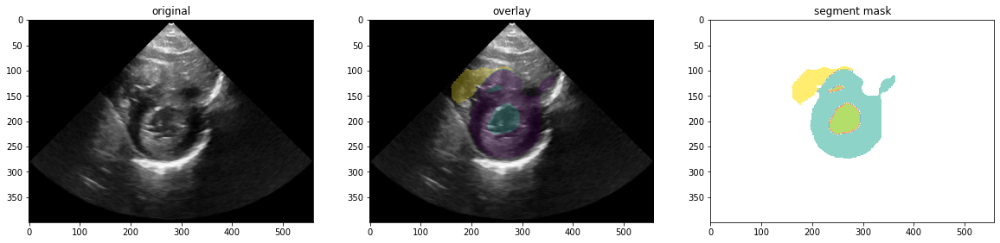

--> Frame 4:
	lv: cnt=2036, area_of_total=1.4%
	rv: cnt=2660, area_of_total=1.8%
	lv-o: cnt=11561, area_of_total=7.8%
	 ==> combined:  cnt=16257, area_of_total=11.0%
	 ==> lv+rv:  cnt=16257, area_of_total=3.2%


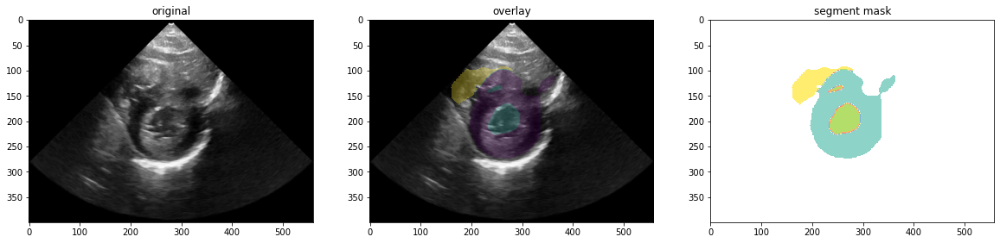

--> Frame 6:
	lv: cnt=3184, area_of_total=2.2%
	rv: cnt=3337, area_of_total=2.3%
	lv-o: cnt=11076, area_of_total=7.5%
	 ==> combined:  cnt=17597, area_of_total=11.9%
	 ==> lv+rv:  cnt=17597, area_of_total=4.4%


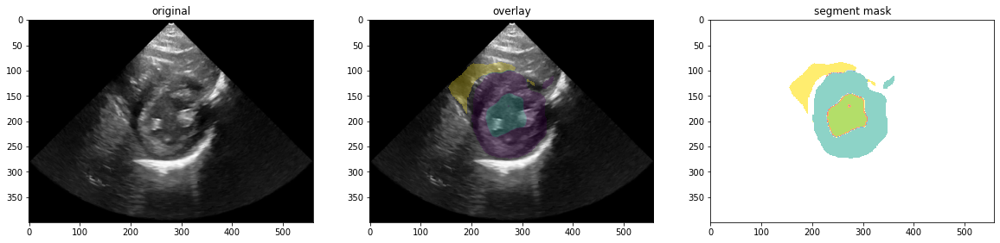

--> Frame 8:
	lv: cnt=5756, area_of_total=3.9%
	rv: cnt=3437, area_of_total=2.3%
	lv-o: cnt=9369, area_of_total=6.4%
	 ==> combined:  cnt=18562, area_of_total=12.6%
	 ==> lv+rv:  cnt=18562, area_of_total=6.2%


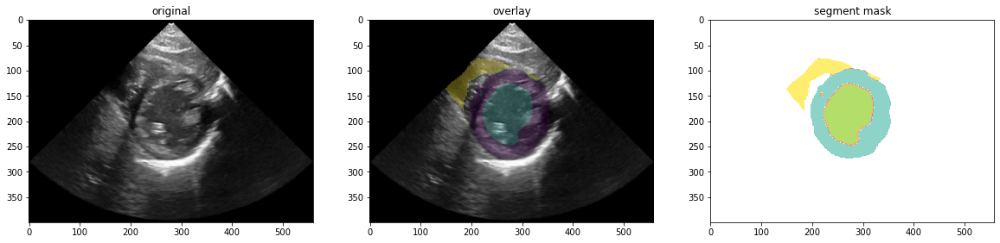

--> Frame 10:
	lv: cnt=4535, area_of_total=3.1%
	rv: cnt=3755, area_of_total=2.5%
	lv-o: cnt=9960, area_of_total=6.8%
	 ==> combined:  cnt=18250, area_of_total=12.4%
	 ==> lv+rv:  cnt=18250, area_of_total=5.6%


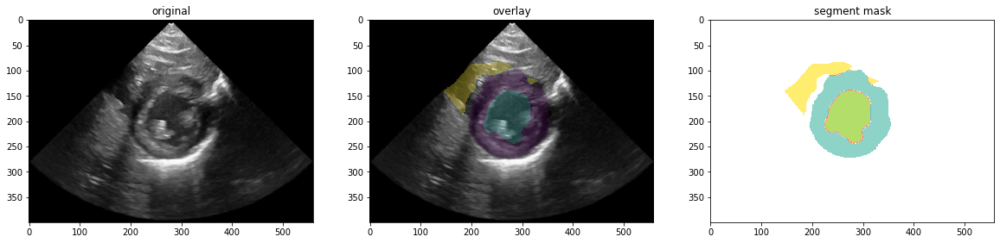

--> Frame 12:
	lv: cnt=2002, area_of_total=1.4%
	rv: cnt=1948, area_of_total=1.3%
	lv-o: cnt=11668, area_of_total=7.9%
	 ==> combined:  cnt=15618, area_of_total=10.6%
	 ==> lv+rv:  cnt=15618, area_of_total=2.7%


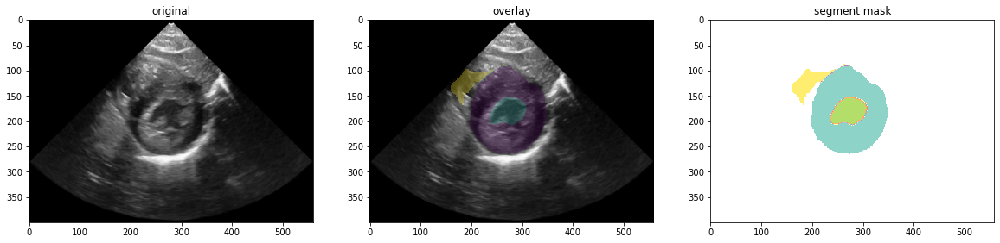

--> Frame 14:
	lv: cnt=1756, area_of_total=1.2%
	rv: cnt=1962, area_of_total=1.3%
	lv-o: cnt=11720, area_of_total=7.9%
	 ==> combined:  cnt=15438, area_of_total=10.5%
	 ==> lv+rv:  cnt=15438, area_of_total=2.5%


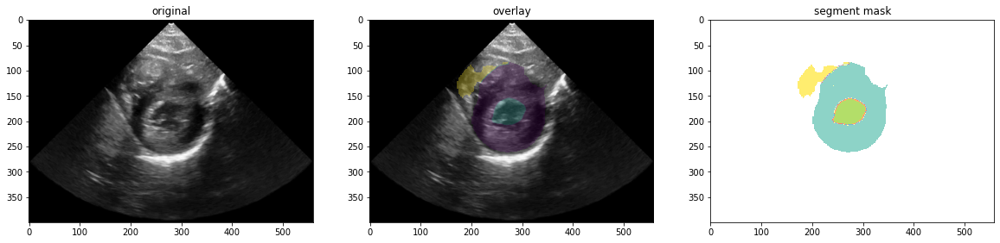

--> Frame 16:
	lv: cnt=1010, area_of_total=0.7%
	rv: cnt=4170, area_of_total=2.8%
	lv-o: cnt=12019, area_of_total=8.2%
	 ==> combined:  cnt=17199, area_of_total=11.7%
	 ==> lv+rv:  cnt=17199, area_of_total=3.5%


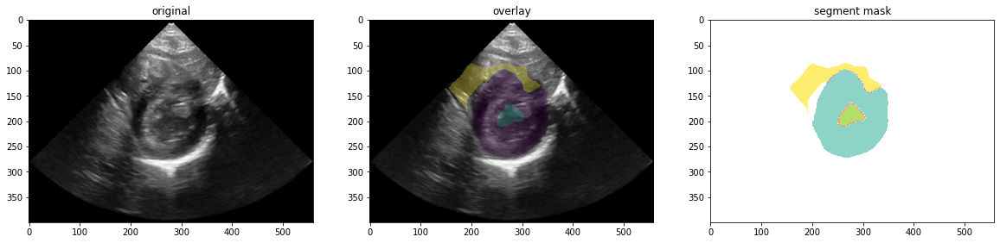

--> Frame 18:
	lv: cnt=3190, area_of_total=2.2%
	rv: cnt=3811, area_of_total=2.6%
	lv-o: cnt=12191, area_of_total=8.3%
	 ==> combined:  cnt=19192, area_of_total=13.0%
	 ==> lv+rv:  cnt=19192, area_of_total=4.7%


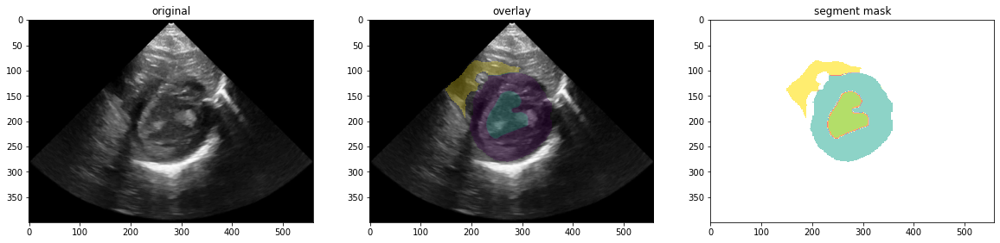

--> Frame 20:
	lv: cnt=5315, area_of_total=3.6%
	rv: cnt=4533, area_of_total=3.1%
	lv-o: cnt=10273, area_of_total=7.0%
	 ==> combined:  cnt=20121, area_of_total=13.6%
	 ==> lv+rv:  cnt=20121, area_of_total=6.7%


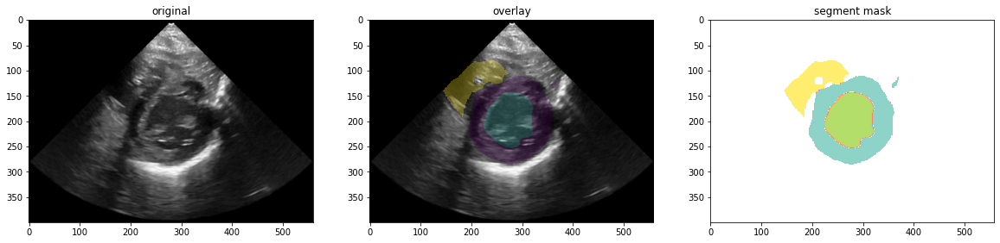

--> Frame 22:
	lv: cnt=3647, area_of_total=2.5%
	rv: cnt=2730, area_of_total=1.9%
	lv-o: cnt=10648, area_of_total=7.2%
	 ==> combined:  cnt=17025, area_of_total=11.5%
	 ==> lv+rv:  cnt=17025, area_of_total=4.3%


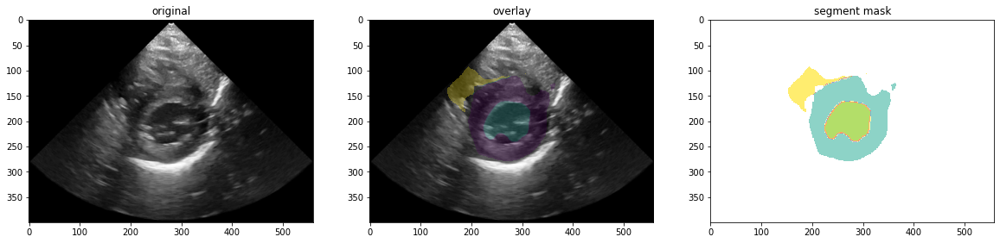

--> Frame 24:
	lv: cnt=2667, area_of_total=1.8%
	rv: cnt=3343, area_of_total=2.3%
	lv-o: cnt=10776, area_of_total=7.3%
	 ==> combined:  cnt=16786, area_of_total=11.4%
	 ==> lv+rv:  cnt=16786, area_of_total=4.1%


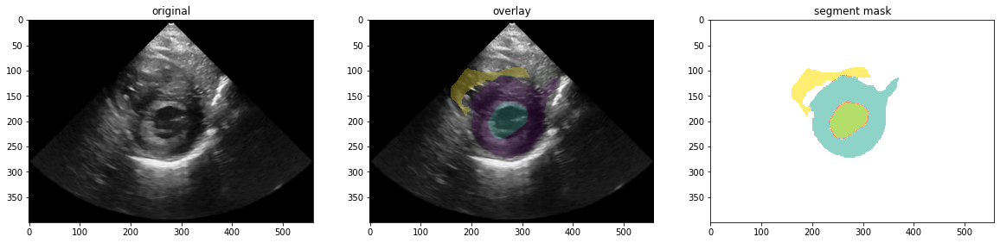

--> Frame 26:
	lv: cnt=1549, area_of_total=1.1%
	rv: cnt=3332, area_of_total=2.3%
	lv-o: cnt=11807, area_of_total=8.0%
	 ==> combined:  cnt=16688, area_of_total=11.3%
	 ==> lv+rv:  cnt=16688, area_of_total=3.3%


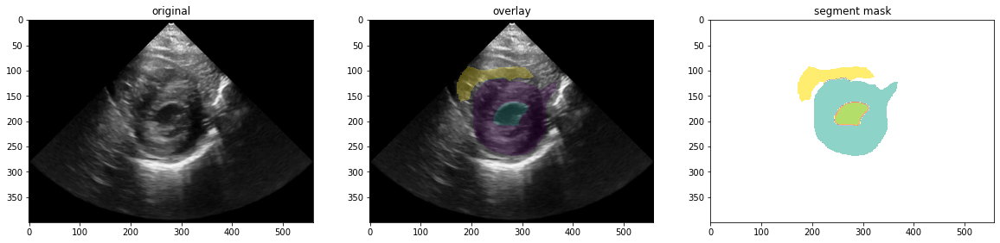

--> Frame 28:
	lv: cnt=1957, area_of_total=1.3%
	rv: cnt=2956, area_of_total=2.0%
	lv-o: cnt=12537, area_of_total=8.5%
	 ==> combined:  cnt=17450, area_of_total=11.8%
	 ==> lv+rv:  cnt=17450, area_of_total=3.3%


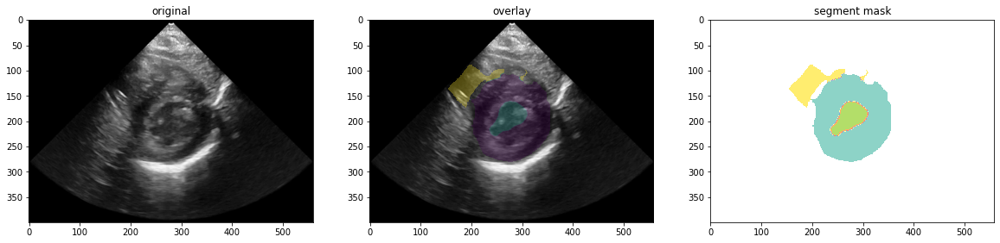

--> Frame 30:
	lv: cnt=4277, area_of_total=2.9%
	rv: cnt=4405, area_of_total=3.0%
	lv-o: cnt=10900, area_of_total=7.4%
	 ==> combined:  cnt=19582, area_of_total=13.3%
	 ==> lv+rv:  cnt=19582, area_of_total=5.9%


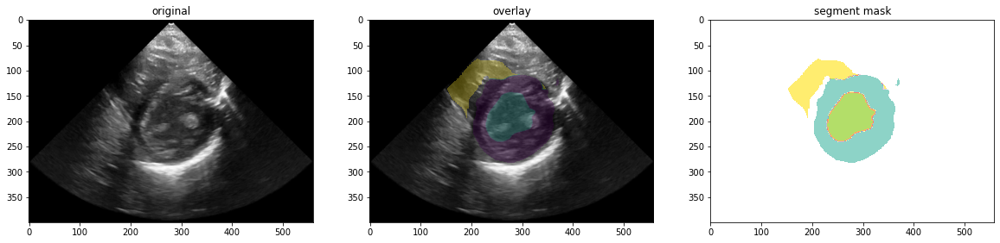

--> Frame 32:
	lv: cnt=4769, area_of_total=3.2%
	rv: cnt=4147, area_of_total=2.8%
	lv-o: cnt=10469, area_of_total=7.1%
	 ==> combined:  cnt=19385, area_of_total=13.1%
	 ==> lv+rv:  cnt=19385, area_of_total=6.0%


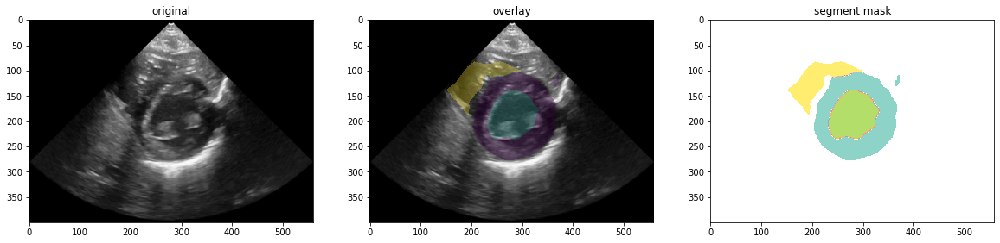

--> Frame 34:
	lv: cnt=2214, area_of_total=1.5%
	rv: cnt=3099, area_of_total=2.1%
	lv-o: cnt=10909, area_of_total=7.4%
	 ==> combined:  cnt=16222, area_of_total=11.0%
	 ==> lv+rv:  cnt=16222, area_of_total=3.6%


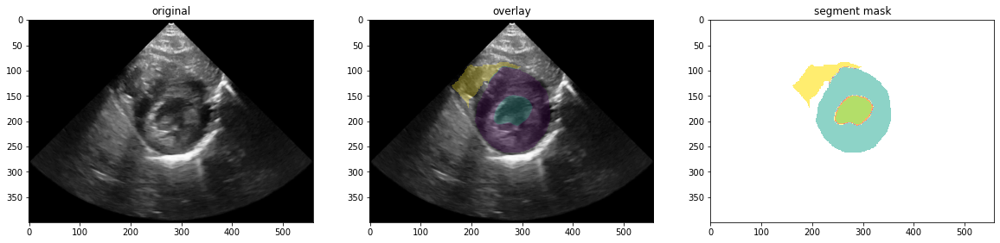

--> Frame 36:
	lv: cnt=1014, area_of_total=0.7%
	rv: cnt=1943, area_of_total=1.3%
	lv-o: cnt=11908, area_of_total=8.1%
	 ==> combined:  cnt=14865, area_of_total=10.1%
	 ==> lv+rv:  cnt=14865, area_of_total=2.0%


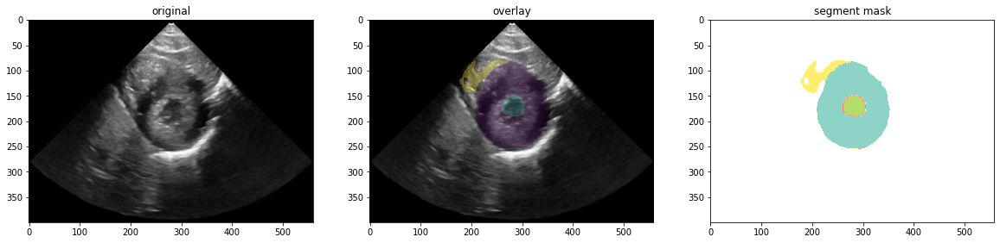

--> Frame 38:
	lv: cnt=1482, area_of_total=1.0%
	rv: cnt=2226, area_of_total=1.5%
	lv-o: cnt=12308, area_of_total=8.3%
	 ==> combined:  cnt=16016, area_of_total=10.9%
	 ==> lv+rv:  cnt=16016, area_of_total=2.5%


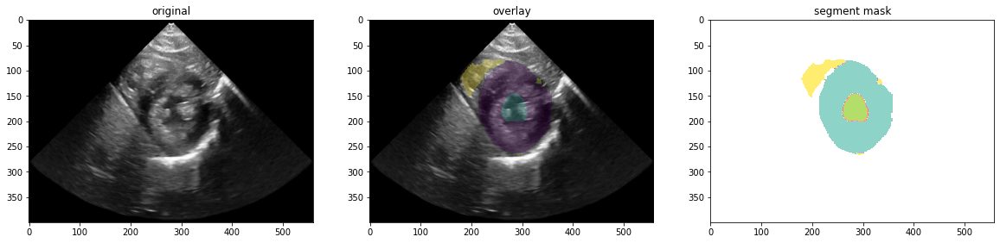

--> Frame 40:
	lv: cnt=3202, area_of_total=2.2%
	rv: cnt=3054, area_of_total=2.1%
	lv-o: cnt=10558, area_of_total=7.2%
	 ==> combined:  cnt=16814, area_of_total=11.4%
	 ==> lv+rv:  cnt=16814, area_of_total=4.2%


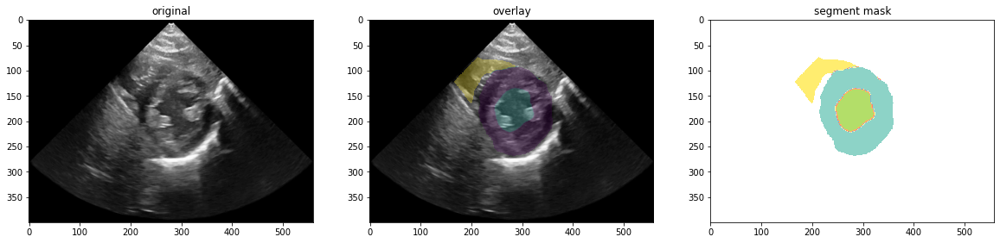

--> Frame 42:
	lv: cnt=4159, area_of_total=2.8%
	rv: cnt=2593, area_of_total=1.8%
	lv-o: cnt=10595, area_of_total=7.2%
	 ==> combined:  cnt=17347, area_of_total=11.8%
	 ==> lv+rv:  cnt=17347, area_of_total=4.6%


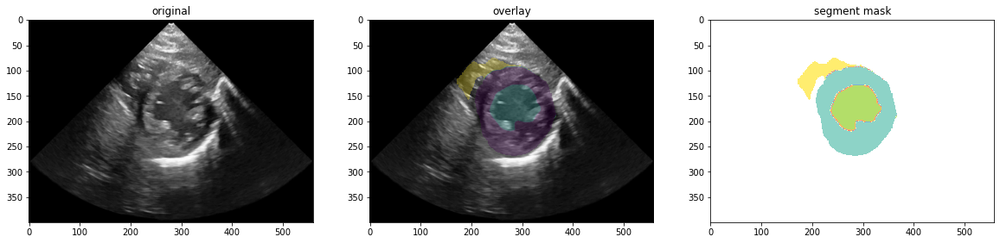

--> Frame 44:
	lv: cnt=4115, area_of_total=2.8%
	rv: cnt=3731, area_of_total=2.5%
	lv-o: cnt=9879, area_of_total=6.7%
	 ==> combined:  cnt=17725, area_of_total=12.0%
	 ==> lv+rv:  cnt=17725, area_of_total=5.3%


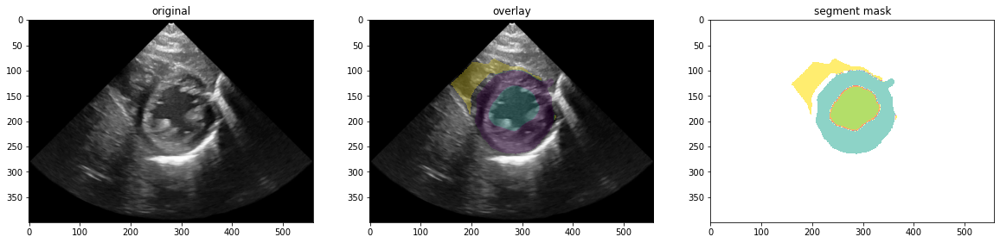

--> Frame 46:
	lv: cnt=2179, area_of_total=1.5%
	rv: cnt=3183, area_of_total=2.2%
	lv-o: cnt=10461, area_of_total=7.1%
	 ==> combined:  cnt=15823, area_of_total=10.7%
	 ==> lv+rv:  cnt=15823, area_of_total=3.6%


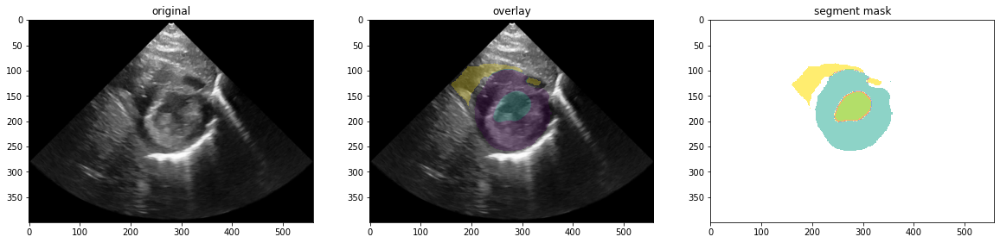

--> Frame 48:
	lv: cnt=1166, area_of_total=0.8%
	rv: cnt=2446, area_of_total=1.7%
	lv-o: cnt=11519, area_of_total=7.8%
	 ==> combined:  cnt=15131, area_of_total=10.3%
	 ==> lv+rv:  cnt=15131, area_of_total=2.4%


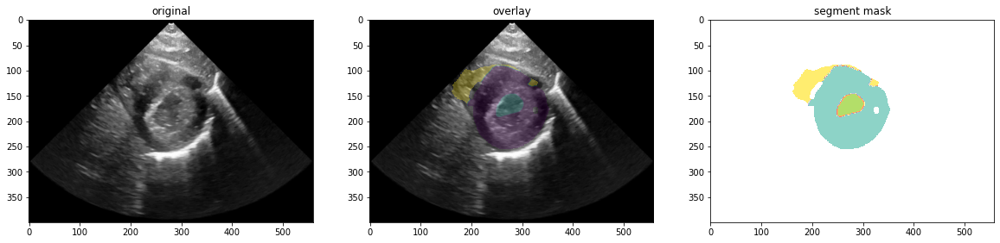

In [24]:
# HEALTHY - 101 KAPAP ==> Try the KAAP view instead (!)
video, segm_mask, labels = get_data(videos_dir, '101KAAP')
visualise(video, segm_mask, labels)

{'lv': 1, 'ivs': 2, 'la': 3, 'rv': 4, 'pm': 5, 'aor': 6}
--> Frame 0:
	lv: cnt=5138, area_of_total=3.5%
	ivs: cnt=7372, area_of_total=5.0%
	la: cnt=958, area_of_total=0.6%
	rv: cnt=4192, area_of_total=2.8%
	pm: cnt=1584, area_of_total=1.1%
	aor: cnt=5521, area_of_total=3.7%
	 ==> combined:  cnt=24765, area_of_total=16.8%
	 ==> lv+rv:  cnt=24765, area_of_total=6.3%


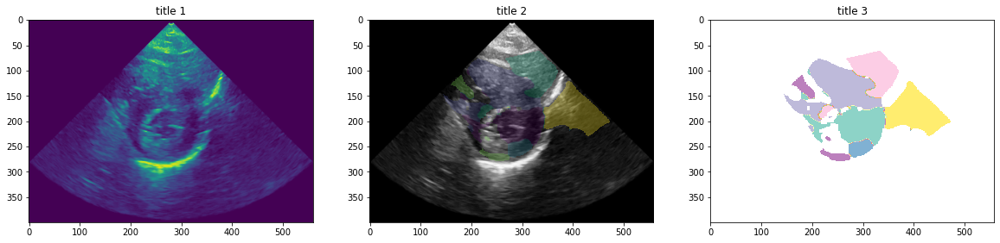

--> Frame 2:
	lv: cnt=3635, area_of_total=2.5%
	ivs: cnt=5752, area_of_total=3.9%
	la: cnt=2348, area_of_total=1.6%
	rv: cnt=3843, area_of_total=2.6%
	pm: cnt=864, area_of_total=0.6%
	aor: cnt=6833, area_of_total=4.6%
	 ==> combined:  cnt=23275, area_of_total=15.8%
	 ==> lv+rv:  cnt=23275, area_of_total=5.1%


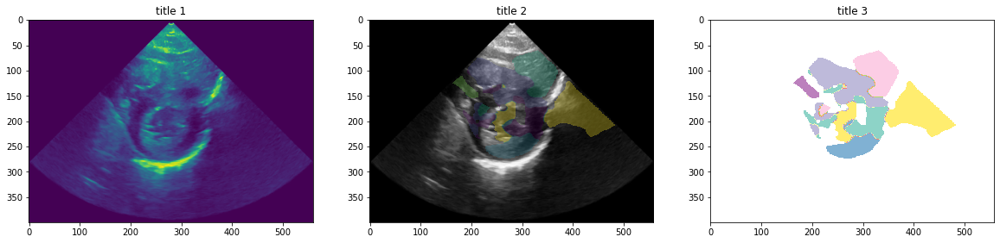

--> Frame 4:
	lv: cnt=3616, area_of_total=2.5%
	ivs: cnt=5746, area_of_total=3.9%
	la: cnt=2357, area_of_total=1.6%
	rv: cnt=3840, area_of_total=2.6%
	pm: cnt=866, area_of_total=0.6%
	aor: cnt=6820, area_of_total=4.6%
	 ==> combined:  cnt=23245, area_of_total=15.8%
	 ==> lv+rv:  cnt=23245, area_of_total=5.1%


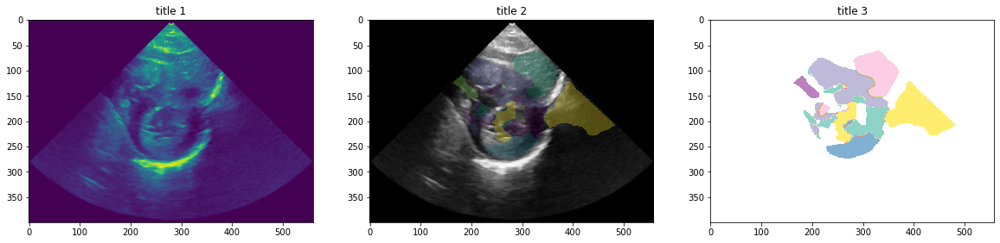

--> Frame 6:
	lv: cnt=2949, area_of_total=2.0%
	ivs: cnt=6816, area_of_total=4.6%
	la: cnt=3732, area_of_total=2.5%
	rv: cnt=3733, area_of_total=2.5%
	pm: cnt=2043, area_of_total=1.4%
	aor: cnt=3777, area_of_total=2.6%
	 ==> combined:  cnt=23050, area_of_total=15.6%
	 ==> lv+rv:  cnt=23050, area_of_total=4.5%


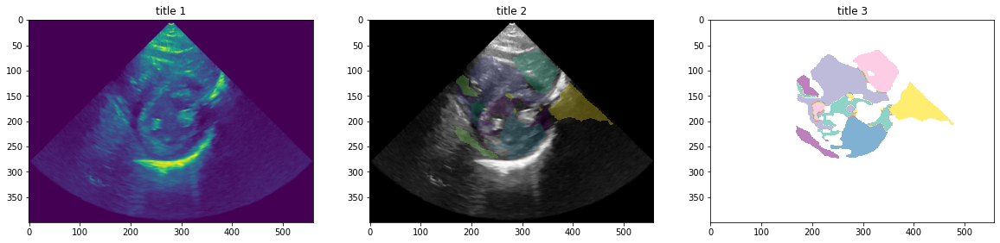

--> Frame 8:
	lv: cnt=5960, area_of_total=4.0%
	ivs: cnt=5121, area_of_total=3.5%
	la: cnt=37, area_of_total=0.0%
	rv: cnt=2942, area_of_total=2.0%
	pm: cnt=2577, area_of_total=1.7%
	aor: cnt=6166, area_of_total=4.2%
	 ==> combined:  cnt=22803, area_of_total=15.5%
	 ==> lv+rv:  cnt=22803, area_of_total=6.0%


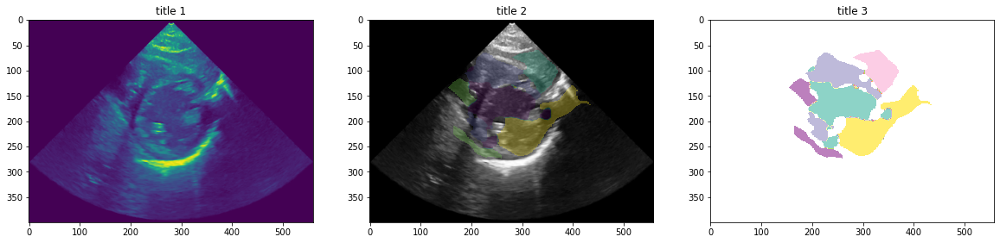

--> Frame 10:
	lv: cnt=2616, area_of_total=1.8%
	ivs: cnt=7445, area_of_total=5.0%
	la: cnt=697, area_of_total=0.5%
	rv: cnt=3104, area_of_total=2.1%
	pm: cnt=2275, area_of_total=1.5%
	aor: cnt=6477, area_of_total=4.4%
	 ==> combined:  cnt=22614, area_of_total=15.3%
	 ==> lv+rv:  cnt=22614, area_of_total=3.9%


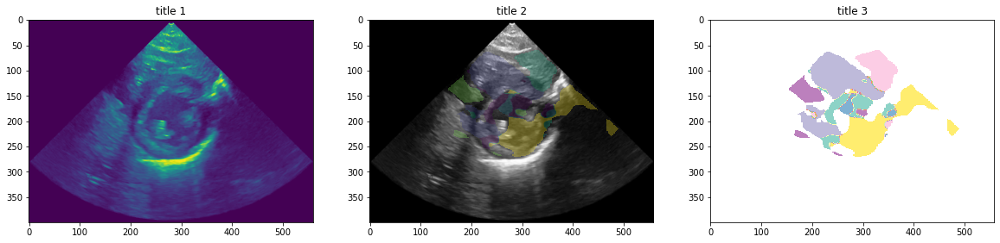

--> Frame 12:
	lv: cnt=3145, area_of_total=2.1%
	ivs: cnt=6775, area_of_total=4.6%
	la: cnt=1117, area_of_total=0.8%
	rv: cnt=3244, area_of_total=2.2%
	pm: cnt=1371, area_of_total=0.9%
	aor: cnt=5521, area_of_total=3.7%
	 ==> combined:  cnt=21173, area_of_total=14.4%
	 ==> lv+rv:  cnt=21173, area_of_total=4.3%


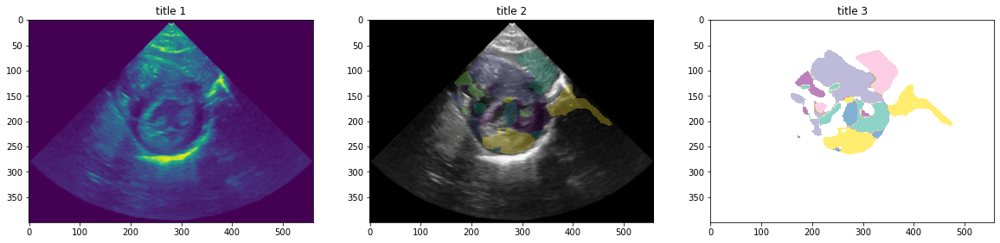

--> Frame 14:
	lv: cnt=3910, area_of_total=2.7%
	ivs: cnt=7065, area_of_total=4.8%
	la: cnt=838, area_of_total=0.6%
	rv: cnt=2700, area_of_total=1.8%
	pm: cnt=655, area_of_total=0.4%
	aor: cnt=7156, area_of_total=4.9%
	 ==> combined:  cnt=22324, area_of_total=15.1%
	 ==> lv+rv:  cnt=22324, area_of_total=4.5%


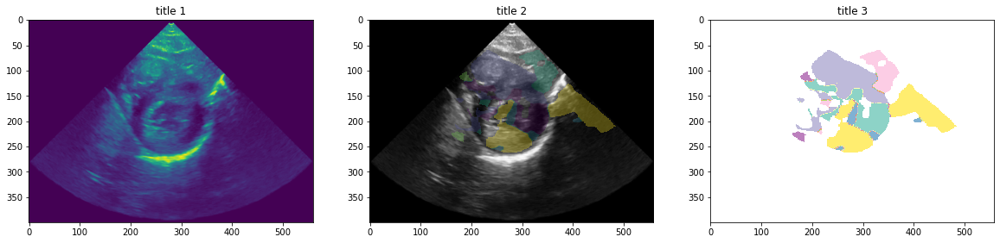

--> Frame 16:
	lv: cnt=3900, area_of_total=2.6%
	ivs: cnt=3938, area_of_total=2.7%
	la: cnt=1836, area_of_total=1.2%
	rv: cnt=4938, area_of_total=3.3%
	pm: cnt=2530, area_of_total=1.7%
	aor: cnt=3448, area_of_total=2.3%
	 ==> combined:  cnt=20590, area_of_total=14.0%
	 ==> lv+rv:  cnt=20590, area_of_total=6.0%


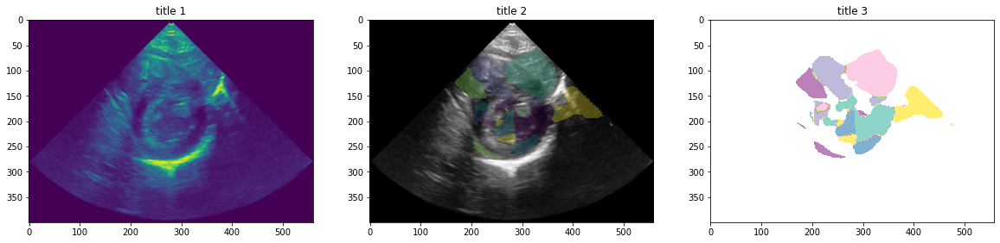

--> Frame 18:
	lv: cnt=4612, area_of_total=3.1%
	ivs: cnt=4354, area_of_total=3.0%
	la: cnt=5236, area_of_total=3.6%
	rv: cnt=4610, area_of_total=3.1%
	pm: cnt=2016, area_of_total=1.4%
	aor: cnt=2835, area_of_total=1.9%
	 ==> combined:  cnt=23663, area_of_total=16.0%
	 ==> lv+rv:  cnt=23663, area_of_total=6.3%


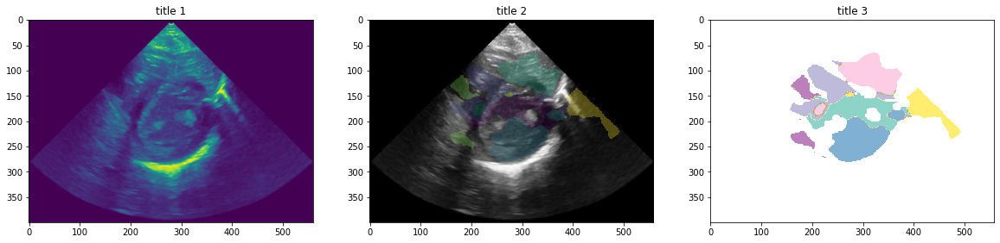

--> Frame 20:
	lv: cnt=8955, area_of_total=6.1%
	ivs: cnt=5668, area_of_total=3.8%
	la: cnt=1179, area_of_total=0.8%
	rv: cnt=4101, area_of_total=2.8%
	pm: cnt=4799, area_of_total=3.3%
	aor: cnt=3734, area_of_total=2.5%
	 ==> combined:  cnt=28436, area_of_total=19.3%
	 ==> lv+rv:  cnt=28436, area_of_total=8.9%


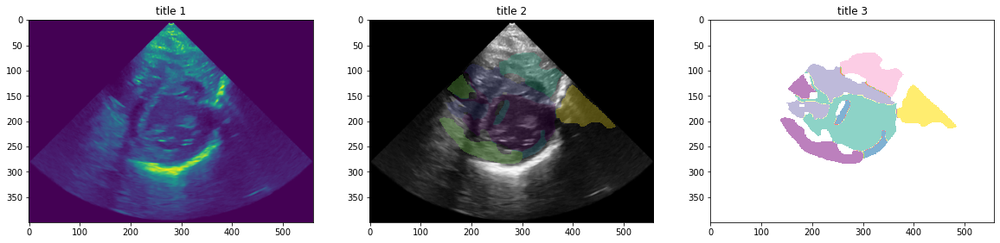

--> Frame 22:
	lv: cnt=8144, area_of_total=5.5%
	ivs: cnt=5024, area_of_total=3.4%
	la: cnt=474, area_of_total=0.3%
	rv: cnt=4516, area_of_total=3.1%
	pm: cnt=4168, area_of_total=2.8%
	aor: cnt=3715, area_of_total=2.5%
	 ==> combined:  cnt=26041, area_of_total=17.7%
	 ==> lv+rv:  cnt=26041, area_of_total=8.6%


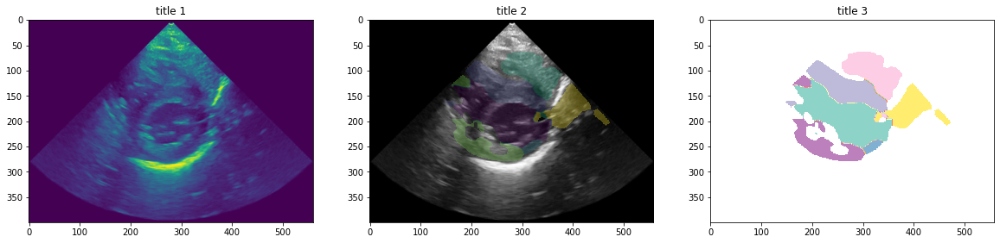

--> Frame 24:
	lv: cnt=4857, area_of_total=3.3%
	ivs: cnt=6255, area_of_total=4.2%
	la: cnt=2005, area_of_total=1.4%
	rv: cnt=3587, area_of_total=2.4%
	pm: cnt=3522, area_of_total=2.4%
	aor: cnt=3032, area_of_total=2.1%
	 ==> combined:  cnt=23258, area_of_total=15.8%
	 ==> lv+rv:  cnt=23258, area_of_total=5.7%


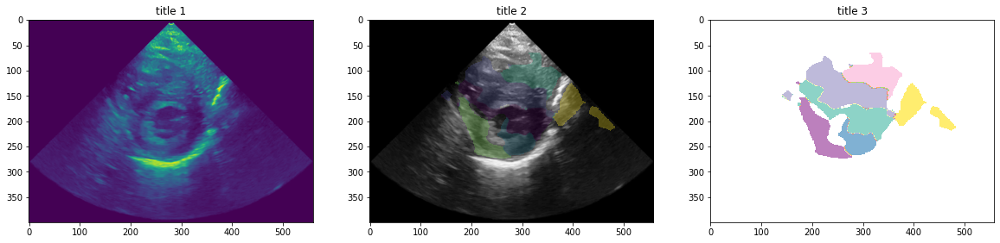

--> Frame 26:
	lv: cnt=4476, area_of_total=3.0%
	ivs: cnt=5026, area_of_total=3.4%
	la: cnt=1182, area_of_total=0.8%
	rv: cnt=3240, area_of_total=2.2%
	pm: cnt=4492, area_of_total=3.0%
	aor: cnt=3088, area_of_total=2.1%
	 ==> combined:  cnt=21504, area_of_total=14.6%
	 ==> lv+rv:  cnt=21504, area_of_total=5.2%


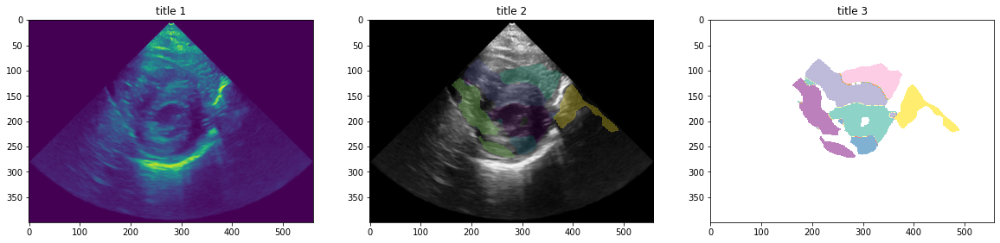

--> Frame 28:
	lv: cnt=4578, area_of_total=3.1%
	ivs: cnt=5302, area_of_total=3.6%
	la: cnt=4101, area_of_total=2.8%
	rv: cnt=4351, area_of_total=3.0%
	pm: cnt=2942, area_of_total=2.0%
	aor: cnt=3848, area_of_total=2.6%
	 ==> combined:  cnt=25122, area_of_total=17.0%
	 ==> lv+rv:  cnt=25122, area_of_total=6.1%


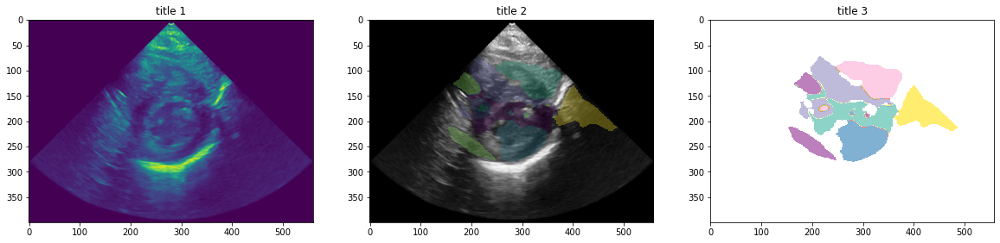

--> Frame 30:
	lv: cnt=5474, area_of_total=3.7%
	ivs: cnt=4482, area_of_total=3.0%
	la: cnt=4735, area_of_total=3.2%
	rv: cnt=3711, area_of_total=2.5%
	pm: cnt=2236, area_of_total=1.5%
	aor: cnt=2928, area_of_total=2.0%
	 ==> combined:  cnt=23566, area_of_total=16.0%
	 ==> lv+rv:  cnt=23566, area_of_total=6.2%


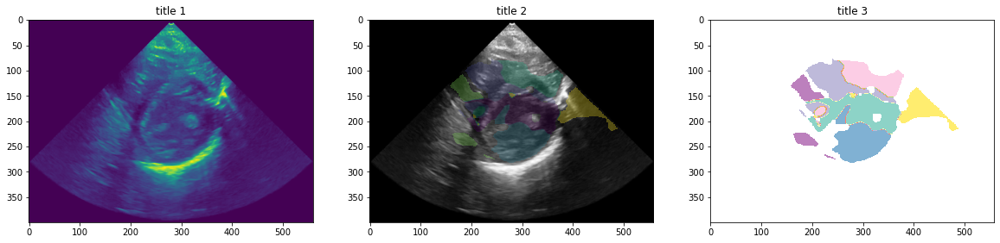

--> Frame 32:
	lv: cnt=6113, area_of_total=4.1%
	ivs: cnt=6253, area_of_total=4.2%
	la: cnt=2076, area_of_total=1.4%
	rv: cnt=3017, area_of_total=2.0%
	pm: cnt=3824, area_of_total=2.6%
	aor: cnt=3325, area_of_total=2.3%
	 ==> combined:  cnt=24608, area_of_total=16.7%
	 ==> lv+rv:  cnt=24608, area_of_total=6.2%


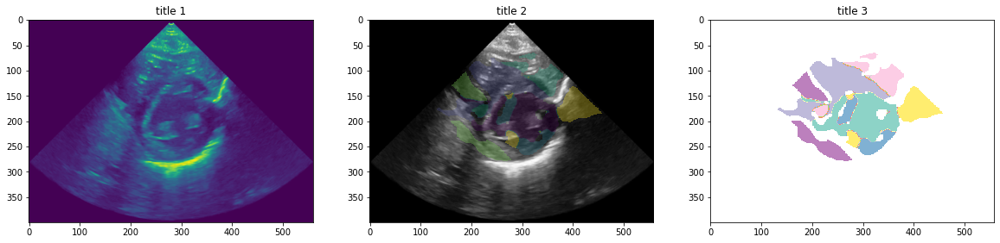

--> Frame 34:
	lv: cnt=3393, area_of_total=2.3%
	ivs: cnt=5897, area_of_total=4.0%
	la: cnt=1417, area_of_total=1.0%
	rv: cnt=2158, area_of_total=1.5%
	pm: cnt=1381, area_of_total=0.9%
	aor: cnt=4594, area_of_total=3.1%
	 ==> combined:  cnt=18840, area_of_total=12.8%
	 ==> lv+rv:  cnt=18840, area_of_total=3.8%


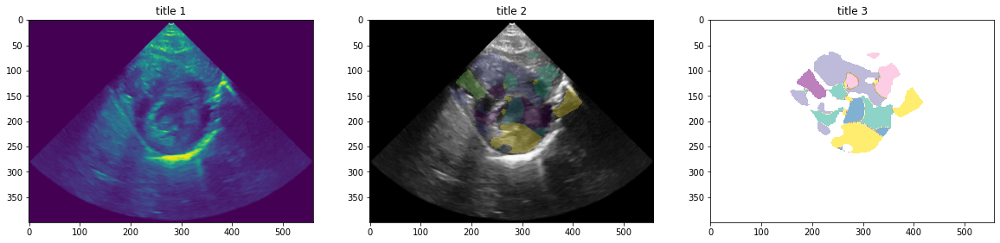

--> Frame 36:
	lv: cnt=1257, area_of_total=0.9%
	ivs: cnt=3759, area_of_total=2.5%
	la: cnt=960, area_of_total=0.7%
	rv: cnt=3922, area_of_total=2.7%
	pm: cnt=346, area_of_total=0.2%
	aor: cnt=6207, area_of_total=4.2%
	 ==> combined:  cnt=16451, area_of_total=11.2%
	 ==> lv+rv:  cnt=16451, area_of_total=3.5%


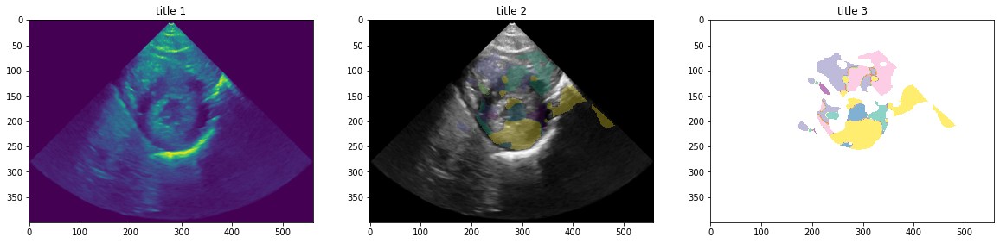

--> Frame 38:
	lv: cnt=1852, area_of_total=1.3%
	ivs: cnt=3511, area_of_total=2.4%
	la: cnt=373, area_of_total=0.3%
	rv: cnt=3680, area_of_total=2.5%
	pm: cnt=1388, area_of_total=0.9%
	aor: cnt=3971, area_of_total=2.7%
	 ==> combined:  cnt=14775, area_of_total=10.0%
	 ==> lv+rv:  cnt=14775, area_of_total=3.8%


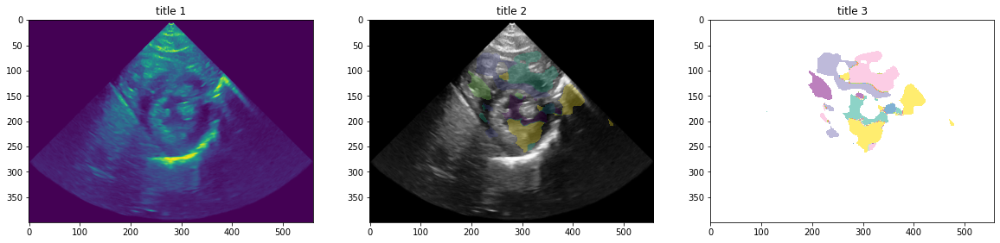

--> Frame 40:
	lv: cnt=817, area_of_total=0.6%
	ivs: cnt=5270, area_of_total=3.6%
	la: cnt=0, area_of_total=0.0%
	rv: cnt=4746, area_of_total=3.2%
	pm: cnt=2443, area_of_total=1.7%
	aor: cnt=6873, area_of_total=4.7%
	 ==> combined:  cnt=20149, area_of_total=13.7%
	 ==> lv+rv:  cnt=20149, area_of_total=3.8%


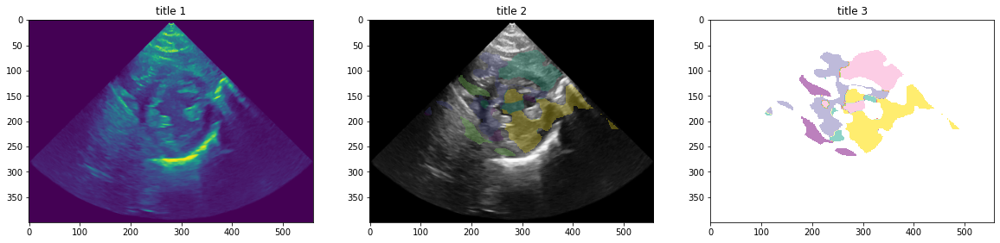

--> Frame 42:
	lv: cnt=4176, area_of_total=2.8%
	ivs: cnt=5432, area_of_total=3.7%
	la: cnt=27, area_of_total=0.0%
	rv: cnt=2846, area_of_total=1.9%
	pm: cnt=4019, area_of_total=2.7%
	aor: cnt=5226, area_of_total=3.5%
	 ==> combined:  cnt=21726, area_of_total=14.7%
	 ==> lv+rv:  cnt=21726, area_of_total=4.8%


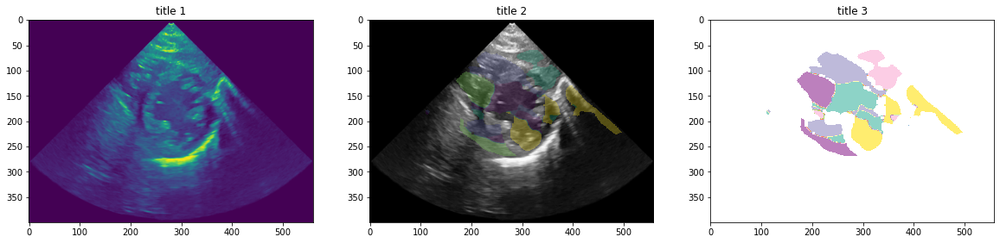

--> Frame 44:
	lv: cnt=5048, area_of_total=3.4%
	ivs: cnt=4576, area_of_total=3.1%
	la: cnt=914, area_of_total=0.6%
	rv: cnt=2923, area_of_total=2.0%
	pm: cnt=3686, area_of_total=2.5%
	aor: cnt=4952, area_of_total=3.4%
	 ==> combined:  cnt=22099, area_of_total=15.0%
	 ==> lv+rv:  cnt=22099, area_of_total=5.4%


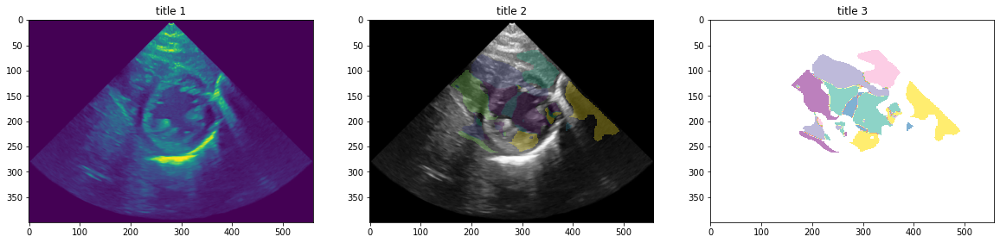

--> Frame 46:
	lv: cnt=4194, area_of_total=2.8%
	ivs: cnt=5309, area_of_total=3.6%
	la: cnt=1106, area_of_total=0.8%
	rv: cnt=2076, area_of_total=1.4%
	pm: cnt=1999, area_of_total=1.4%
	aor: cnt=4857, area_of_total=3.3%
	 ==> combined:  cnt=19541, area_of_total=13.3%
	 ==> lv+rv:  cnt=19541, area_of_total=4.3%


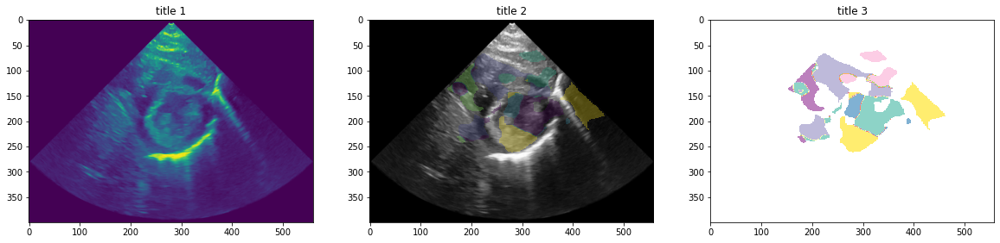

--> Frame 48:
	lv: cnt=1567, area_of_total=1.1%
	ivs: cnt=5852, area_of_total=4.0%
	la: cnt=290, area_of_total=0.2%
	rv: cnt=2622, area_of_total=1.8%
	pm: cnt=751, area_of_total=0.5%
	aor: cnt=5954, area_of_total=4.0%
	 ==> combined:  cnt=17036, area_of_total=11.6%
	 ==> lv+rv:  cnt=17036, area_of_total=2.8%


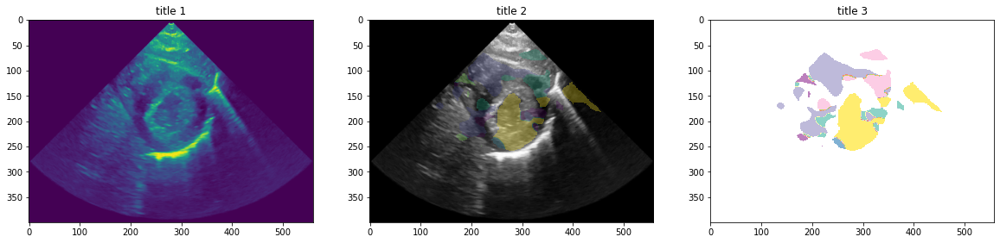

In [10]:
# HEALTHY - 101 KAPAP ==> Try the KAAP view instead (!) => And by predicting with model 'plax' view (inst. of 'psax' view)
video, segm_mask, labels = get_data(videos_dir, '101KAAP', view='plax')
visualise_plax(video, segm_mask, labels)

# TRY AP4C View

{'lv': 2, 'rv': 3, 'la': 4, 'ra': 5, 'lv-o': 1}
--> Frame 0:


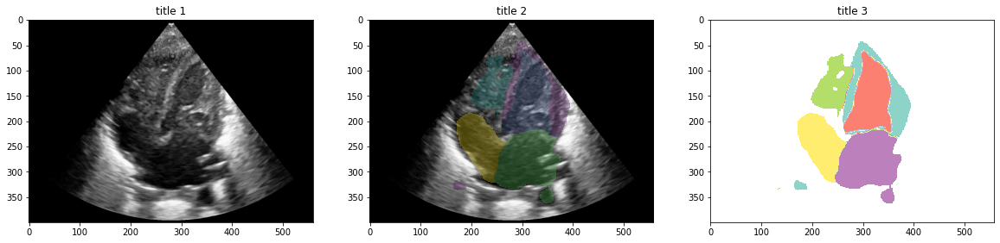

--> Frame 2:


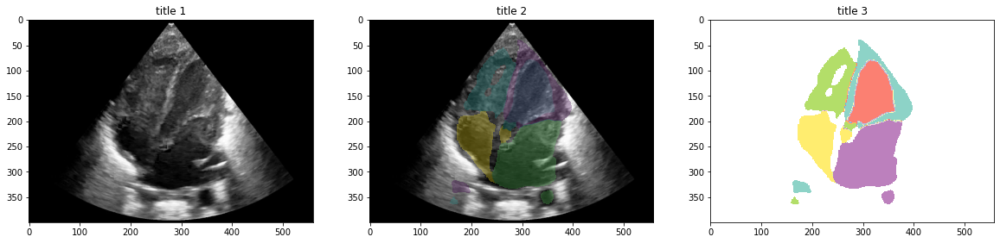

--> Frame 4:


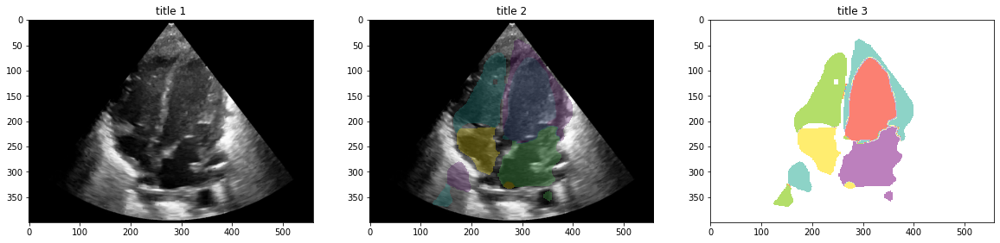

--> Frame 6:


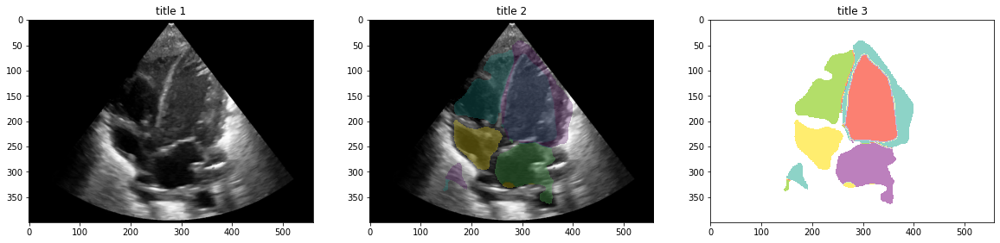

--> Frame 8:


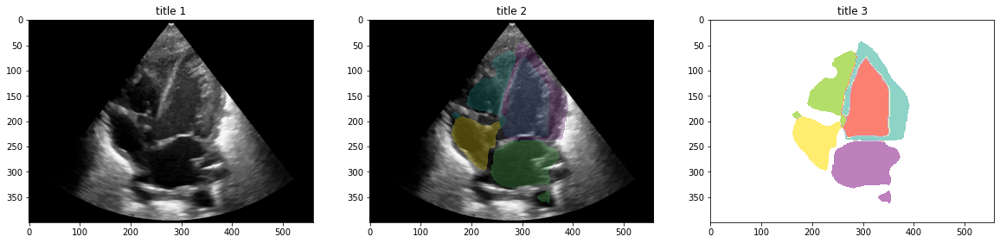

--> Frame 10:


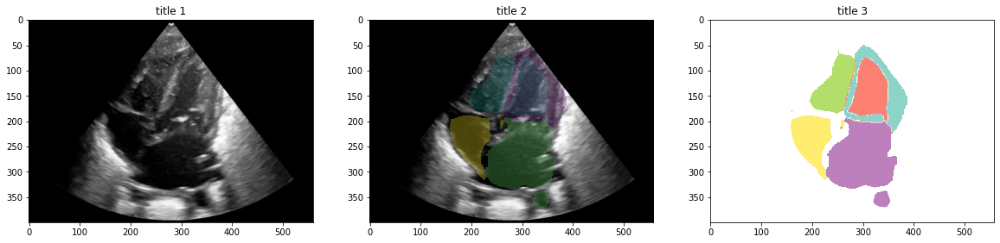

--> Frame 12:


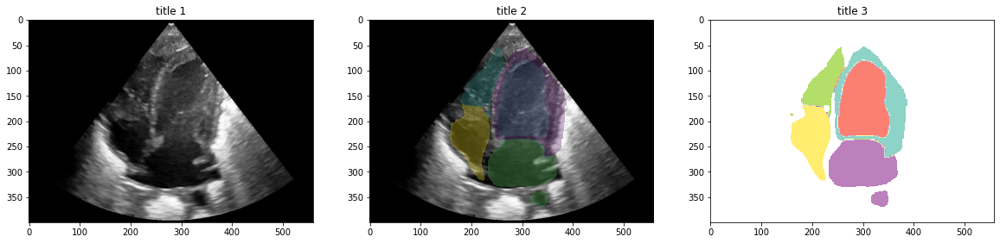

--> Frame 14:


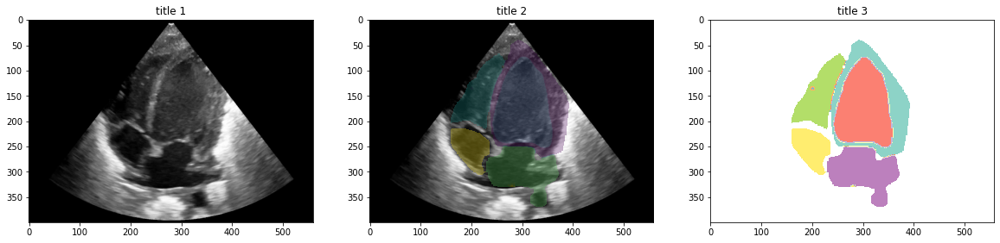

--> Frame 16:


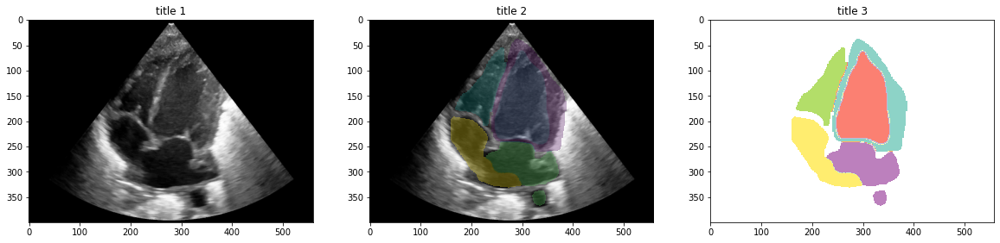

--> Frame 18:


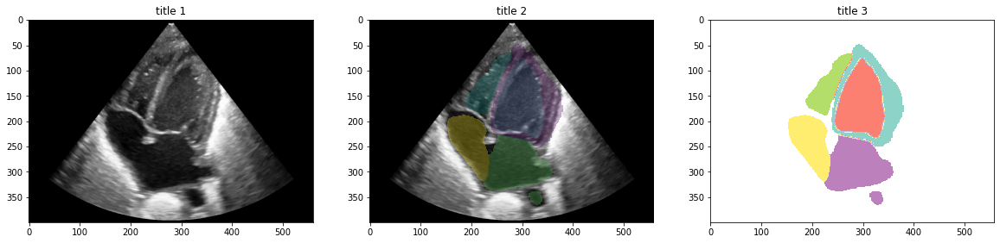

--> Frame 20:


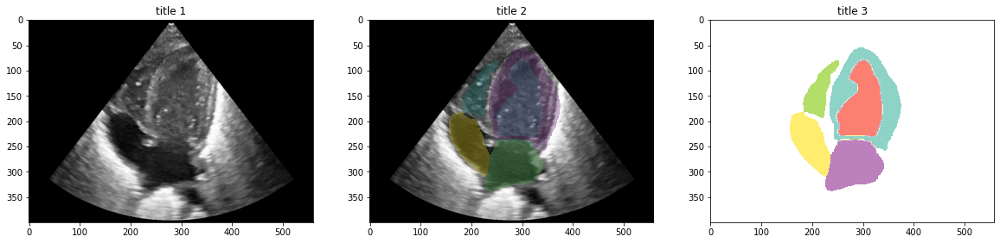

--> Frame 22:


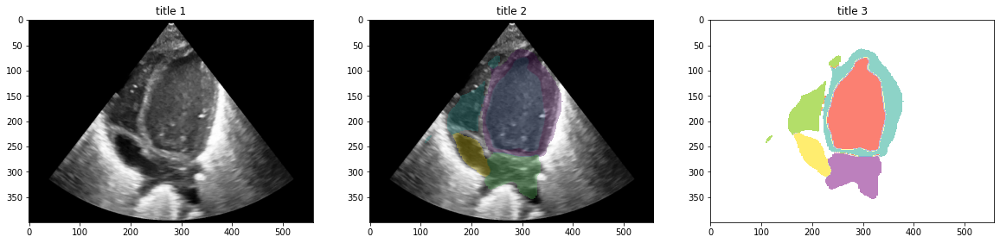

--> Frame 24:


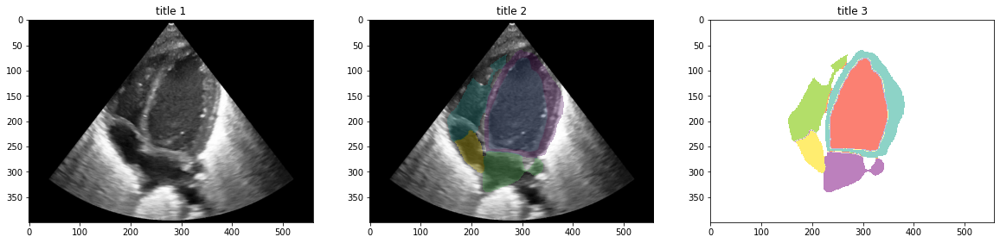

--> Frame 26:


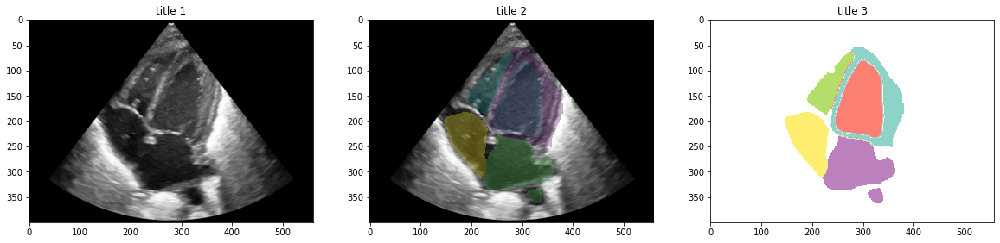

--> Frame 28:


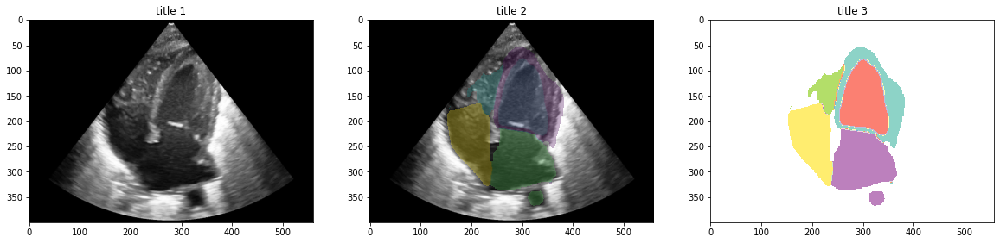

--> Frame 30:


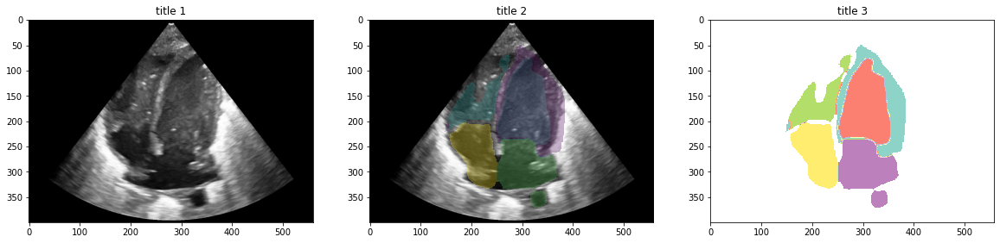

--> Frame 32:


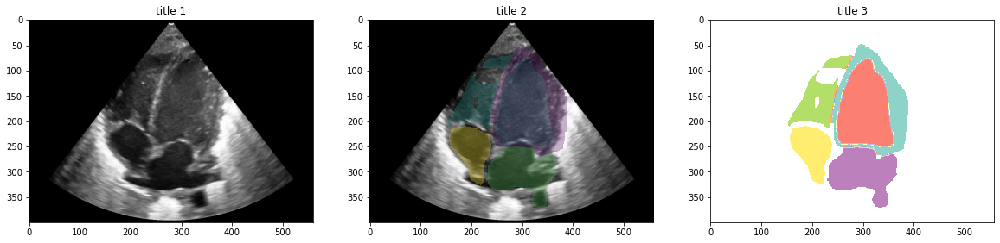

--> Frame 34:


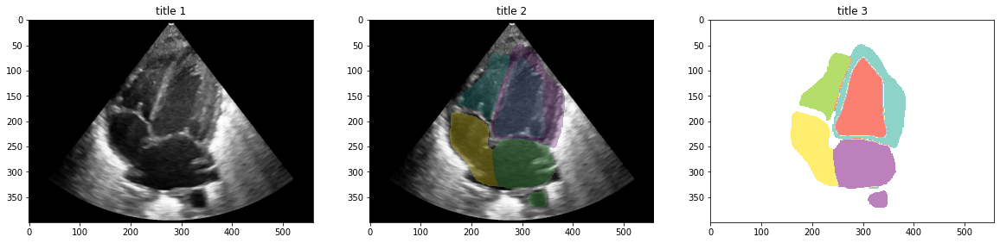

--> Frame 36:


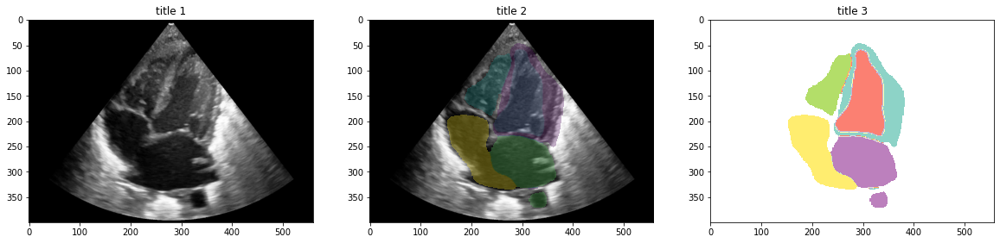

--> Frame 38:


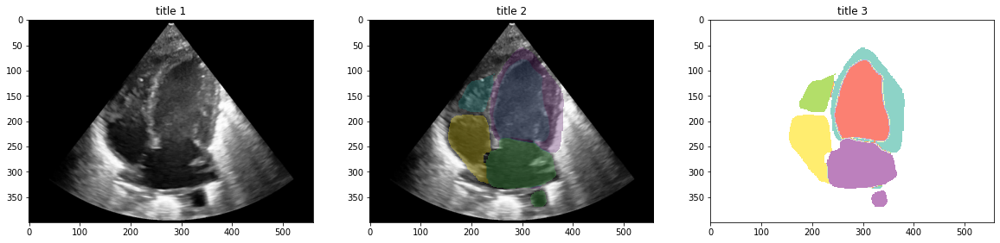

--> Frame 40:


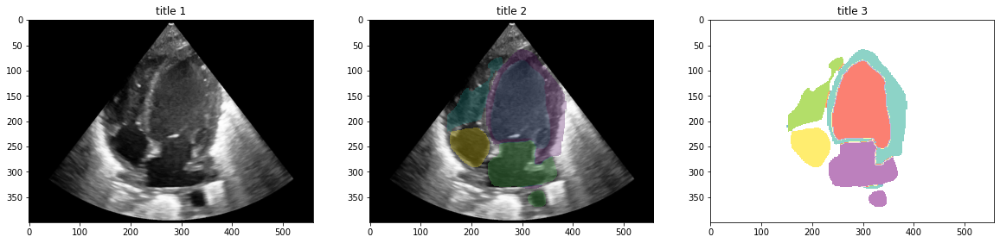

--> Frame 42:


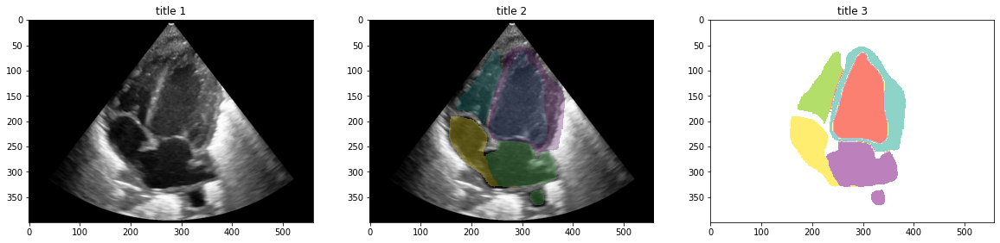

--> Frame 44:


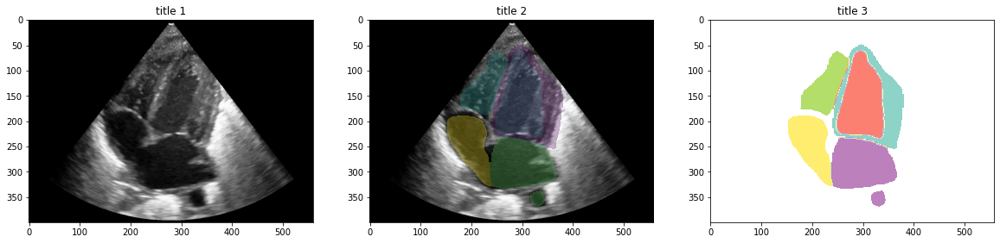

--> Frame 46:


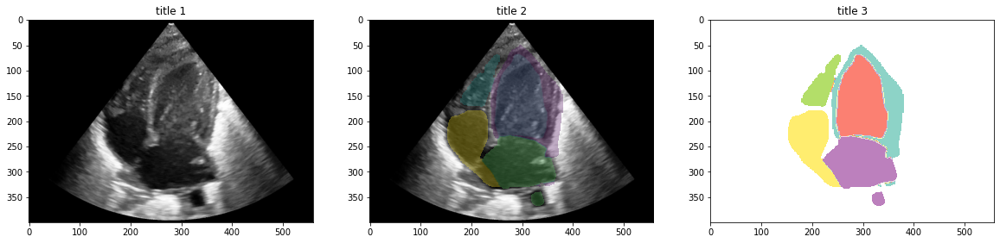

--> Frame 48:


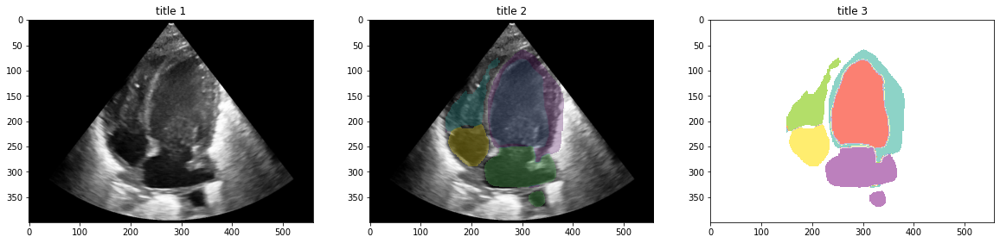

In [12]:
# AP4C view for 96
video, segm_mask, labels = get_data(videos_dir, '96CV', view='a4c')
visualise_a4c(video, segm_mask, labels)

In [7]:
videos_dir = '/Users/hragnarsd/Documents/masters/seg_res_cluster'
segm_label_dir = '/Users/hragnarsd/Documents/masters/seg_res_cluster'
video, segm_mask, labels = get_data(videos_dir, '104KAPAP')
visualise(video, segm_mask, labels)

FileNotFoundError: [Errno 2] No such file or directory: '../segmented_results/104KAPAP/psax/104KAPAP-segmentation_label.json'